In [1]:
from IPython.display import display, Markdown

display(Markdown(
    "Note: This notebook and its outputs are produced in compliance with the learning objectives of "
    "**Math 222 — Linear Algebra: Spectral Clustering**. " 
    "Analyses (graph construction, Laplacians, spectral embeddings, and clustering) follow standard spectral clustering methodology."
)) 

display(Markdown("**Authors:** <Daniel T. Cabugao, John Isaac Jubilo, Arju Emamanuel Alcantara>"))


Note: This notebook and its outputs are produced in compliance with the learning objectives of **Math 222 — Linear Algebra: Spectral Clustering**. Analyses (graph construction, Laplacians, spectral embeddings, and clustering) follow standard spectral clustering methodology.

**Authors:** <Daniel T. Cabugao, John Isaac Jubilo, Arju Emamanuel Alcantara>

## Dataset Importation

In [2]:
file_path = r"C:\Users\LENOVO\Desktop\Spectral_Clustering\data\patient_dataset.csv"

## Data Preparation

In [3]:
import numpy as np
from core.data_preparation import DataPreparer  
 
dp = DataPreparer(
    mode='user_data',
    user_file_type='matrix',
    user_path=file_path
)
data_dict = dp.prepare()
X_raw = data_dict['matrix']

if not all(isinstance(x, (int, float, np.number)) for x in X_raw[0]):
    columns = list(X_raw[0])
    X_numeric = X_raw[1:, :]
else:
    n_cols = X_raw.shape[1]
    columns = [f"col_{i}" for i in range(n_cols)]
    X_numeric = X_raw

data = np.array(X_numeric, dtype=float)
data[np.isnan(data)] = 0

data_for_gg = {"matrix": data}

## Graph Generation


=== Running grid item: cosine__knn_k2 ===

=== Running grid item: cosine__knn_k4 ===

=== Running grid item: cosine__knn_k6 ===

=== Running grid item: cosine__threshold_t0.2 ===

=== Running grid item: cosine__threshold_t0.4 ===

=== Running grid item: cosine__threshold_t0.6 ===

=== Running grid item: correlation__knn_k2 ===

=== Running grid item: correlation__knn_k4 ===

=== Running grid item: correlation__knn_k6 ===

=== Running grid item: correlation__threshold_t0.2 ===

=== Running grid item: correlation__threshold_t0.4 ===

=== Running grid item: correlation__threshold_t0.6 ===

=== Running grid item: jaccard_binary__knn_k2 ===

=== Running grid item: jaccard_binary__knn_k4 ===

=== Running grid item: jaccard_binary__knn_k6 ===

=== Running grid item: jaccard_binary__threshold_t0.2 ===

=== Running grid item: jaccard_binary__threshold_t0.4 ===

=== Running grid item: jaccard_binary__threshold_t0.6 ===


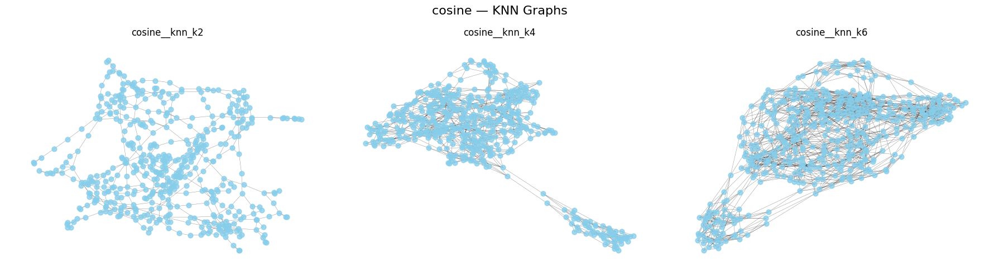

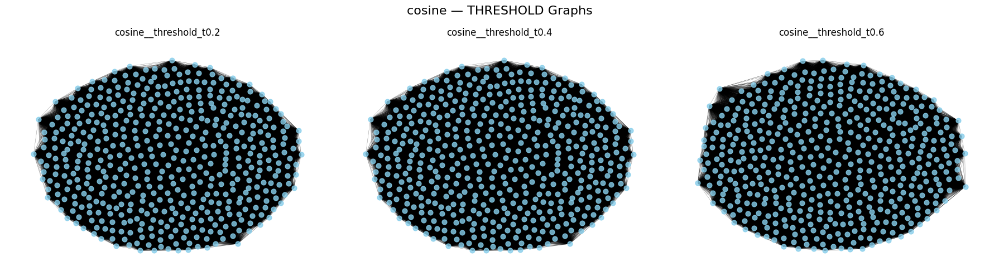

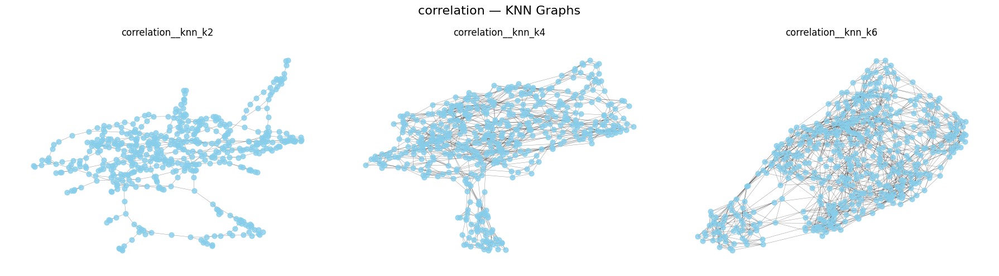

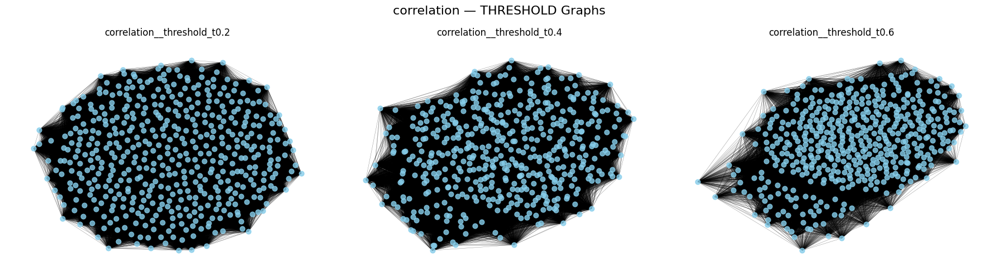

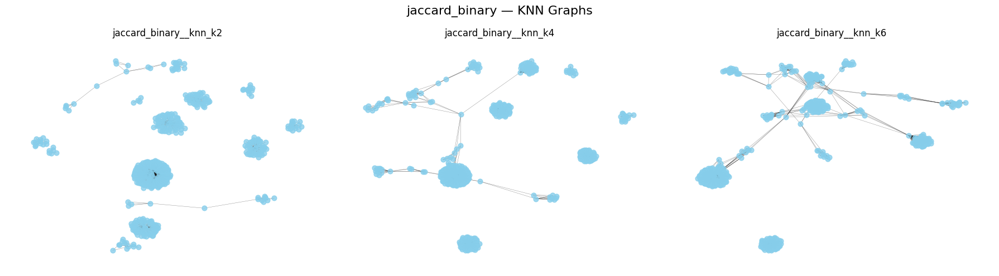

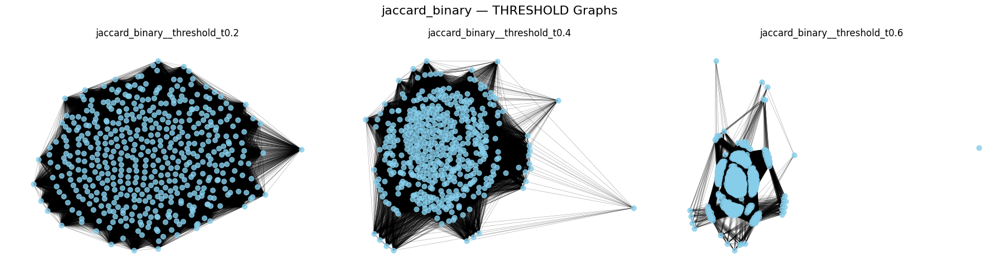

In [4]:
from core.graph_generation import GraphGenerator
import numpy as np

gg = GraphGenerator(
    sim_metric='cosine',
    graph_method='knn',
    show_info=False,
    show_plot=False,
    show_heatmap=False
)

results, summary_df = gg.run_grid_search(
    data_for_gg,
    similarity_metrics=['cosine', 'correlation', 'jaccard_binary'],
    methods=['knn', 'threshold'],
    k_values=[2, 4, 6],
    threshold_values=[0.2, 0.4, 0.6],
    show_subplots=True,
    return_dataframe=True
)

### Summary DataFrame

In [5]:
import pandas as pd

pd.set_option('display.max_rows', None)
display(summary_df)

label  \
sim_metric     method    params_str                                   
cosine         knn       {"k": 2}                    cosine__knn_k2   
                         {"k": 4}                    cosine__knn_k4   
                         {"k": 6}                    cosine__knn_k6   
               threshold {"t": 0.2}          cosine__threshold_t0.2   
                         {"t": 0.4}          cosine__threshold_t0.4   
                         {"t": 0.6}          cosine__threshold_t0.6   
correlation    knn       {"k": 2}               correlation__knn_k2   
                         {"k": 4}               correlation__knn_k4   
                         {"k": 6}               correlation__knn_k6   
               threshold {"t": 0.2}     correlation__threshold_t0.2   
                         {"t": 0.4}     correlation__threshold_t0.4   
                         {"t": 0.6}     correlation__threshold_t0.6   
jaccard_binary knn       {"k": 2}            jaccard_binary__knn_k2   
                         {"k": 4}            jaccard_binary__knn_k4   
                         {"k": 6}            jaccard_binary__knn_k6   
               threshold {"t": 0.2}  jaccard_binary__threshold_t0.2   
                         {"t": 0.4}  jaccard_binary__threshold_t0.4   
                         {"t": 0.6}  jaccard_binary__threshold_t0.6   

                                         params  nodes   edges  \
sim_metric     method    params_str                              
cosine         knn       {"k": 2}      {'k': 2}    500     699   
                         {"k": 4}      {'k': 4}    500    1365   
                         {"k": 6}      {'k': 6}    500    2023   
               threshold {"t": 0.2}  {'t': 0.2}    500  124750   
                         {"t": 0.4}  {'t': 0.4}    500  124750   
                         {"t": 0.6}  {'t': 0.6}    500  124503   
correlation    knn       {"k": 2}      {'k': 2}    500     704   
                         {"k": 4}      {'k': 4}    500    1369   
                         {"k": 6}      {'k': 6}    500    2015   
               threshold {"t": 0.2}  {'t': 0.2}    500  123904   
                         {"t": 0.4}  {'t': 0.4}    500  118887   
                         {"t": 0.6}  {'t': 0.6}    500  101563   
jaccard_binary knn       {"k": 2}      {'k': 2}    500     950   
                         {"k": 4}      {'k': 4}    500    1852   
                         {"k": 6}      {'k': 6}    500    2729   
               threshold {"t": 0.2}  {'t': 0.2}    500  122976   
                         {"t": 0.4}  {'t': 0.4}    500  109528   
                         {"t": 0.6}  {'t': 0.6}    500   72580   

                                     number_connected_components  \
sim_metric     method    params_str                                
cosine         knn       {"k": 2}                              4   
                         {"k": 4}                              1   
                         {"k": 6}                              1   
               threshold {"t": 0.2}                            1   
                         {"t": 0.4}                            1   
                         {"t": 0.6}                            1   
correlation    knn       {"k": 2}                              2   
                         {"k": 4}                              1   
                         {"k": 6}                              1   
               threshold {"t": 0.2}                            1   
                         {"t": 0.4}                            1   
                         {"t": 0.6}                            1   
jaccard_binary knn       {"k": 2}                             14   
                         {"k": 4}                              7   
                         {"k": 6}                              3   
               threshold {"t": 0.2}                            1   
                         {"t": 0.4}                            1   
                         {"t

## Laplacian Generation


[cosine__knn_k2] Shapes: D:(500, 500), L:(500, 500), L_sym:(500, 500), L_rw:(500, 500)
[cosine__knn_k2] min eigen(L): -1.1904148891299583e-15


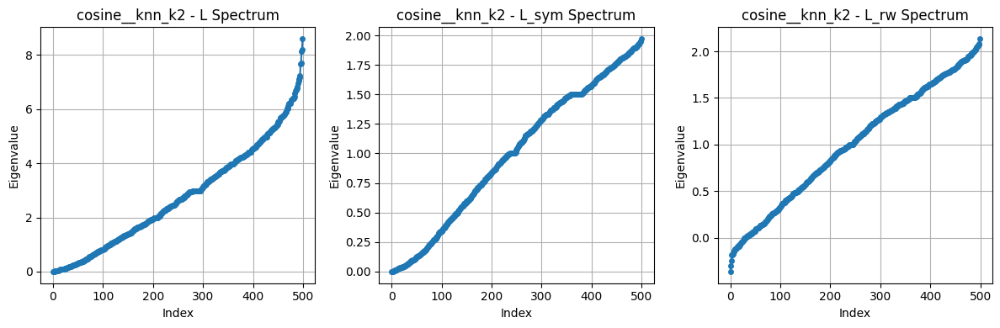

[INFO] Saved Laplacian outputs to C:\Users\LENOVO\Desktop\Spectral_Clustering\outputs\laplacians\laplacian_run_cosine__knn_k2

[cosine__knn_k4] Shapes: D:(500, 500), L:(500, 500), L_sym:(500, 500), L_rw:(500, 500)
[cosine__knn_k4] min eigen(L): 9.36494222018978e-17


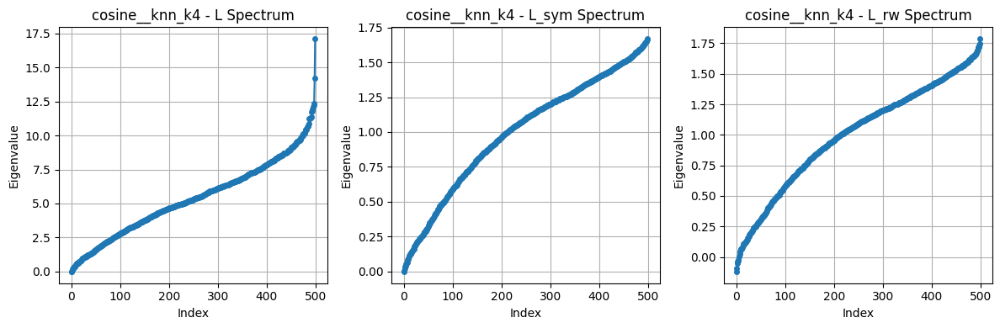

[INFO] Saved Laplacian outputs to C:\Users\LENOVO\Desktop\Spectral_Clustering\outputs\laplacians\laplacian_run_cosine__knn_k4

[cosine__knn_k6] Shapes: D:(500, 500), L:(500, 500), L_sym:(500, 500), L_rw:(500, 500)
[cosine__knn_k6] min eigen(L): -4.057074368176363e-15


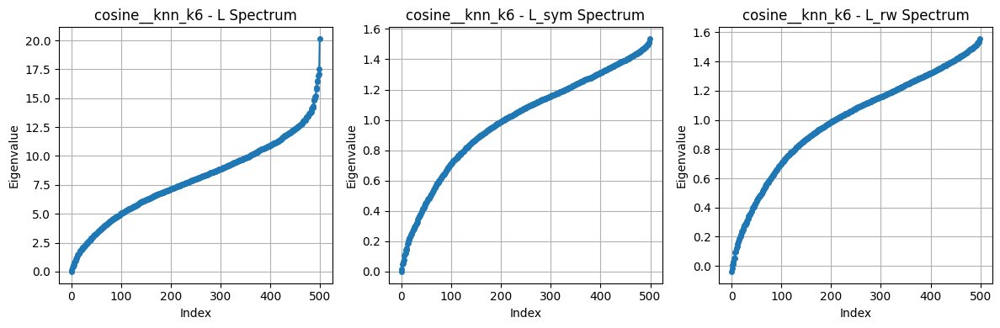

[INFO] Saved Laplacian outputs to C:\Users\LENOVO\Desktop\Spectral_Clustering\outputs\laplacians\laplacian_run_cosine__knn_k6

[cosine__threshold_t0.2] Shapes: D:(500, 500), L:(500, 500), L_sym:(500, 500), L_rw:(500, 500)
[cosine__threshold_t0.2] min eigen(L): 7.688561336890747e-14


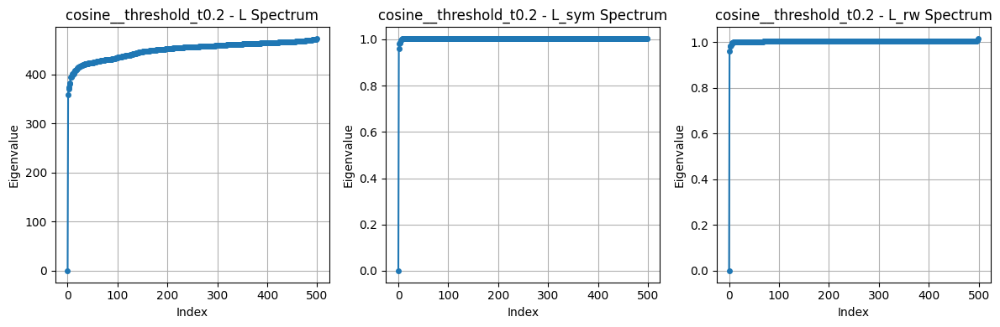

[INFO] Saved Laplacian outputs to C:\Users\LENOVO\Desktop\Spectral_Clustering\outputs\laplacians\laplacian_run_cosine__threshold_t0.2

[cosine__threshold_t0.4] Shapes: D:(500, 500), L:(500, 500), L_sym:(500, 500), L_rw:(500, 500)
[cosine__threshold_t0.4] min eigen(L): 7.688561336890747e-14


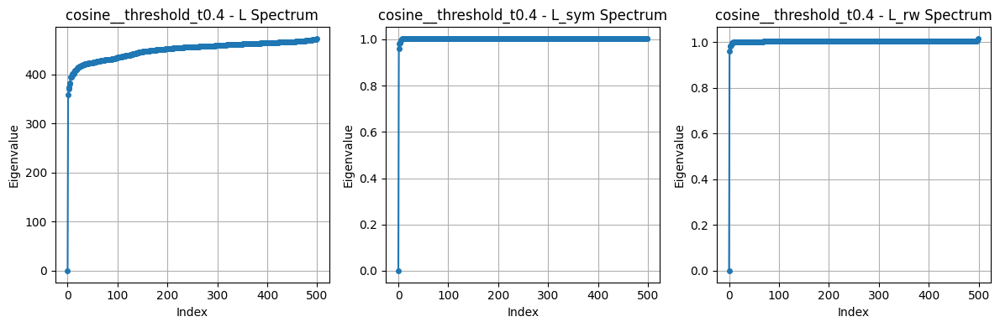

[INFO] Saved Laplacian outputs to C:\Users\LENOVO\Desktop\Spectral_Clustering\outputs\laplacians\laplacian_run_cosine__threshold_t0.4

[cosine__threshold_t0.6] Shapes: D:(500, 500), L:(500, 500), L_sym:(500, 500), L_rw:(500, 500)
[cosine__threshold_t0.6] min eigen(L): 4.686497912115125e-14


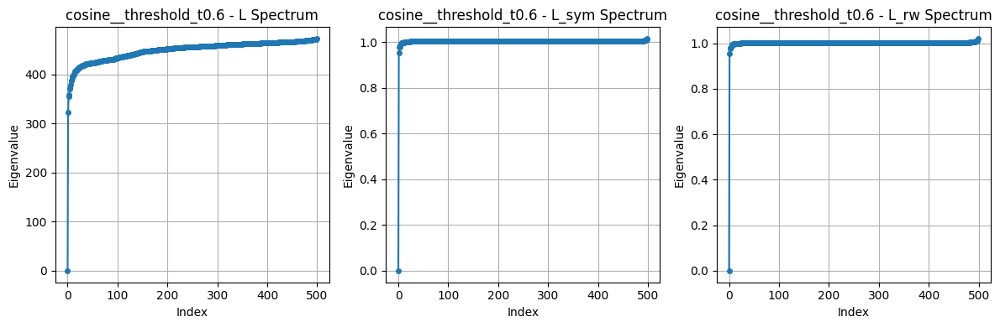

[INFO] Saved Laplacian outputs to C:\Users\LENOVO\Desktop\Spectral_Clustering\outputs\laplacians\laplacian_run_cosine__threshold_t0.6

[correlation__knn_k2] Shapes: D:(500, 500), L:(500, 500), L_sym:(500, 500), L_rw:(500, 500)
[correlation__knn_k2] min eigen(L): 1.2746291988692275e-16


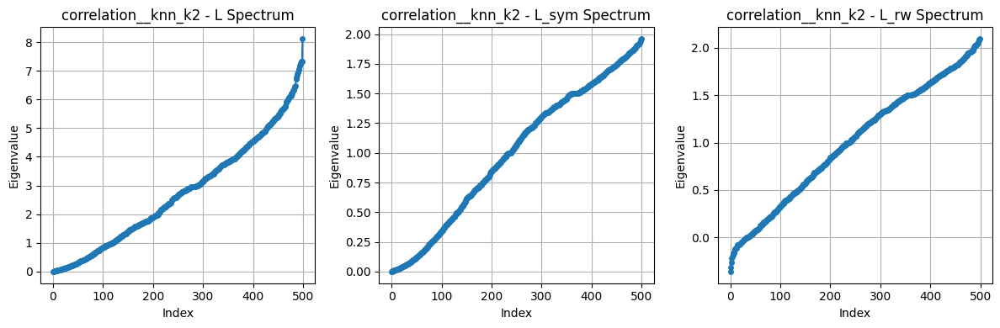

[INFO] Saved Laplacian outputs to C:\Users\LENOVO\Desktop\Spectral_Clustering\outputs\laplacians\laplacian_run_correlation__knn_k2

[correlation__knn_k4] Shapes: D:(500, 500), L:(500, 500), L_sym:(500, 500), L_rw:(500, 500)
[correlation__knn_k4] min eigen(L): -3.1784332252317693e-16


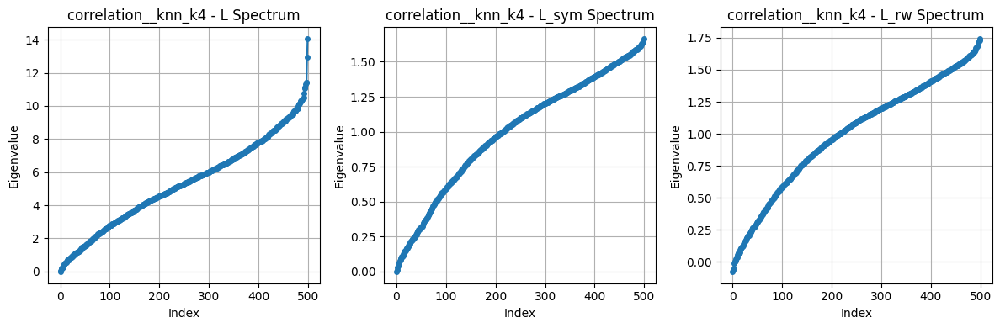

[INFO] Saved Laplacian outputs to C:\Users\LENOVO\Desktop\Spectral_Clustering\outputs\laplacians\laplacian_run_correlation__knn_k4

[correlation__knn_k6] Shapes: D:(500, 500), L:(500, 500), L_sym:(500, 500), L_rw:(500, 500)
[correlation__knn_k6] min eigen(L): 3.435127762333151e-15


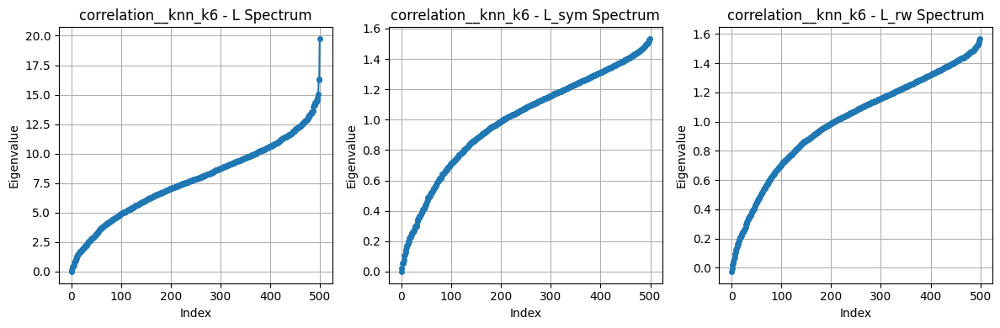

[INFO] Saved Laplacian outputs to C:\Users\LENOVO\Desktop\Spectral_Clustering\outputs\laplacians\laplacian_run_correlation__knn_k6

[correlation__threshold_t0.2] Shapes: D:(500, 500), L:(500, 500), L_sym:(500, 500), L_rw:(500, 500)
[correlation__threshold_t0.2] min eigen(L): -1.0406228251343533e-13


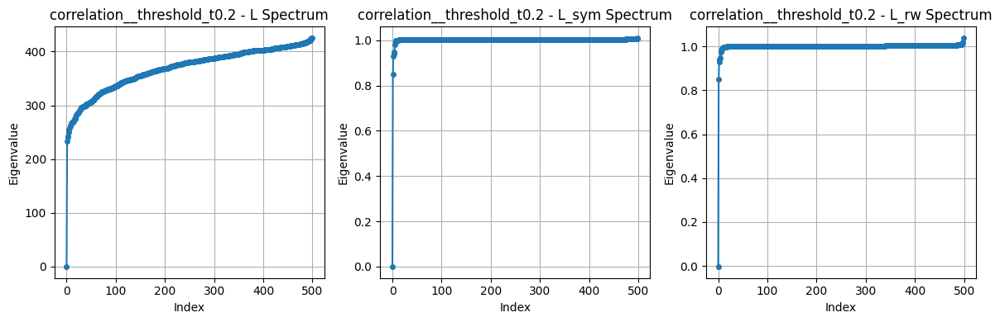

[INFO] Saved Laplacian outputs to C:\Users\LENOVO\Desktop\Spectral_Clustering\outputs\laplacians\laplacian_run_correlation__threshold_t0.2

[correlation__threshold_t0.4] Shapes: D:(500, 500), L:(500, 500), L_sym:(500, 500), L_rw:(500, 500)
[correlation__threshold_t0.4] min eigen(L): 4.780292273054191e-14


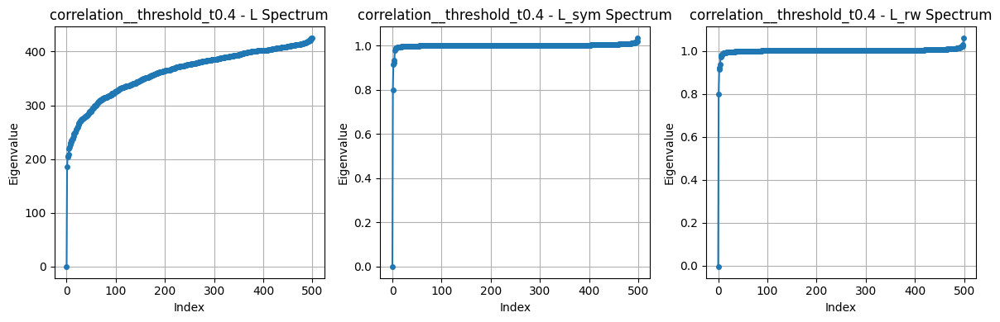

[INFO] Saved Laplacian outputs to C:\Users\LENOVO\Desktop\Spectral_Clustering\outputs\laplacians\laplacian_run_correlation__threshold_t0.4

[correlation__threshold_t0.6] Shapes: D:(500, 500), L:(500, 500), L_sym:(500, 500), L_rw:(500, 500)
[correlation__threshold_t0.6] min eigen(L): 1.692791869491145e-13


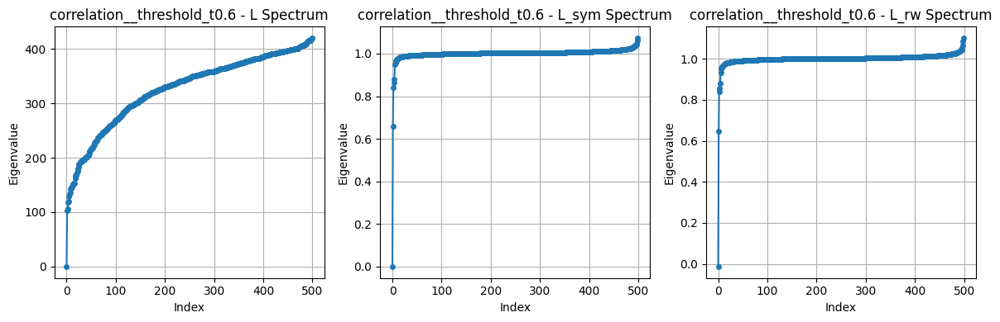

[INFO] Saved Laplacian outputs to C:\Users\LENOVO\Desktop\Spectral_Clustering\outputs\laplacians\laplacian_run_correlation__threshold_t0.6

[jaccard_binary__knn_k2] Shapes: D:(500, 500), L:(500, 500), L_sym:(500, 500), L_rw:(500, 500)
[jaccard_binary__knn_k2] min eigen(L): -4.5312493807561614e-14


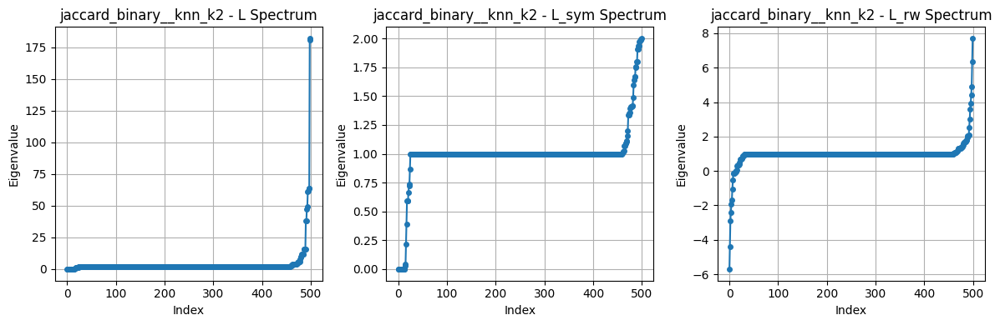

[INFO] Saved Laplacian outputs to C:\Users\LENOVO\Desktop\Spectral_Clustering\outputs\laplacians\laplacian_run_jaccard_binary__knn_k2

[jaccard_binary__knn_k4] Shapes: D:(500, 500), L:(500, 500), L_sym:(500, 500), L_rw:(500, 500)
[jaccard_binary__knn_k4] min eigen(L): -2.4991762483577e-15


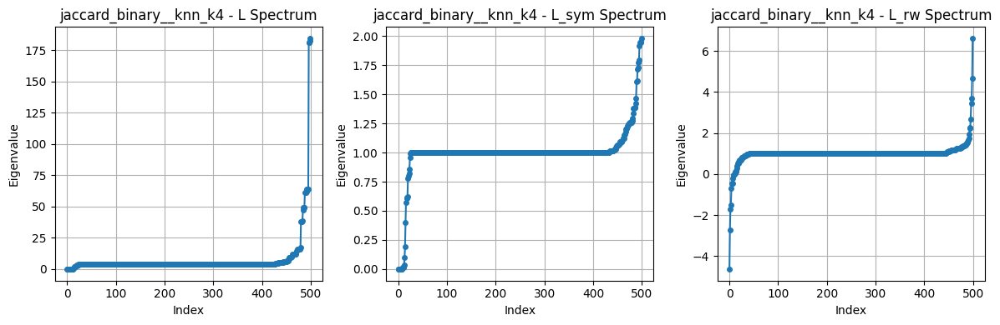

[INFO] Saved Laplacian outputs to C:\Users\LENOVO\Desktop\Spectral_Clustering\outputs\laplacians\laplacian_run_jaccard_binary__knn_k4

[jaccard_binary__knn_k6] Shapes: D:(500, 500), L:(500, 500), L_sym:(500, 500), L_rw:(500, 500)
[jaccard_binary__knn_k6] min eigen(L): -1.8133147520104573e-14


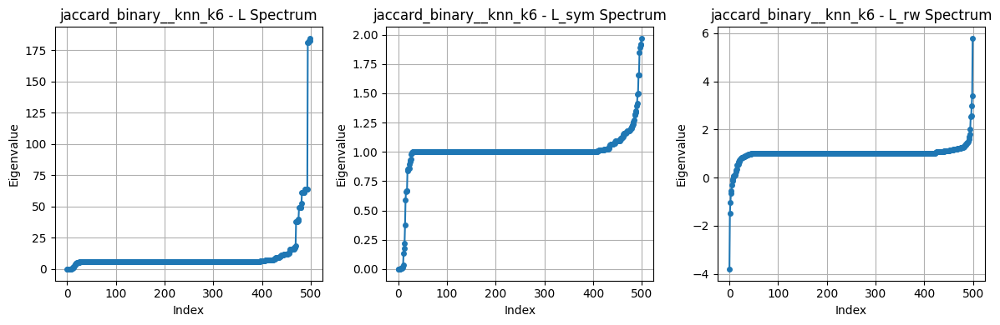

[INFO] Saved Laplacian outputs to C:\Users\LENOVO\Desktop\Spectral_Clustering\outputs\laplacians\laplacian_run_jaccard_binary__knn_k6

[jaccard_binary__threshold_t0.2] Shapes: D:(500, 500), L:(500, 500), L_sym:(500, 500), L_rw:(500, 500)
[jaccard_binary__threshold_t0.2] min eigen(L): 4.970202333947012e-13


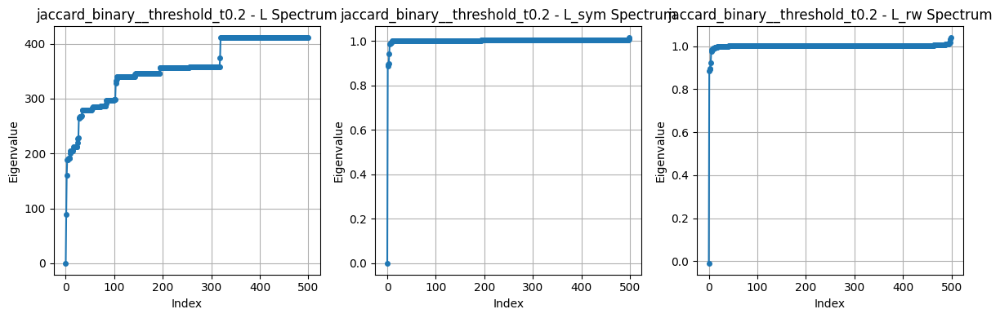

[INFO] Saved Laplacian outputs to C:\Users\LENOVO\Desktop\Spectral_Clustering\outputs\laplacians\laplacian_run_jaccard_binary__threshold_t0.2

[jaccard_binary__threshold_t0.4] Shapes: D:(500, 500), L:(500, 500), L_sym:(500, 500), L_rw:(500, 500)
[jaccard_binary__threshold_t0.4] min eigen(L): 2.2196886094893244e-14


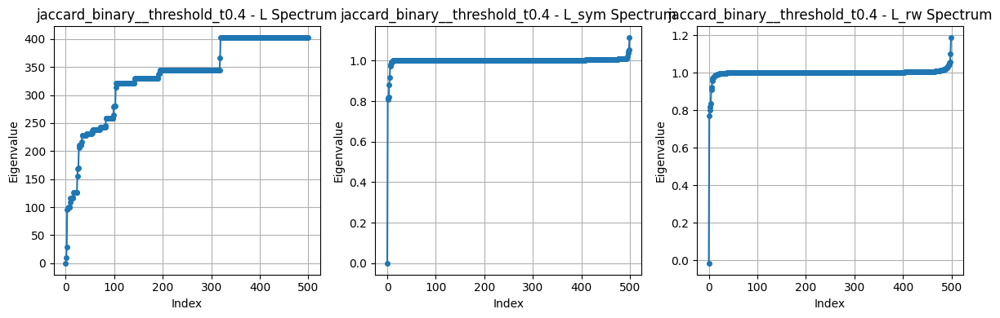

[INFO] Saved Laplacian outputs to C:\Users\LENOVO\Desktop\Spectral_Clustering\outputs\laplacians\laplacian_run_jaccard_binary__threshold_t0.4

[jaccard_binary__threshold_t0.6] Shapes: D:(500, 500), L:(500, 500), L_sym:(500, 500), L_rw:(500, 500)
[jaccard_binary__threshold_t0.6] min eigen(L): -1.1565434536632043e-13


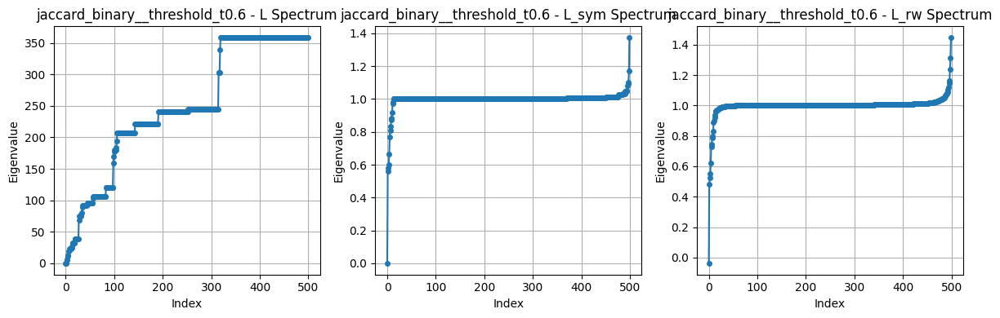

[INFO] Saved Laplacian outputs to C:\Users\LENOVO\Desktop\Spectral_Clustering\outputs\laplacians\laplacian_run_jaccard_binary__threshold_t0.6


In [6]:
from core.laplacian import GraphLaplacianGenerator

glg = GraphLaplacianGenerator(
    sim_metric='cosine',
    show_info=True,
    show_plots=True
)

lap_outputs = glg.generate_for_all_graphs(results)

In [7]:
import numpy as np

def laplacian_spectral_stats(M, tol=1e-8, k=1):
    """
    Spectral quantities for a Laplacian matrix M.
    """
    w = np.linalg.eigvalsh(M)   # sorted eigenvalues
    w = np.real(w)

    nonzero = w[w > tol]

    stats = {
        "eigenvalues": w,
        "min_nonzero": nonzero[0] if len(nonzero) > 0 else 0.0,
        "max_nonzero": nonzero[-1] if len(nonzero) > 0 else 0.0,
        "algebraic_connectivity": nonzero[0] if len(nonzero) > 0 else 0.0,
        "spectral_gap_k": (w[k] - w[k-1]) if len(w) > k else 0.0
    }
    return stats


In [8]:
for label, mats in lap_outputs.items():
    L     = mats["L"]
    L_sym = mats["L_sym"]
    L_rw  = mats["L_rw"]

    stats_L = laplacian_spectral_stats(L, k=1)

    print(f"\n[{label}]")
    print(f"Algebraic connectivity λ₂(L): {stats_L['algebraic_connectivity']:.6f}")
    print(f"Min nonzero eigenvalue:     {stats_L['min_nonzero']:.6f}")
    print(f"Max nonzero eigenvalue:     {stats_L['max_nonzero']:.6f}")
    print(f"Spectral gap (λ₂−λ₁):       {stats_L['spectral_gap_k']:.6f}")


[cosine__knn_k2]
Algebraic connectivity λ₂(L): 0.015686
Min nonzero eigenvalue:     0.015686
Max nonzero eigenvalue:     8.599145
Spectral gap (λ₂−λ₁):       0.000000

[cosine__knn_k4]
Algebraic connectivity λ₂(L): 0.018348
Min nonzero eigenvalue:     0.018348
Max nonzero eigenvalue:     17.099973
Spectral gap (λ₂−λ₁):       0.018348

[cosine__knn_k6]
Algebraic connectivity λ₂(L): 0.132512
Min nonzero eigenvalue:     0.132512
Max nonzero eigenvalue:     20.134332
Spectral gap (λ₂−λ₁):       0.132512

[cosine__threshold_t0.2]
Algebraic connectivity λ₂(L): 357.821844
Min nonzero eigenvalue:     357.821844
Max nonzero eigenvalue:     472.643050
Spectral gap (λ₂−λ₁):       357.821844

[cosine__threshold_t0.4]
Algebraic connectivity λ₂(L): 357.821844
Min nonzero eigenvalue:     357.821844
Max nonzero eigenvalue:     472.643050
Spectral gap (λ₂−λ₁):       357.821844

[cosine__threshold_t0.6]
Algebraic connectivity λ₂(L): 322.671142
Min nonzero eigenvalue:     322.671142
Max nonzero eigenval

## Fiedler value and bipartition

In [7]:
from core.fielder import FiedlerAnalysis


fa = FiedlerAnalysis(save_dir="outputs/fiedler", show_info=True, show_plots=False)
fied_results, df_fiedler = fa.analyze_all_laplacians(lap_outputs, graph_results=results, name_prefix="fiedler_test")
pd.set_option('display.max_rows', None)
display(df_fiedler)


[cosine__knn_k2]
λ₂ standard:     -8.576805133946016e-16
λ₂ symmetric:    -3.370412758669001e-16
λ₂ random-walk:  -0.2980074954567997

[cosine__knn_k4]
λ₂ standard:     0.018348021306592025
λ₂ symmetric:    0.003444630851596613
λ₂ random-walk:  -0.09353211091118518

[cosine__knn_k6]
λ₂ standard:     0.13251160849216712
λ₂ symmetric:    0.016587493446725665
λ₂ random-walk:  -0.01879244250602864

[cosine__threshold_t0.2]
λ₂ standard:     357.82184387176665
λ₂ symmetric:    0.9584486046202443
λ₂ random-walk:  0.9583709309296128

[cosine__threshold_t0.4]
λ₂ standard:     357.82184387176665
λ₂ symmetric:    0.9584486046202443
λ₂ random-walk:  0.9583709309296128

[cosine__threshold_t0.6]
λ₂ standard:     322.6711424258528
λ₂ symmetric:    0.952838108098258
λ₂ random-walk:  0.9529078897850671

[correlation__knn_k2]
λ₂ standard:     7.809051361485514e-16
λ₂ symmetric:    -4.7320056754506784e-17
λ₂ random-walk:  -0.3144688777361124

[correlation__knn_k4]
λ₂ standard:     0.051942714109071704
λ

label  \
sim_metric     method    params_str                                   
cosine         knn       {"k": 2}                    cosine__knn_k2   
                         {"k": 4}                    cosine__knn_k4   
                         {"k": 6}                    cosine__knn_k6   
               threshold {"t": 0.2}          cosine__threshold_t0.2   
                         {"t": 0.4}          cosine__threshold_t0.4   
                         {"t": 0.6}          cosine__threshold_t0.6   
correlation    knn       {"k": 2}               correlation__knn_k2   
                         {"k": 4}               correlation__knn_k4   
                         {"k": 6}               correlation__knn_k6   
               threshold {"t": 0.2}     correlation__threshold_t0.2   
                         {"t": 0.4}     correlation__threshold_t0.4   
                         {"t": 0.6}     correlation__threshold_t0.6   
jaccard_binary knn       {"k": 2}            jaccard_binary__knn_k2   
                         {"k": 4}            jaccard_binary__knn_k4   
                         {"k": 6}            jaccard_binary__knn_k6   
               threshold {"t": 0.2}  jaccard_binary__threshold_t0.2   
                         {"t": 0.4}  jaccard_binary__threshold_t0.4   
                         {"t": 0.6}  jaccard_binary__threshold_t0.6   

                                         params  nodes   edges  lam2_standard  \
sim_metric     method    params_str                                             
cosine         knn       {"k": 2}      {'k': 2}    500     699  -8.576805e-16   
                         {"k": 4}      {'k': 4}    500    1365   1.834802e-02   
                         {"k": 6}      {'k': 6}    500    2023   1.325116e-01   
               threshold {"t": 0.2}  {'t': 0.2}    500  124750   3.578218e+02   
                         {"t": 0.4}  {'t': 0.4}    500  124750   3.578218e+02   
                         {"t": 0.6}  {'t': 0.6}    500  124503   3.226711e+02   
correlation    knn       {"k": 2}      {'k': 2}    500     704   7.809051e-16   
                         {"k": 4}      {'k': 4}    500    1369   5.194271e-02   
                         {"k": 6}      {'k': 6}    500    2015   1.691949e-01   
               threshold {"t": 0.2}  {'t': 0.2}    500  123904   2.332999e+02   
                         {"t": 0.4}  {'t': 0.4}    500  118887   1.860994e+02   
                         {"t": 0.6}  {'t': 0.6}    500  101563   1.027918e+02   
jaccard_binary knn       {"k": 2}      {'k': 2}    500     950  -5.078130e-15   
                         {"k": 4}      {'k': 4}    500    1852  -1.964119e-15   
                         {"k": 6}      {'k': 6}    500    2729  -1.081241e-14   
               threshold {"t": 0.2}  {'t': 0.2}    500  122976   8.862167e+01   
                         {"t": 0.4}  {'t': 0.4}    500  109528   1.047134e+01   
                         {"t": 0.6}  {'t': 0.6}    500   72580   5.012136e-14   

                                     lam2_symmetric  lam2_randomwalk  \
sim_metric     method    params_str                                    
cosine         knn       {"k": 2}     -3.370413e-16        -0.298007   
                         {"k": 4}      3.444631e-03        -0.093532   
                         {"k": 6}      1.658749e-02        -0.018792   
               threshold {"t": 0.2}    9.584486e-01         0.958371   
                         {"t": 0.4}    9.584486e-01         0.958371   
                         {"t": 0.6}    9.528381e-01         0.952908   
correlation    knn       {"k": 2}     -4.732006e-17        -0.314469   
                         {"k": 4}      9.761408e-03        -0.062334   
                         {"k": 6}      2.169349e-02        -0.005234   
               threshold {"t": 0.2}    8.496643e-01         0.848982   
                         {"t": 0.4}    8.012083e-01         0.799187   
                         {"t": 0.6}    6.588849e-01         0.645452   
jaccard_bina

### Visualization of Fiedler bipartition

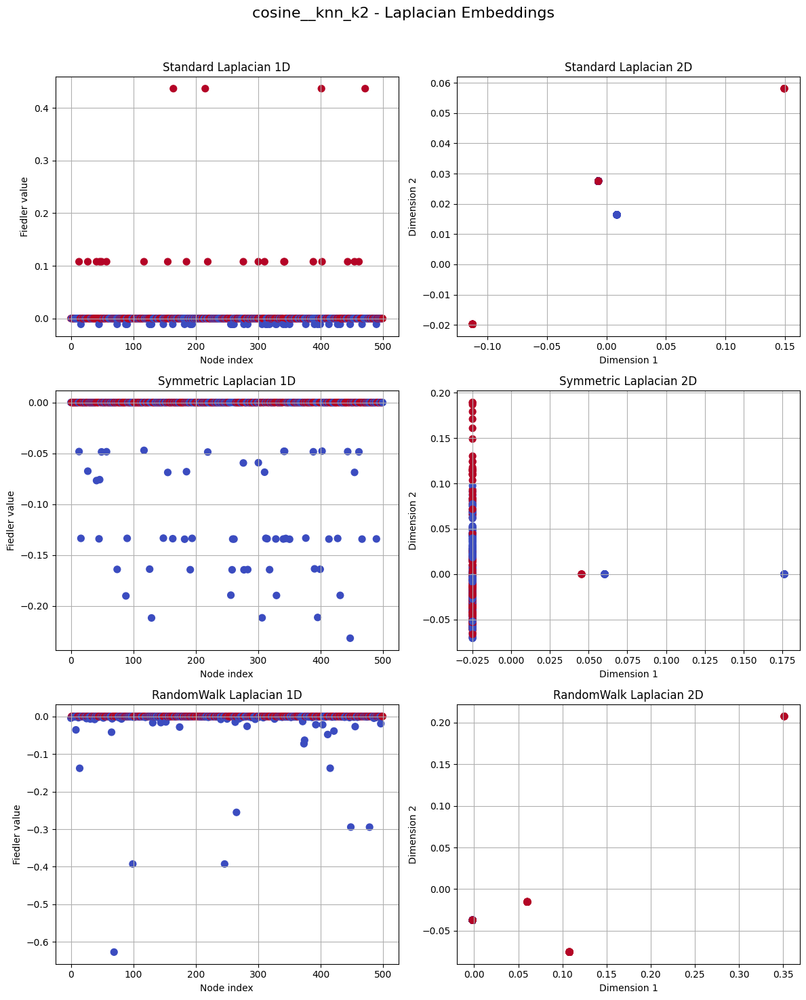

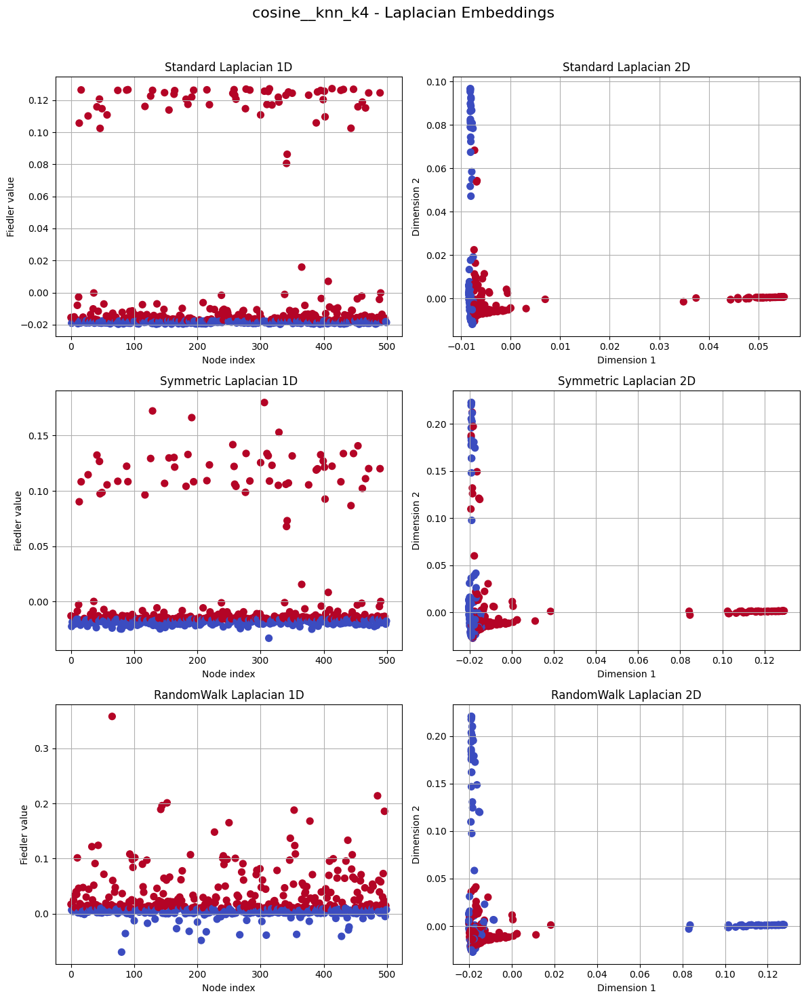

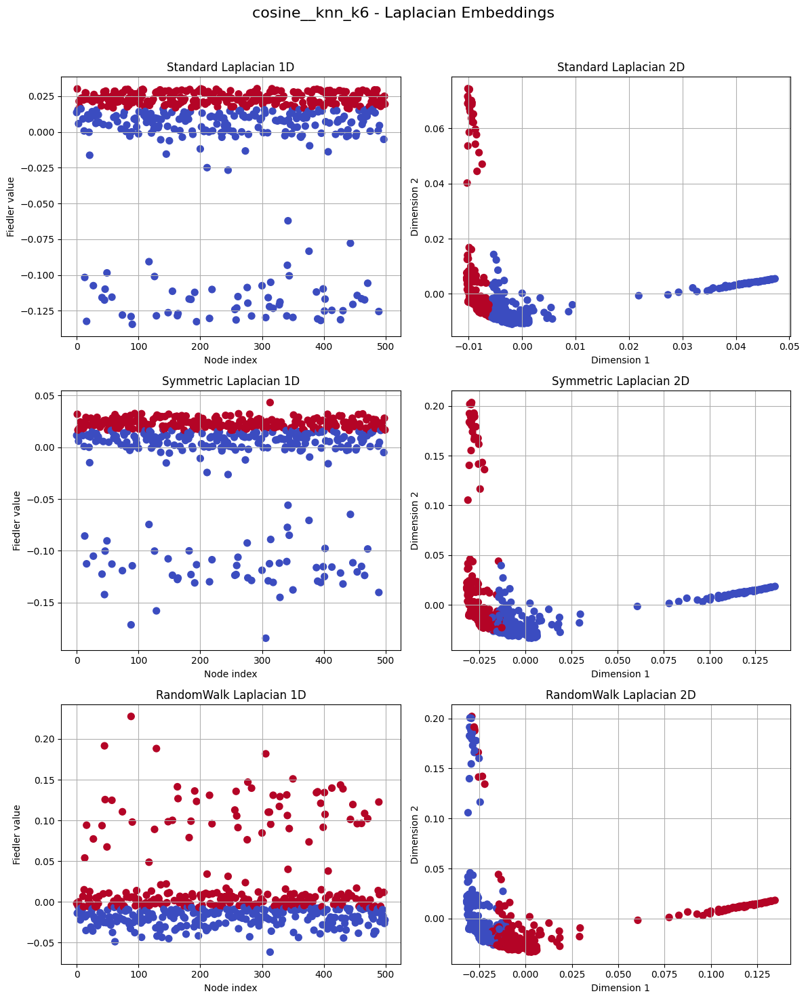

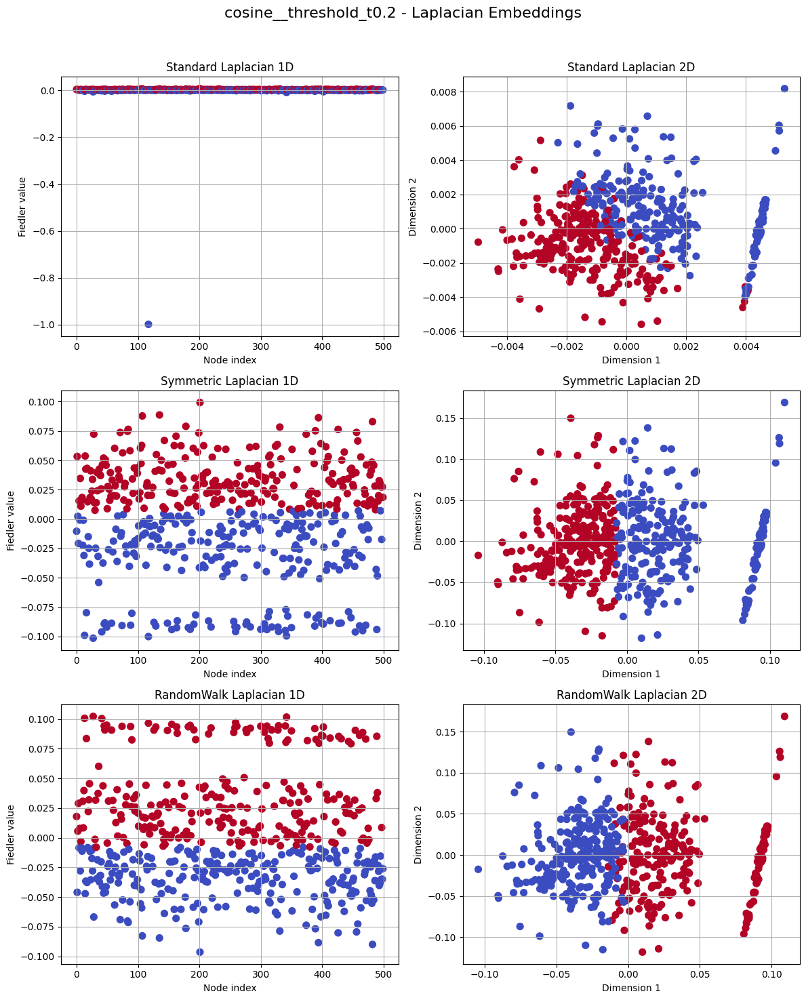

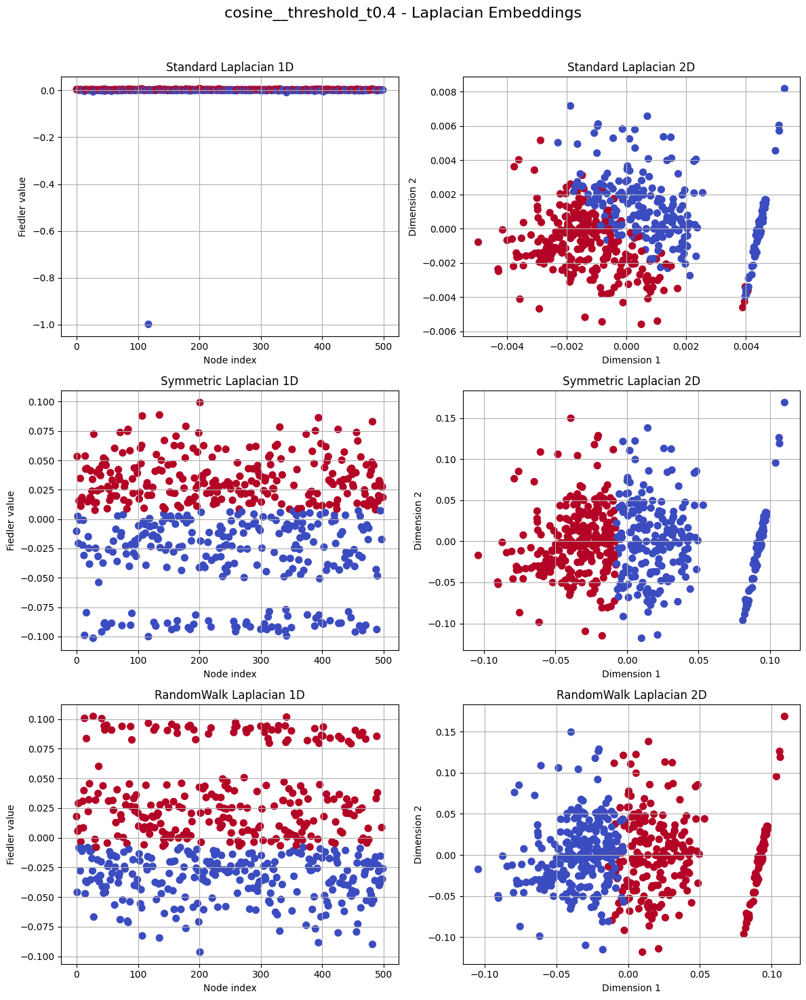

...

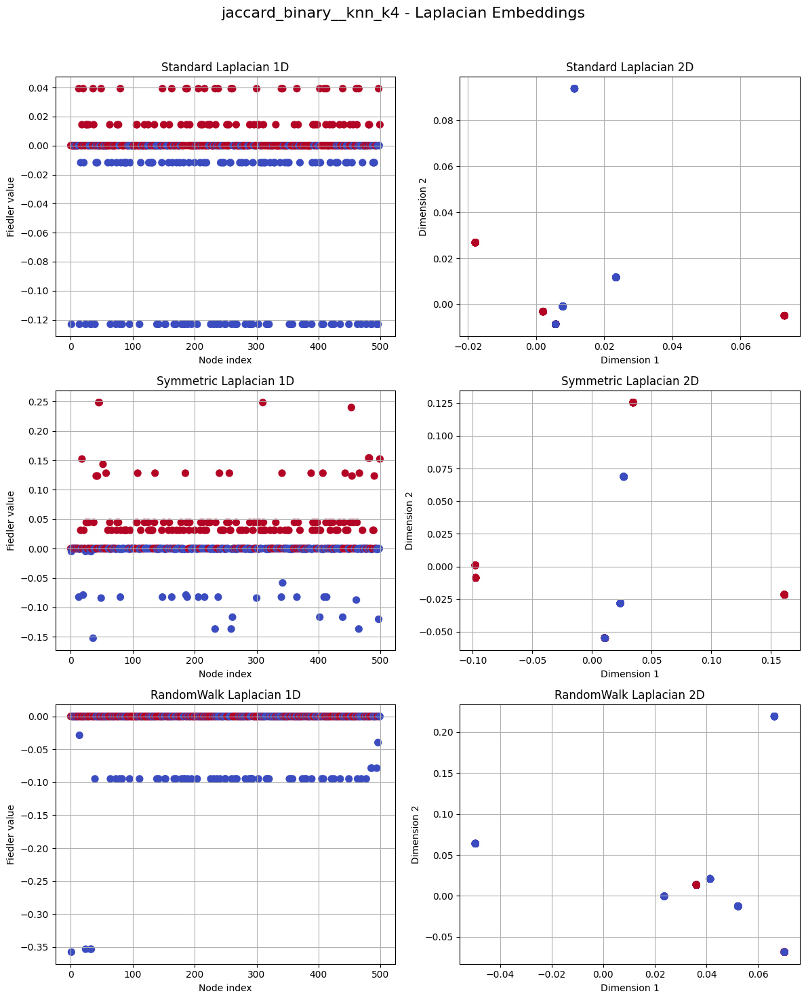

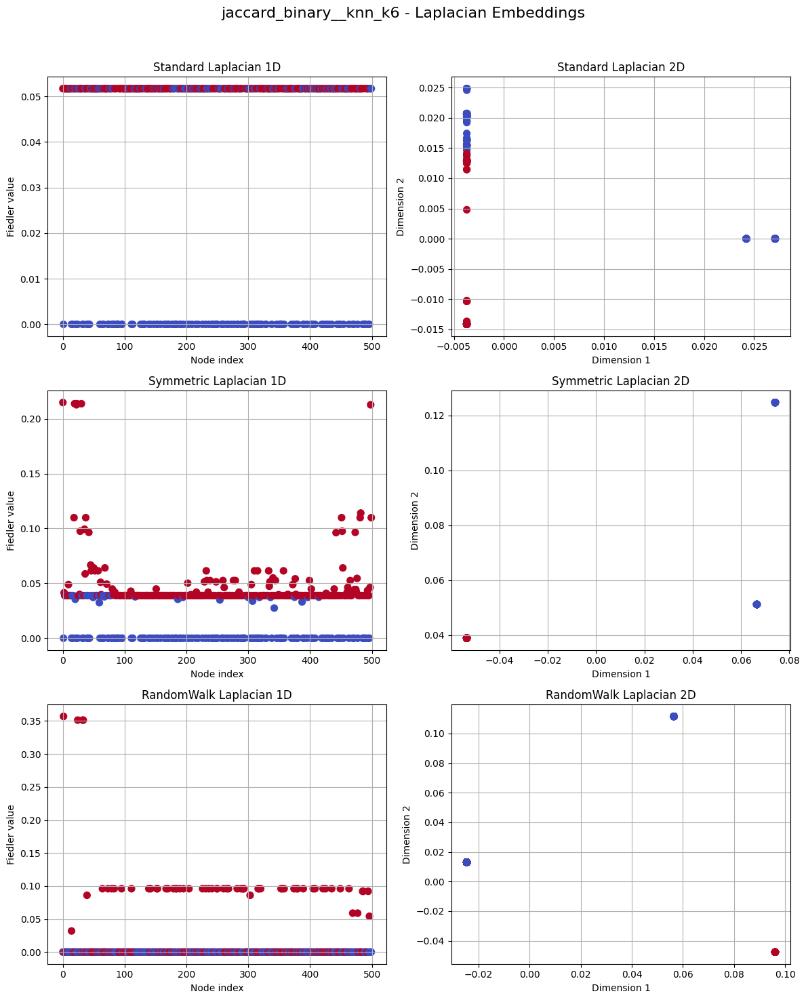

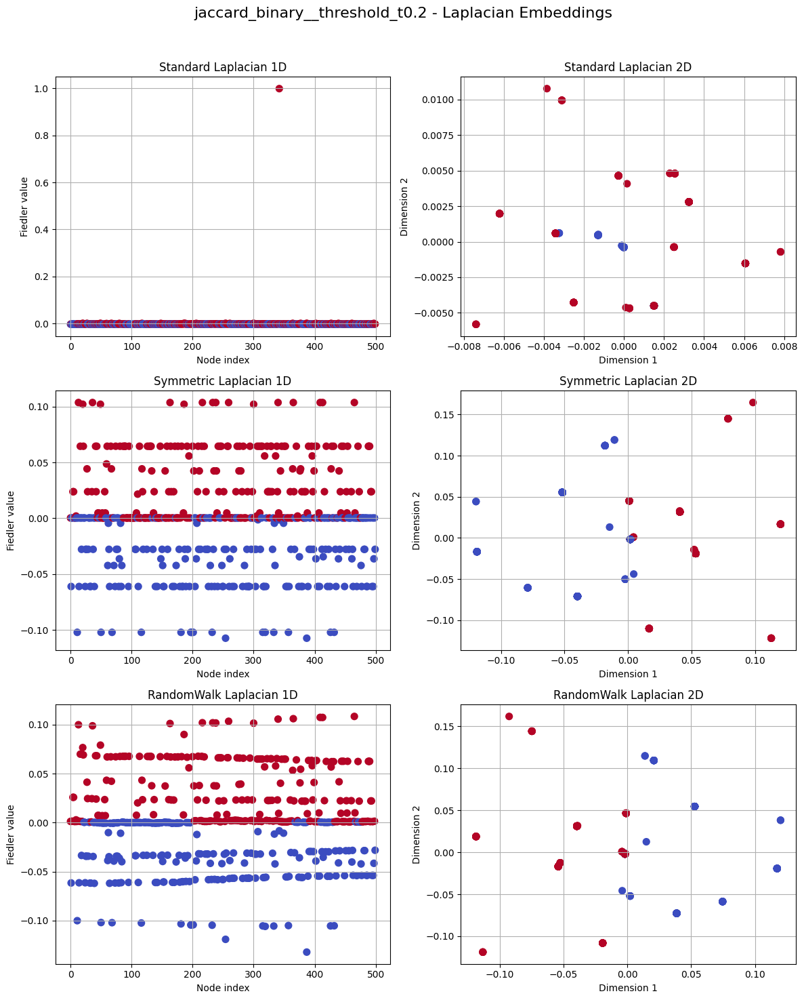

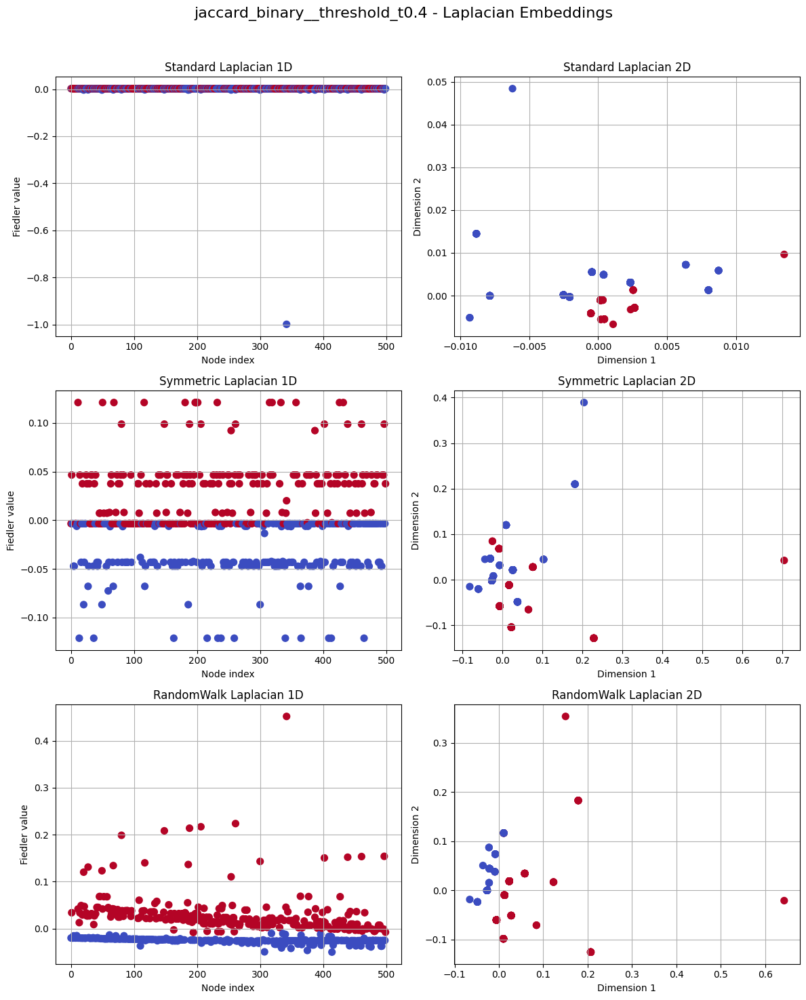

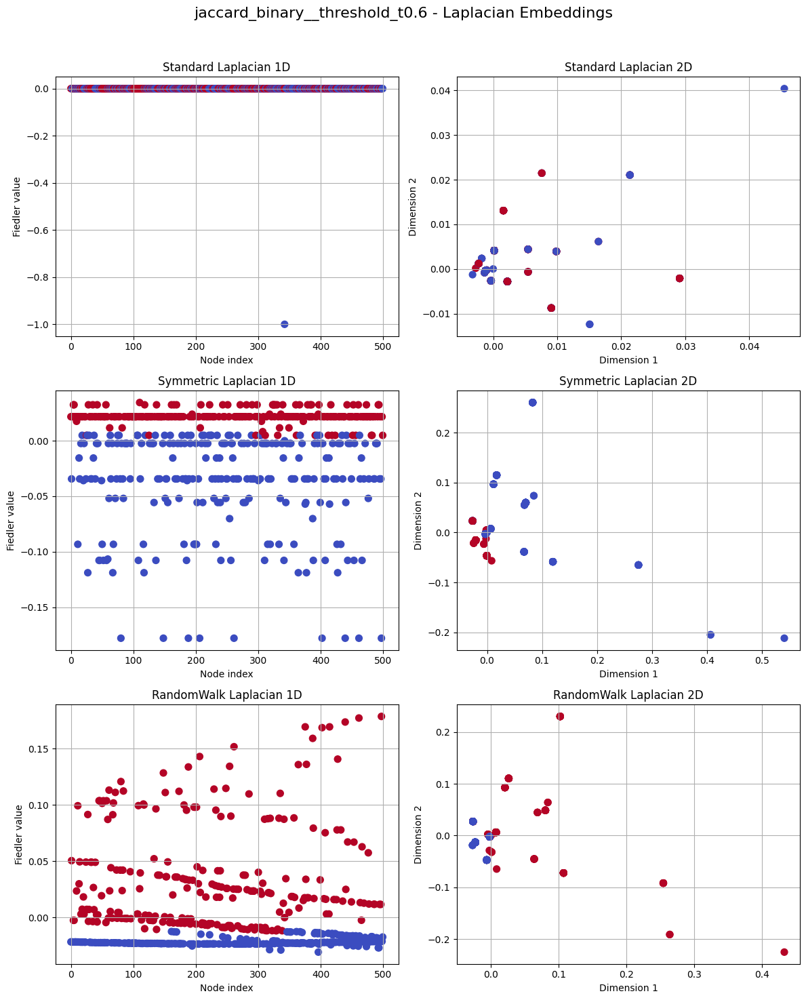

In [8]:
from core.fielder import LaplacianEmbeddings
import warnings 
warnings.filterwarnings("ignore", category=UserWarning)
le = LaplacianEmbeddings(show_plots=True)

for label, lap_data in fied_results.items():
    le.compute_and_plot(lap_data, label_name=label)

## Spectral Embedding 


=== Processing graph: cosine__knn_k2 ===
[SPECTRAL EMBEDDING] Laplacian: L
Embedding shape: (500, 3)
Eigenvalues (first 10): [-0. -0.  0.]
Cluster counts: [459  37   4]


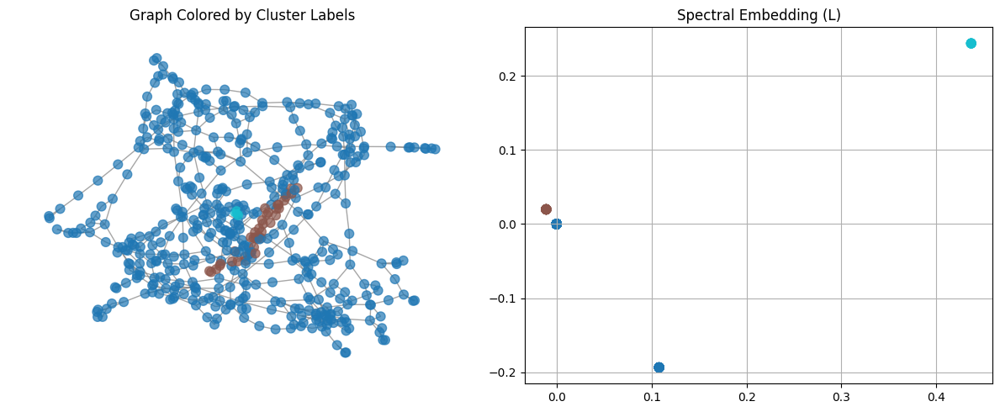

[INFO] Saved outputs for L → C:\Users\LENOVO\Desktop\Spectral_Clustering\outputs\spectral_embedding\cosine__knn_k2\L
[SPECTRAL EMBEDDING] Laplacian: L_sym
Embedding shape: (500, 3)
Eigenvalues (first 10): [-0.  0.  0.]
Cluster counts: [439  41  20]


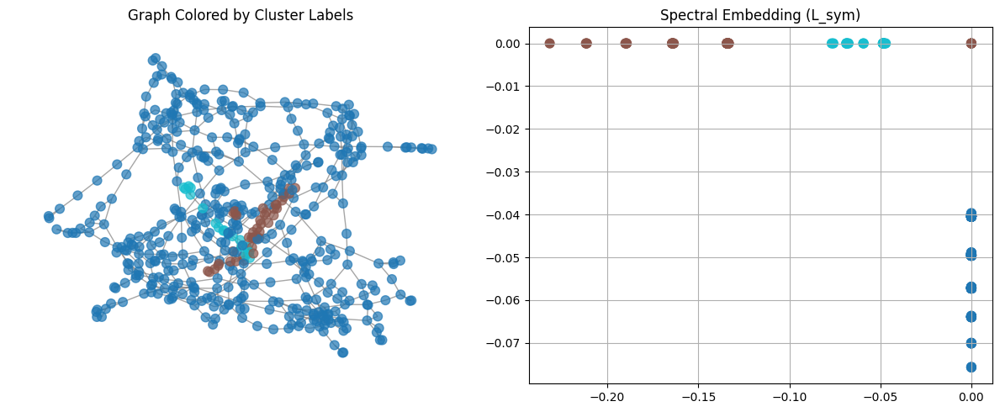

[INFO] Saved outputs for L_sym → C:\Users\LENOVO\Desktop\Spectral_Clustering\outputs\spectral_embedding\cosine__knn_k2\L_sym
[SPECTRAL EMBEDDING] Laplacian: L_rw
Embedding shape: (500, 3)
Eigenvalues (first 10): [-0.298  -0.248  -0.1857]
Cluster counts: [ 11 483   6]


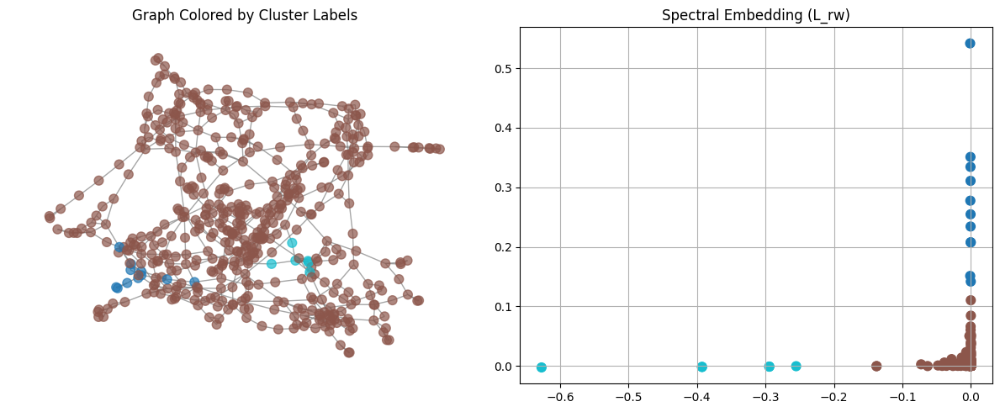

[INFO] Saved outputs for L_rw → C:\Users\LENOVO\Desktop\Spectral_Clustering\outputs\spectral_embedding\cosine__knn_k2\L_rw

=== Processing graph: cosine__knn_k4 ===
[SPECTRAL EMBEDDING] Laplacian: L
Embedding shape: (500, 3)
Eigenvalues (first 10): [0.0183 0.1156 0.2006]
Cluster counts: [411  61  28]


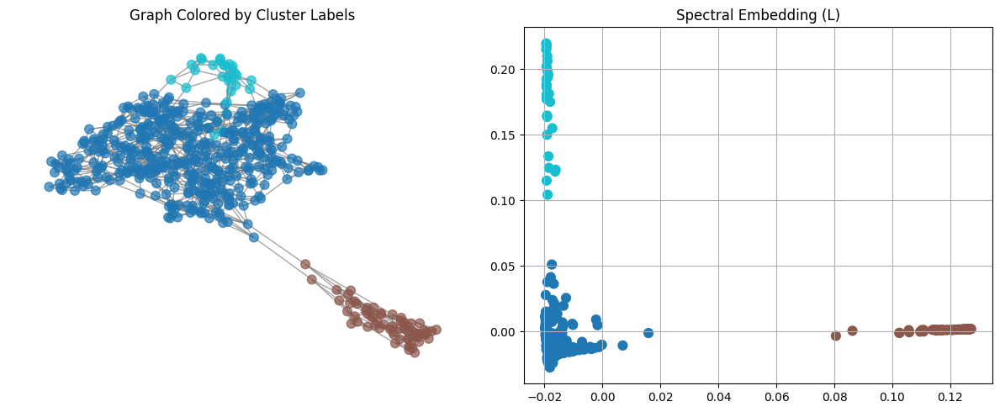

[INFO] Saved outputs for L → C:\Users\LENOVO\Desktop\Spectral_Clustering\outputs\spectral_embedding\cosine__knn_k4\L
[SPECTRAL EMBEDDING] Laplacian: L_sym
Embedding shape: (500, 3)
Eigenvalues (first 10): [0.0034 0.0227 0.0373]
Cluster counts: [411  61  28]


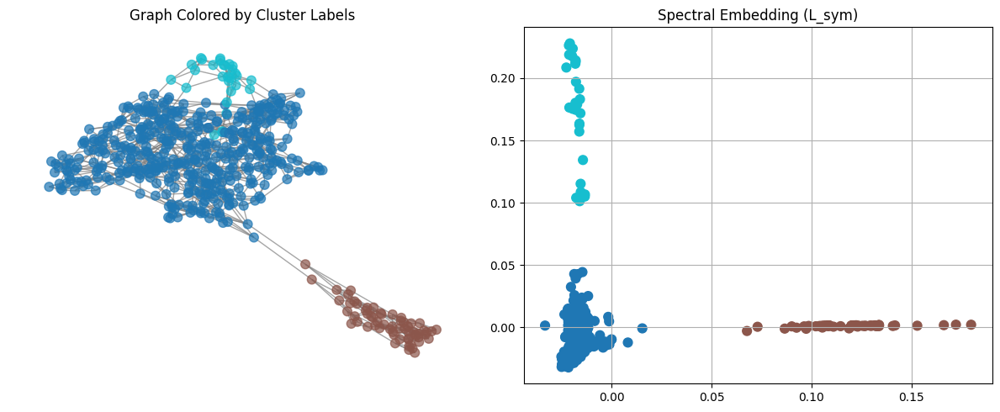

[INFO] Saved outputs for L_sym → C:\Users\LENOVO\Desktop\Spectral_Clustering\outputs\spectral_embedding\cosine__knn_k4\L_sym
[SPECTRAL EMBEDDING] Laplacian: L_rw
Embedding shape: (500, 3)
Eigenvalues (first 10): [-0.0935 -0.0515 -0.0347]
Cluster counts: [ 24  61 415]


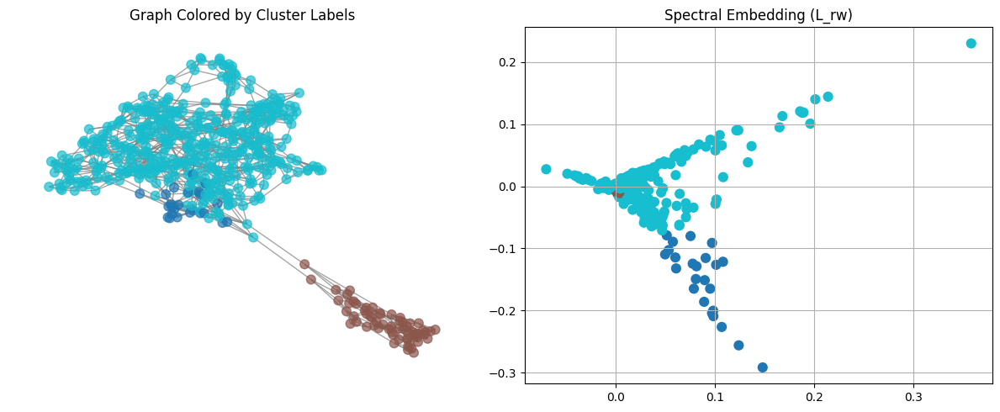

[INFO] Saved outputs for L_rw → C:\Users\LENOVO\Desktop\Spectral_Clustering\outputs\spectral_embedding\cosine__knn_k4\L_rw

=== Processing graph: cosine__knn_k6 ===
[SPECTRAL EMBEDDING] Laplacian: L
Embedding shape: (500, 3)
Eigenvalues (first 10): [0.1325 0.3584 0.4486]
Cluster counts: [411  61  28]


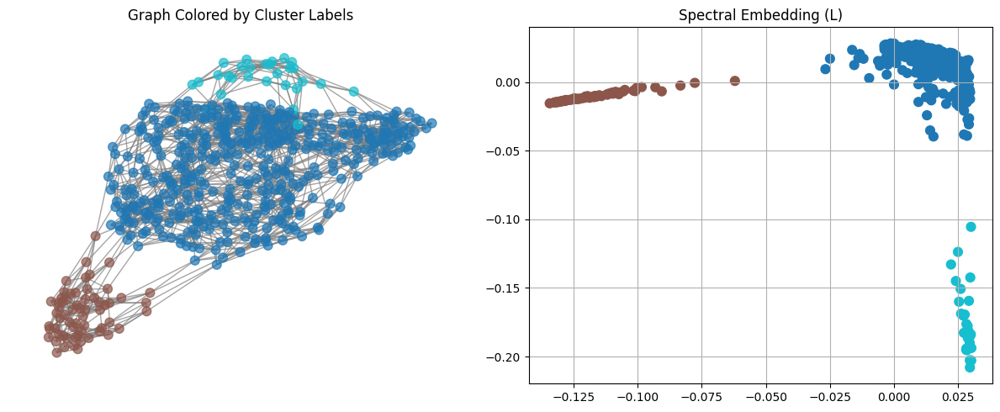

[INFO] Saved outputs for L → C:\Users\LENOVO\Desktop\Spectral_Clustering\outputs\spectral_embedding\cosine__knn_k6\L
[SPECTRAL EMBEDDING] Laplacian: L_sym
Embedding shape: (500, 3)
Eigenvalues (first 10): [0.0166 0.0481 0.057 ]
Cluster counts: [411  61  28]


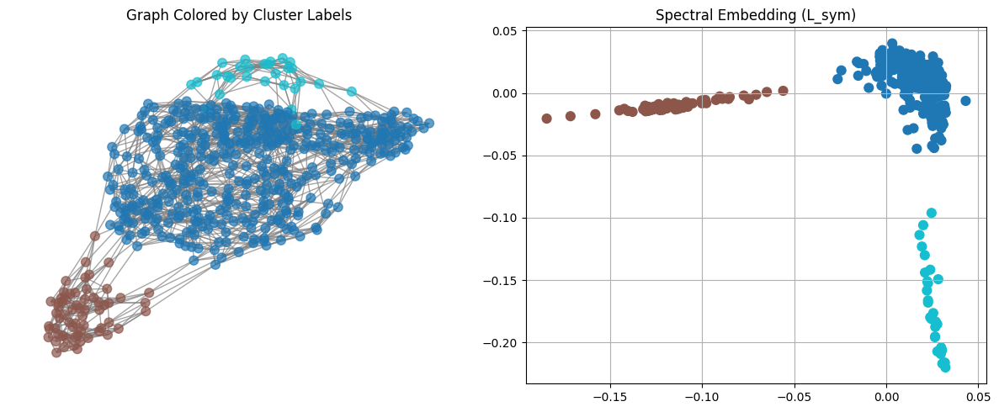

[INFO] Saved outputs for L_sym → C:\Users\LENOVO\Desktop\Spectral_Clustering\outputs\spectral_embedding\cosine__knn_k6\L_sym
[SPECTRAL EMBEDDING] Laplacian: L_rw
Embedding shape: (500, 3)
Eigenvalues (first 10): [-0.0188  0.0047  0.0135]
Cluster counts: [307  59 134]


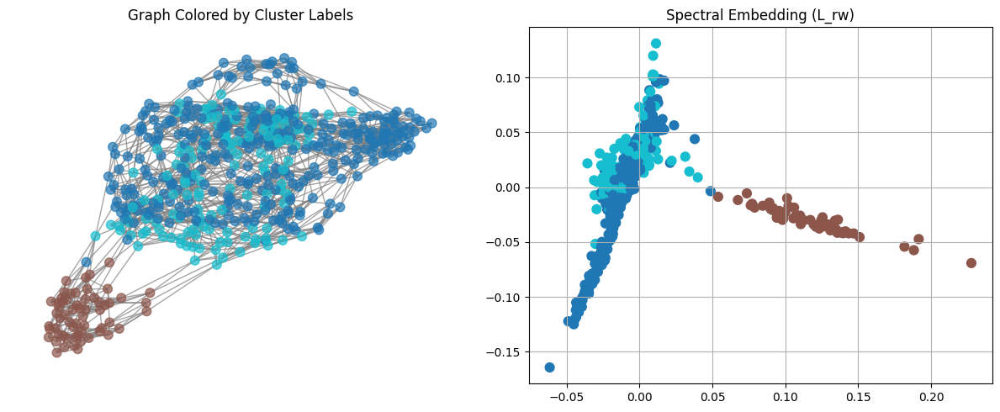

[INFO] Saved outputs for L_rw → C:\Users\LENOVO\Desktop\Spectral_Clustering\outputs\spectral_embedding\cosine__knn_k6\L_rw

=== Processing graph: cosine__threshold_t0.2 ===
[SPECTRAL EMBEDDING] Laplacian: L
Embedding shape: (500, 3)
Eigenvalues (first 10): [357.8218 371.0867 373.407 ]
Cluster counts: [498   1   1]


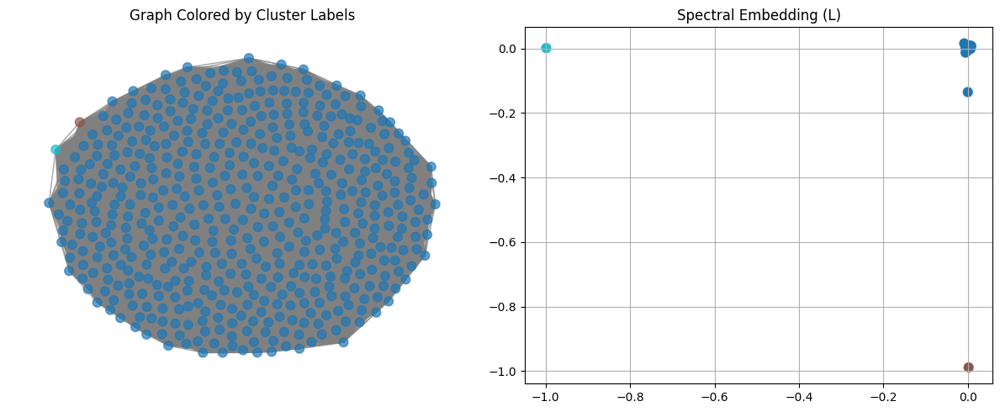

[INFO] Saved outputs for L → C:\Users\LENOVO\Desktop\Spectral_Clustering\outputs\spectral_embedding\cosine__threshold_t0.2\L
[SPECTRAL EMBEDDING] Laplacian: L_sym
Embedding shape: (500, 3)
Eigenvalues (first 10): [0.9584 0.9807 0.9838]
Cluster counts: [190 132 178]


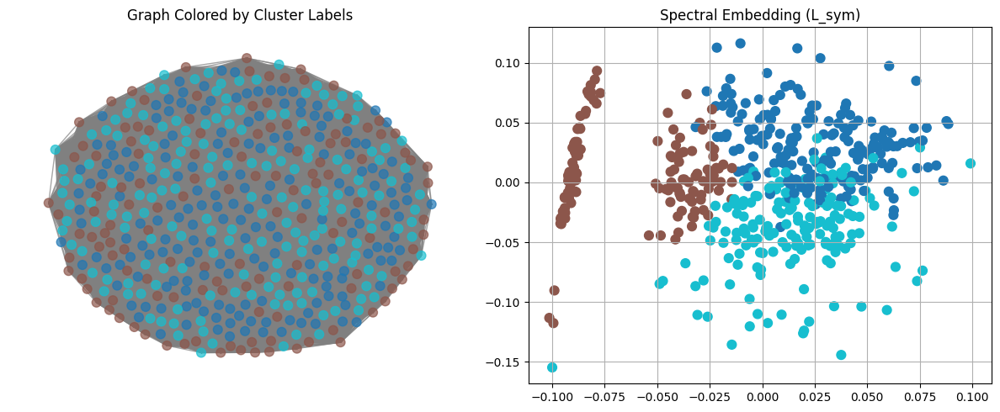

[INFO] Saved outputs for L_sym → C:\Users\LENOVO\Desktop\Spectral_Clustering\outputs\spectral_embedding\cosine__threshold_t0.2\L_sym
[SPECTRAL EMBEDDING] Laplacian: L_rw
Embedding shape: (500, 3)
Eigenvalues (first 10): [0.9584 0.9806 0.9835]
Cluster counts: [131 196 173]


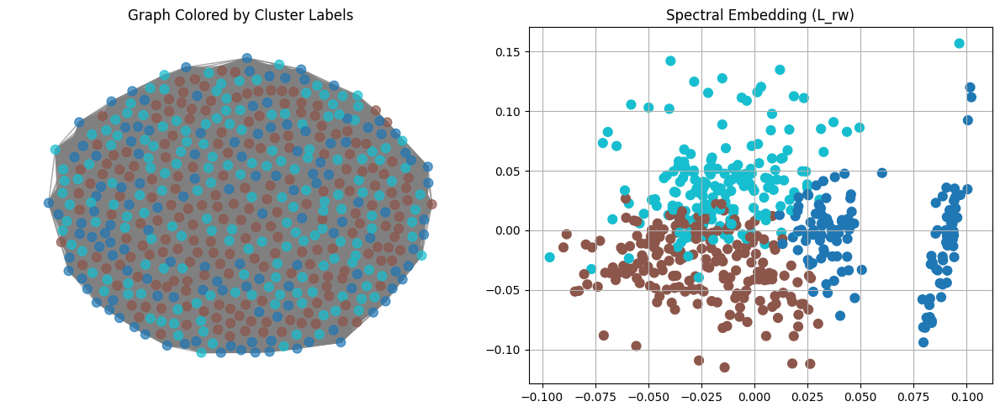

[INFO] Saved outputs for L_rw → C:\Users\LENOVO\Desktop\Spectral_Clustering\outputs\spectral_embedding\cosine__threshold_t0.2\L_rw

=== Processing graph: cosine__threshold_t0.4 ===
[SPECTRAL EMBEDDING] Laplacian: L
Embedding shape: (500, 3)
Eigenvalues (first 10): [357.8218 371.0867 373.407 ]
Cluster counts: [498   1   1]


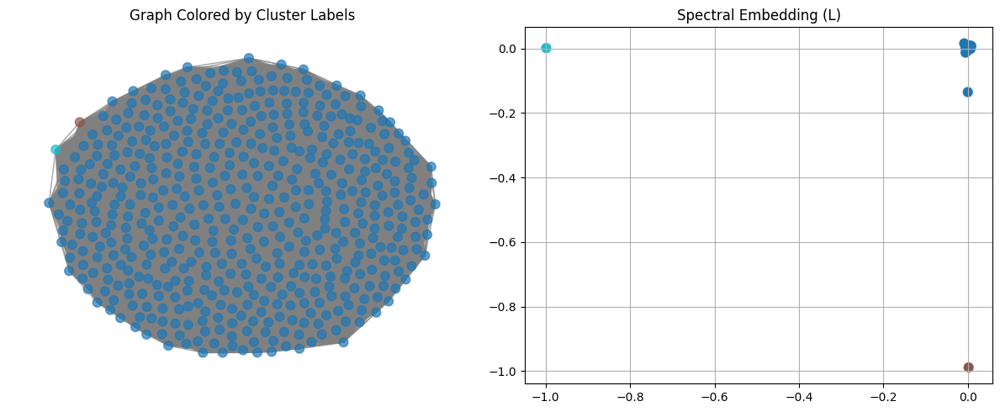

[INFO] Saved outputs for L → C:\Users\LENOVO\Desktop\Spectral_Clustering\outputs\spectral_embedding\cosine__threshold_t0.4\L
[SPECTRAL EMBEDDING] Laplacian: L_sym
Embedding shape: (500, 3)
Eigenvalues (first 10): [0.9584 0.9807 0.9838]
Cluster counts: [190 132 178]


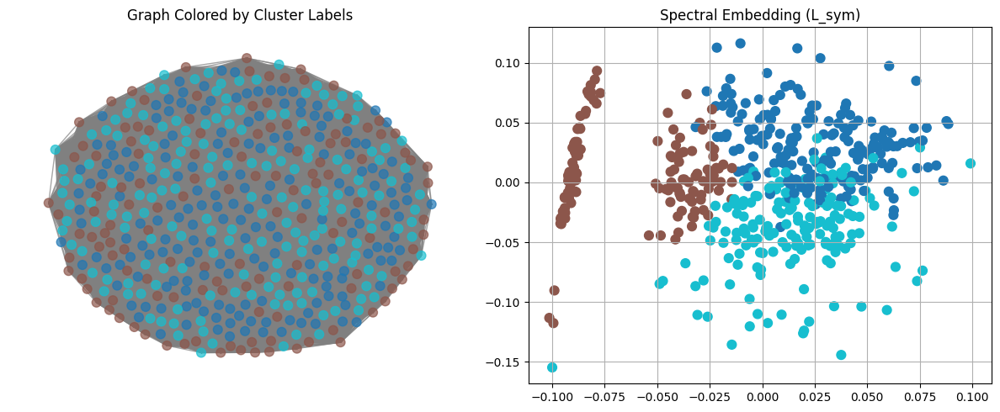

[INFO] Saved outputs for L_sym → C:\Users\LENOVO\Desktop\Spectral_Clustering\outputs\spectral_embedding\cosine__threshold_t0.4\L_sym
[SPECTRAL EMBEDDING] Laplacian: L_rw
Embedding shape: (500, 3)
Eigenvalues (first 10): [0.9584 0.9806 0.9835]
Cluster counts: [131 196 173]


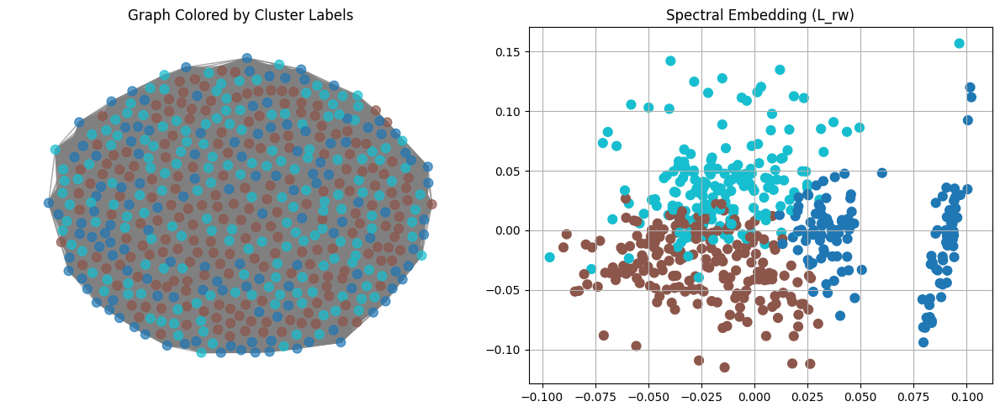

[INFO] Saved outputs for L_rw → C:\Users\LENOVO\Desktop\Spectral_Clustering\outputs\spectral_embedding\cosine__threshold_t0.4\L_rw

=== Processing graph: cosine__threshold_t0.6 ===
[SPECTRAL EMBEDDING] Laplacian: L
Embedding shape: (500, 3)
Eigenvalues (first 10): [322.6711 354.4453 358.4932]
Cluster counts: [498   1   1]


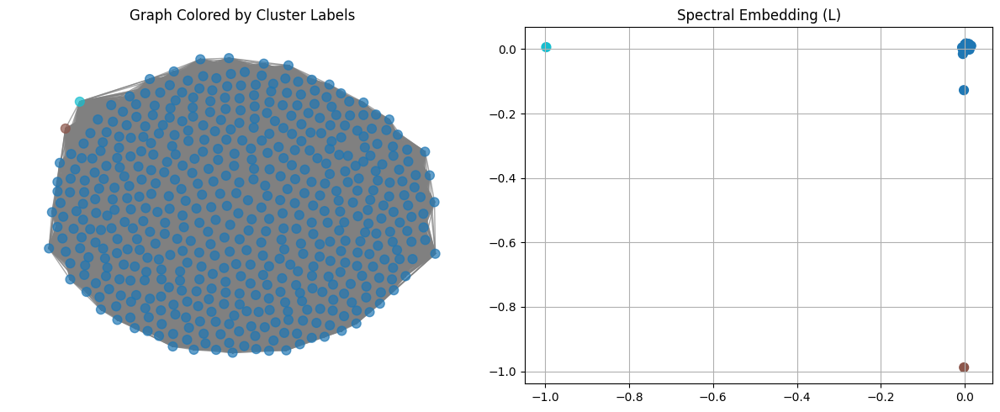

[INFO] Saved outputs for L → C:\Users\LENOVO\Desktop\Spectral_Clustering\outputs\spectral_embedding\cosine__threshold_t0.6\L
[SPECTRAL EMBEDDING] Laplacian: L_sym
Embedding shape: (500, 3)
Eigenvalues (first 10): [0.9528 0.9767 0.98  ]
Cluster counts: [197 170 133]


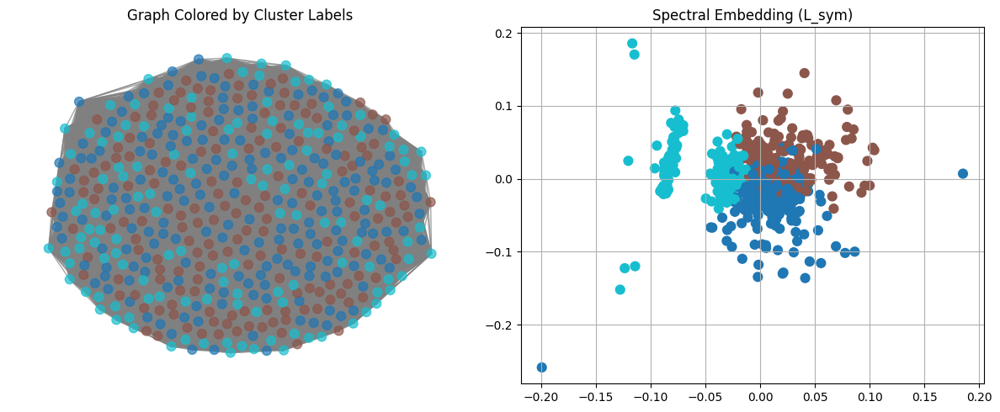

[INFO] Saved outputs for L_sym → C:\Users\LENOVO\Desktop\Spectral_Clustering\outputs\spectral_embedding\cosine__threshold_t0.6\L_sym
[SPECTRAL EMBEDDING] Laplacian: L_rw
Embedding shape: (500, 3)
Eigenvalues (first 10): [0.9529 0.9765 0.9798]
Cluster counts: [182 136 182]


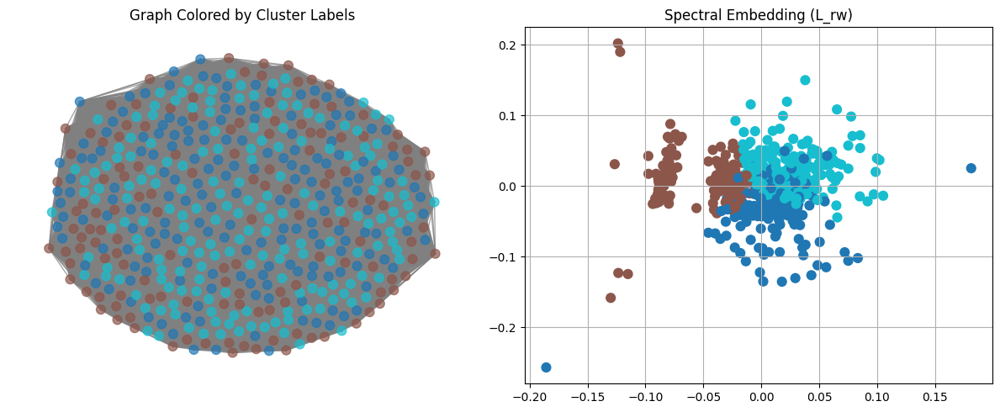

[INFO] Saved outputs for L_rw → C:\Users\LENOVO\Desktop\Spectral_Clustering\outputs\spectral_embedding\cosine__threshold_t0.6\L_rw

=== Processing graph: correlation__knn_k2 ===
[SPECTRAL EMBEDDING] Laplacian: L
Embedding shape: (500, 3)
Eigenvalues (first 10): [0.     0.0077 0.0136]
Cluster counts: [436  61   3]


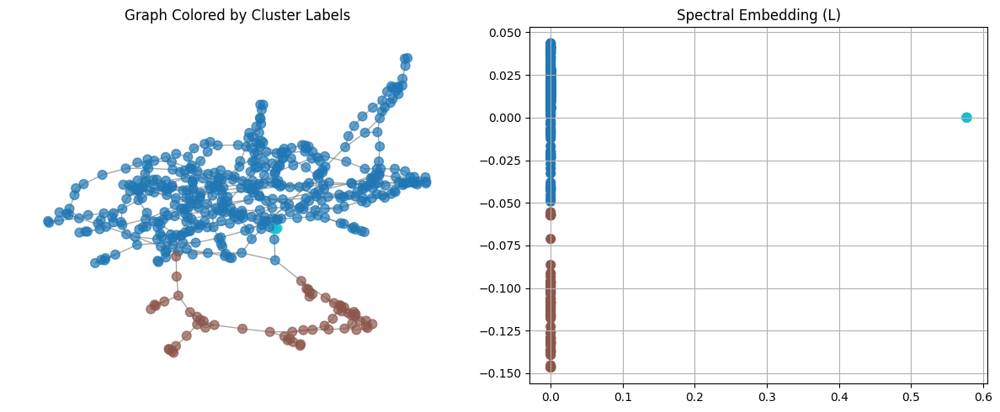

[INFO] Saved outputs for L → C:\Users\LENOVO\Desktop\Spectral_Clustering\outputs\spectral_embedding\correlation__knn_k2\L
[SPECTRAL EMBEDDING] Laplacian: L_sym
Embedding shape: (500, 3)
Eigenvalues (first 10): [-0.      0.0028  0.0051]
Cluster counts: [413  60  27]


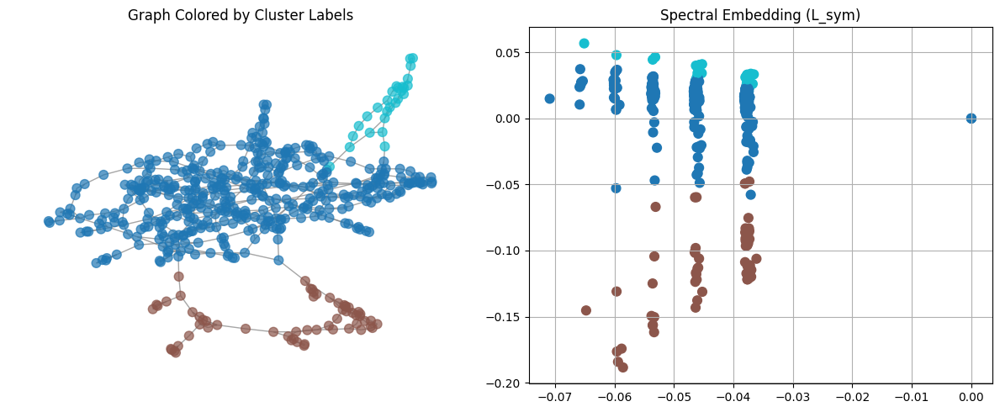

[INFO] Saved outputs for L_sym → C:\Users\LENOVO\Desktop\Spectral_Clustering\outputs\spectral_embedding\correlation__knn_k2\L_sym
[SPECTRAL EMBEDDING] Laplacian: L_rw
Embedding shape: (500, 3)
Eigenvalues (first 10): [-0.3145 -0.2589 -0.2161]
Cluster counts: [  5 489   6]


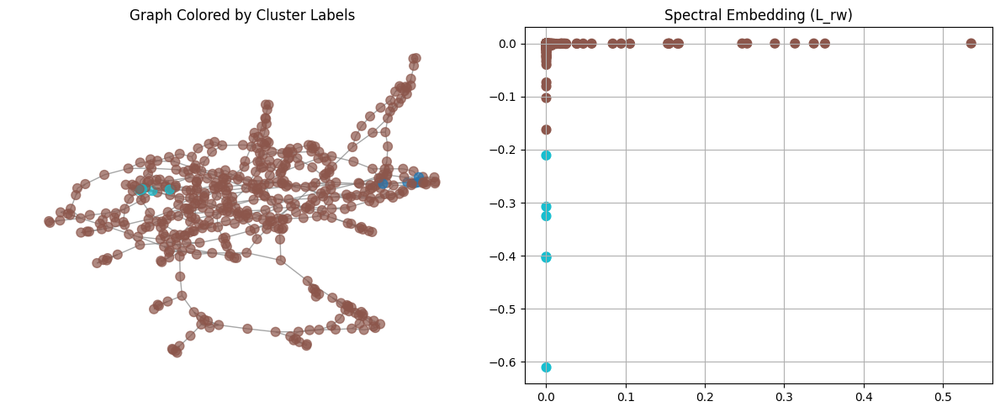

[INFO] Saved outputs for L_rw → C:\Users\LENOVO\Desktop\Spectral_Clustering\outputs\spectral_embedding\correlation__knn_k2\L_rw

=== Processing graph: correlation__knn_k4 ===
[SPECTRAL EMBEDDING] Laplacian: L
Embedding shape: (500, 3)
Eigenvalues (first 10): [0.0519 0.1357 0.2102]
Cluster counts: [412  61  27]


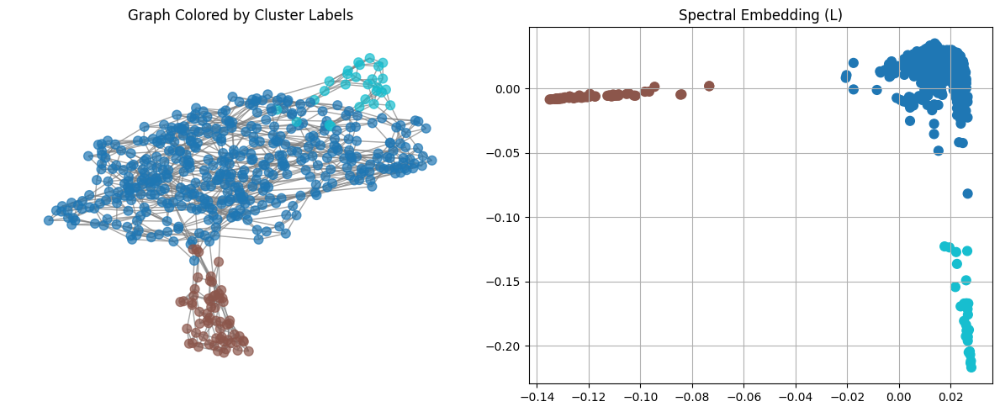

[INFO] Saved outputs for L → C:\Users\LENOVO\Desktop\Spectral_Clustering\outputs\spectral_embedding\correlation__knn_k4\L
[SPECTRAL EMBEDDING] Laplacian: L_sym
Embedding shape: (500, 3)
Eigenvalues (first 10): [0.0098 0.0271 0.0393]
Cluster counts: [ 61 197 242]


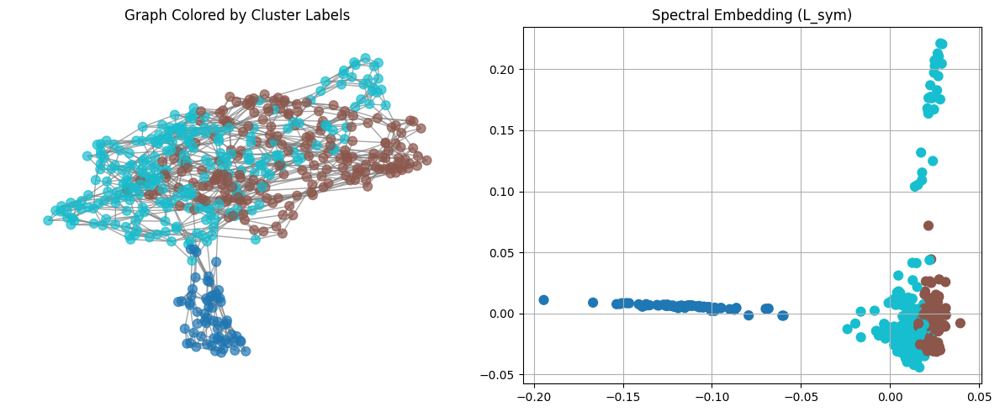

[INFO] Saved outputs for L_sym → C:\Users\LENOVO\Desktop\Spectral_Clustering\outputs\spectral_embedding\correlation__knn_k4\L_sym
[SPECTRAL EMBEDDING] Laplacian: L_rw
Embedding shape: (500, 3)
Eigenvalues (first 10): [-0.0623 -0.052  -0.0119]
Cluster counts: [ 27 413  60]


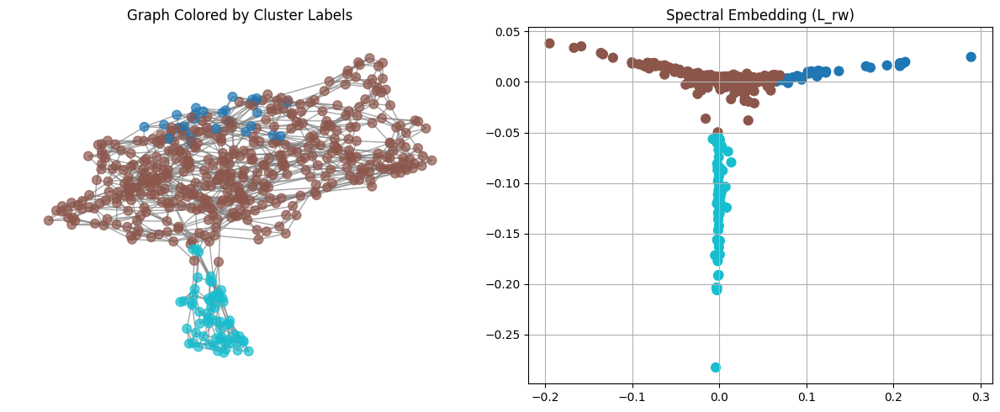

[INFO] Saved outputs for L_rw → C:\Users\LENOVO\Desktop\Spectral_Clustering\outputs\spectral_embedding\correlation__knn_k4\L_rw

=== Processing graph: correlation__knn_k6 ===
[SPECTRAL EMBEDDING] Laplacian: L
Embedding shape: (500, 3)
Eigenvalues (first 10): [0.1692 0.3844 0.4356]
Cluster counts: [412  60  28]


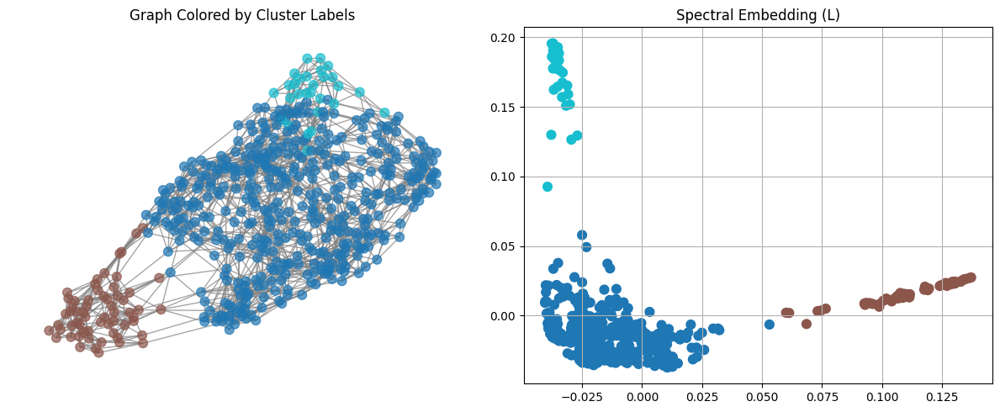

[INFO] Saved outputs for L → C:\Users\LENOVO\Desktop\Spectral_Clustering\outputs\spectral_embedding\correlation__knn_k6\L
[SPECTRAL EMBEDDING] Laplacian: L_sym
Embedding shape: (500, 3)
Eigenvalues (first 10): [0.0217 0.0523 0.0564]
Cluster counts: [416  57  27]


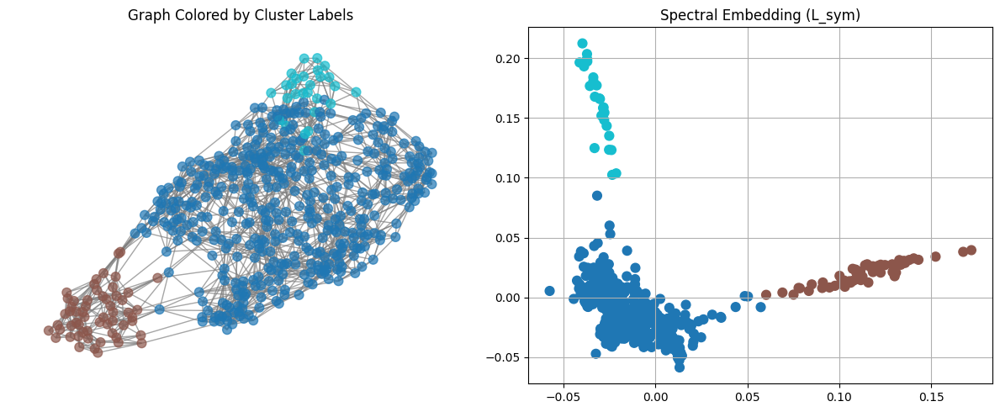

[INFO] Saved outputs for L_sym → C:\Users\LENOVO\Desktop\Spectral_Clustering\outputs\spectral_embedding\correlation__knn_k6\L_sym
[SPECTRAL EMBEDDING] Laplacian: L_rw
Embedding shape: (500, 3)
Eigenvalues (first 10): [-0.0052  0.0217  0.0282]
Cluster counts: [319  57 124]


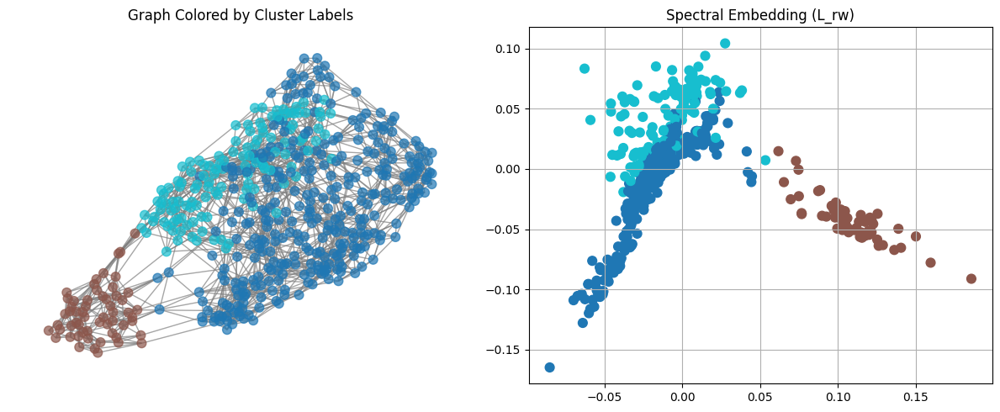

[INFO] Saved outputs for L_rw → C:\Users\LENOVO\Desktop\Spectral_Clustering\outputs\spectral_embedding\correlation__knn_k6\L_rw

=== Processing graph: correlation__threshold_t0.2 ===
[SPECTRAL EMBEDDING] Laplacian: L
Embedding shape: (500, 3)
Eigenvalues (first 10): [233.2999 241.2803 242.0186]
Cluster counts: [498   1   1]


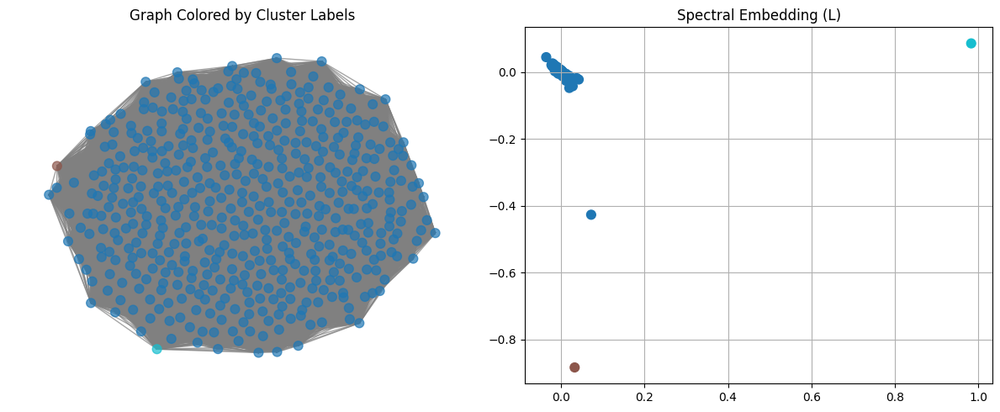

[INFO] Saved outputs for L → C:\Users\LENOVO\Desktop\Spectral_Clustering\outputs\spectral_embedding\correlation__threshold_t0.2\L
[SPECTRAL EMBEDDING] Laplacian: L_sym
Embedding shape: (500, 3)
Eigenvalues (first 10): [0.8497 0.9314 0.9394]
Cluster counts: [216 143 141]


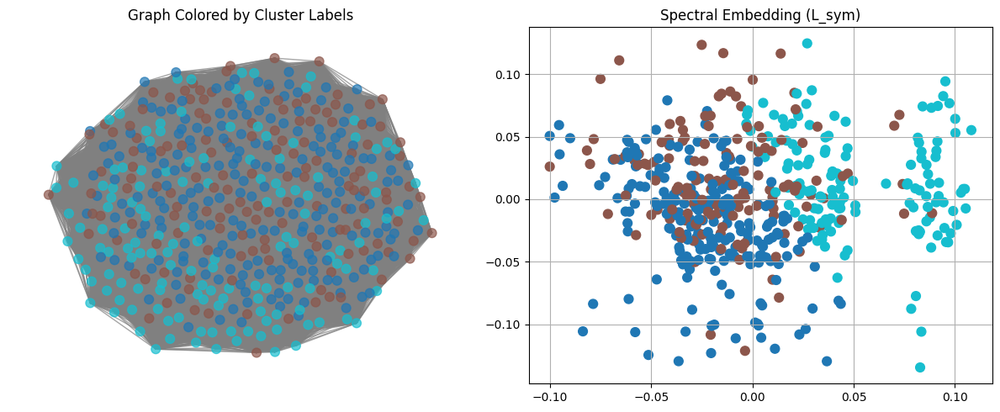

[INFO] Saved outputs for L_sym → C:\Users\LENOVO\Desktop\Spectral_Clustering\outputs\spectral_embedding\correlation__threshold_t0.2\L_sym
[SPECTRAL EMBEDDING] Laplacian: L_rw
Embedding shape: (500, 3)
Eigenvalues (first 10): [0.849  0.9312 0.939 ]
Cluster counts: [225 136 139]


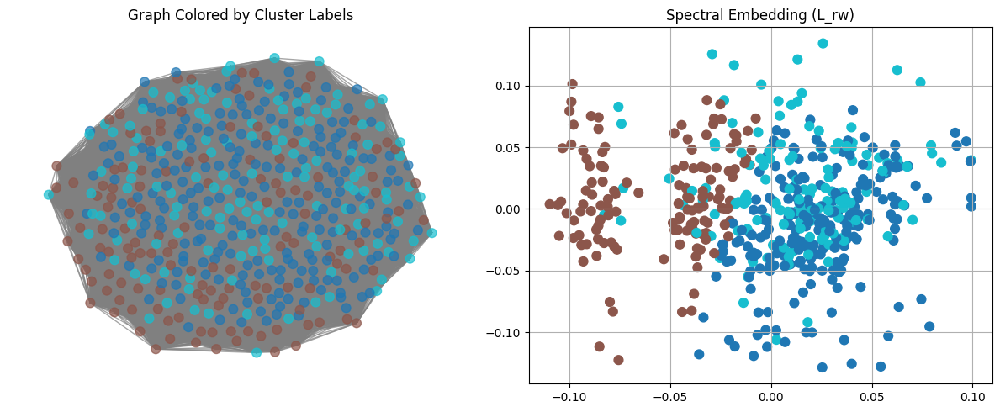

[INFO] Saved outputs for L_rw → C:\Users\LENOVO\Desktop\Spectral_Clustering\outputs\spectral_embedding\correlation__threshold_t0.2\L_rw

=== Processing graph: correlation__threshold_t0.4 ===
[SPECTRAL EMBEDDING] Laplacian: L
Embedding shape: (500, 3)
Eigenvalues (first 10): [186.0994 203.967  205.6509]
Cluster counts: [498   1   1]


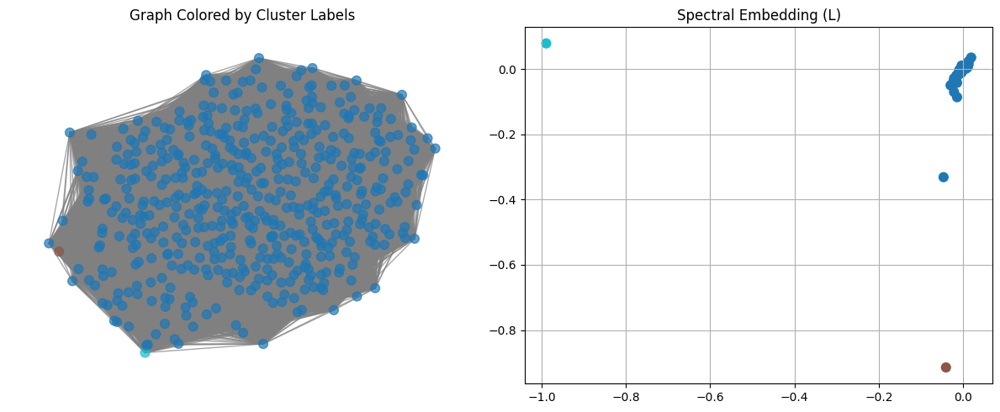

[INFO] Saved outputs for L → C:\Users\LENOVO\Desktop\Spectral_Clustering\outputs\spectral_embedding\correlation__threshold_t0.4\L
[SPECTRAL EMBEDDING] Laplacian: L_sym
Embedding shape: (500, 3)
Eigenvalues (first 10): [0.8012 0.914  0.9251]
Cluster counts: [221 145 134]


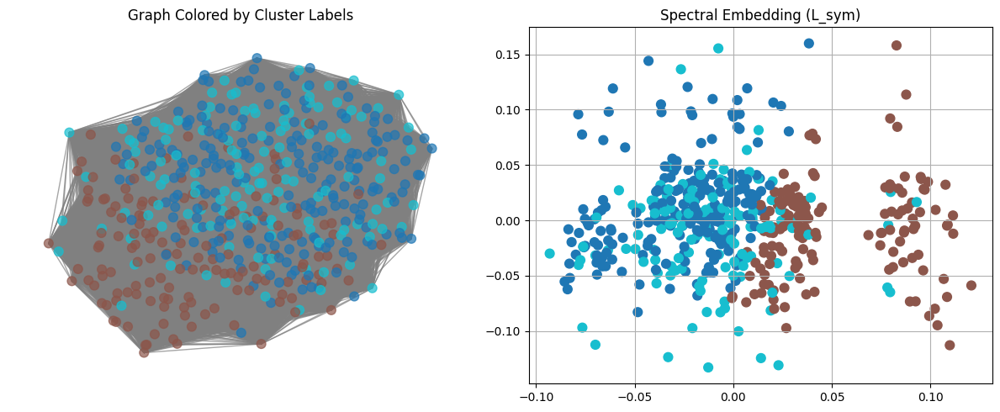

[INFO] Saved outputs for L_sym → C:\Users\LENOVO\Desktop\Spectral_Clustering\outputs\spectral_embedding\correlation__threshold_t0.4\L_sym
[SPECTRAL EMBEDDING] Laplacian: L_rw
Embedding shape: (500, 3)
Eigenvalues (first 10): [0.7992 0.9136 0.9233]
Cluster counts: [145 223 132]


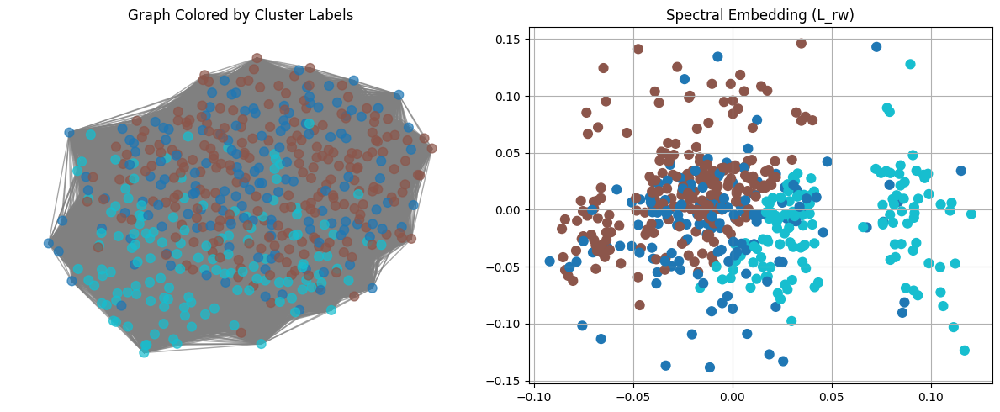

[INFO] Saved outputs for L_rw → C:\Users\LENOVO\Desktop\Spectral_Clustering\outputs\spectral_embedding\correlation__threshold_t0.4\L_rw

=== Processing graph: correlation__threshold_t0.6 ===
[SPECTRAL EMBEDDING] Laplacian: L
Embedding shape: (500, 3)
Eigenvalues (first 10): [102.7918 106.0758 118.9119]
Cluster counts: [498   1   1]


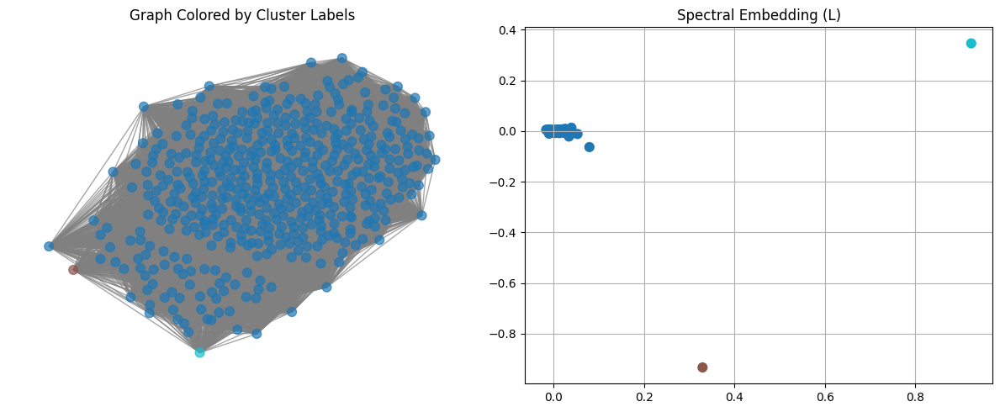

[INFO] Saved outputs for L → C:\Users\LENOVO\Desktop\Spectral_Clustering\outputs\spectral_embedding\correlation__threshold_t0.6\L
[SPECTRAL EMBEDDING] Laplacian: L_sym
Embedding shape: (500, 3)
Eigenvalues (first 10): [0.6589 0.8423 0.8641]
Cluster counts: [248 109 143]


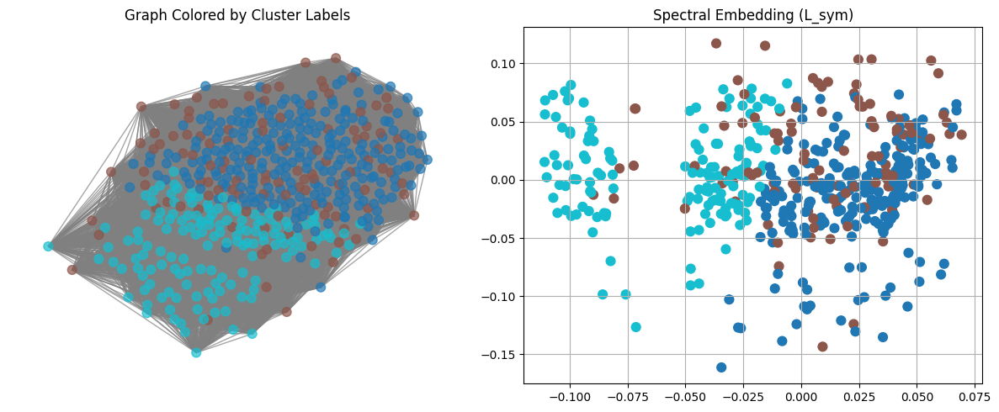

[INFO] Saved outputs for L_sym → C:\Users\LENOVO\Desktop\Spectral_Clustering\outputs\spectral_embedding\correlation__threshold_t0.6\L_sym
[SPECTRAL EMBEDDING] Laplacian: L_rw
Embedding shape: (500, 3)
Eigenvalues (first 10): [0.6455 0.8395 0.856 ]
Cluster counts: [256 145  99]


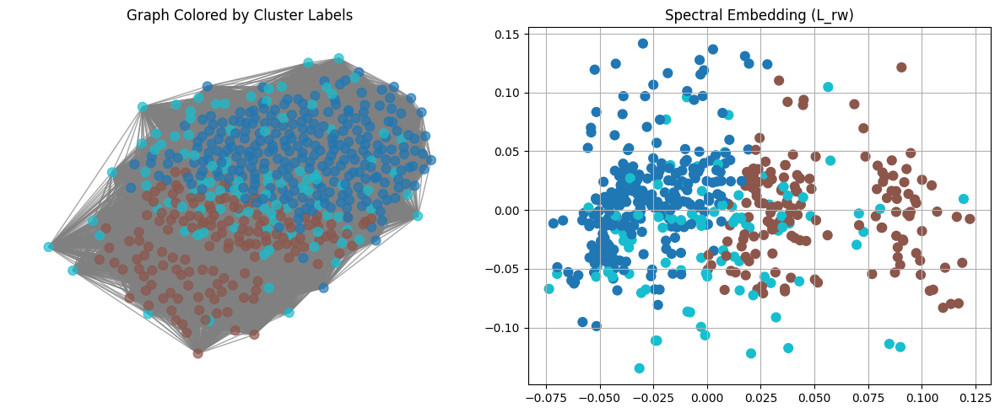

[INFO] Saved outputs for L_rw → C:\Users\LENOVO\Desktop\Spectral_Clustering\outputs\spectral_embedding\correlation__threshold_t0.6\L_rw

=== Processing graph: jaccard_binary__knn_k2 ===
[SPECTRAL EMBEDDING] Laplacian: L
Embedding shape: (500, 3)
Eigenvalues (first 10): [-0. -0. -0.]
Cluster counts: [426  12  62]


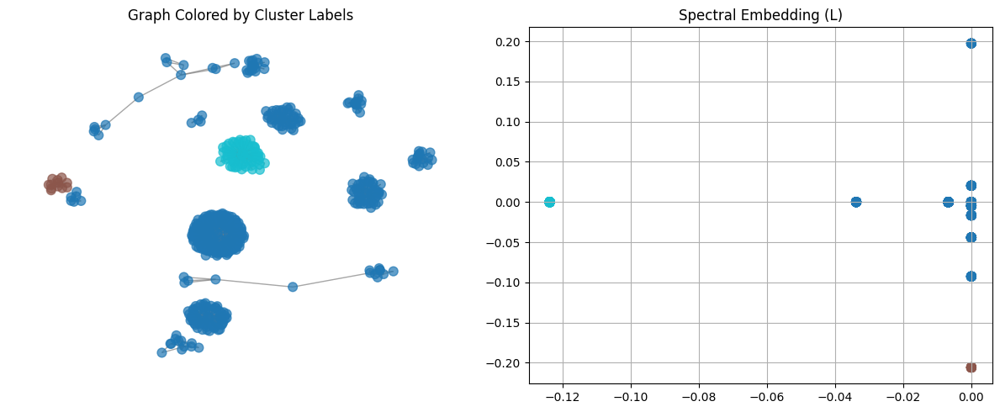

[INFO] Saved outputs for L → C:\Users\LENOVO\Desktop\Spectral_Clustering\outputs\spectral_embedding\jaccard_binary__knn_k2\L
[SPECTRAL EMBEDDING] Laplacian: L_sym
Embedding shape: (500, 3)
Eigenvalues (first 10): [-0. -0. -0.]
Cluster counts: [453  31  16]


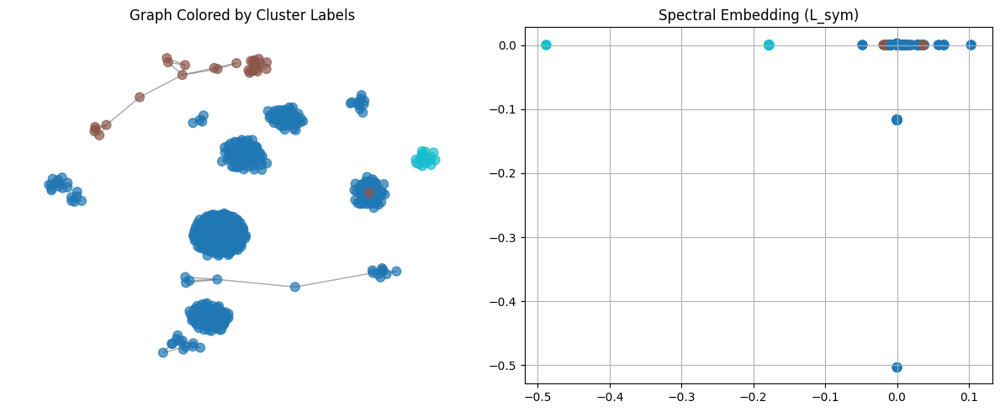

[INFO] Saved outputs for L_sym → C:\Users\LENOVO\Desktop\Spectral_Clustering\outputs\spectral_embedding\jaccard_binary__knn_k2\L_sym
[SPECTRAL EMBEDDING] Laplacian: L_rw
Embedding shape: (500, 3)
Eigenvalues (first 10): [-4.3951 -2.8755 -2.4309]
Cluster counts: [391  48  61]


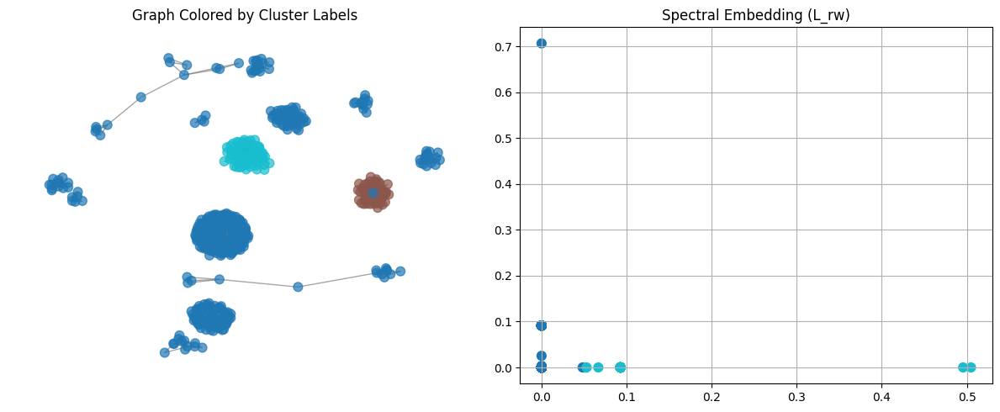

[INFO] Saved outputs for L_rw → C:\Users\LENOVO\Desktop\Spectral_Clustering\outputs\spectral_embedding\jaccard_binary__knn_k2\L_rw

=== Processing graph: jaccard_binary__knn_k4 ===
[SPECTRAL EMBEDDING] Laplacian: L
Embedding shape: (500, 3)
Eigenvalues (first 10): [-0. -0.  0.]
Cluster counts: [426  62  12]


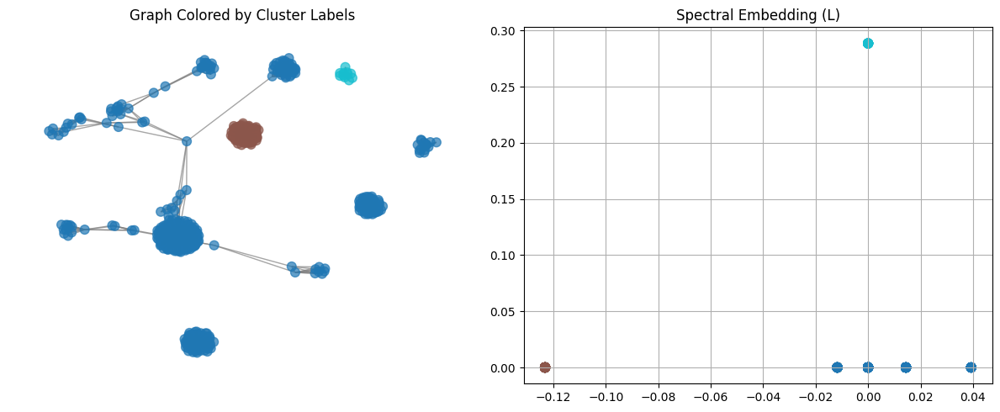

[INFO] Saved outputs for L → C:\Users\LENOVO\Desktop\Spectral_Clustering\outputs\spectral_embedding\jaccard_binary__knn_k4\L
[SPECTRAL EMBEDDING] Laplacian: L_sym
Embedding shape: (500, 3)
Eigenvalues (first 10): [-0.  0.  0.]
Cluster counts: [426  12  62]


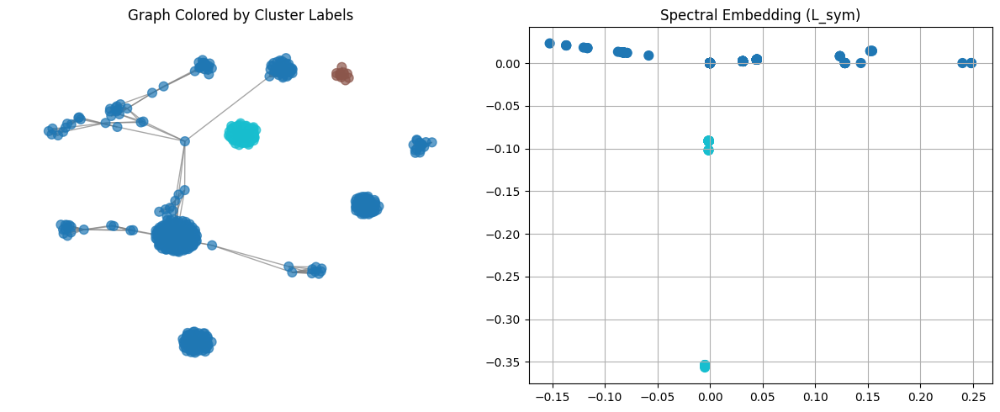

[INFO] Saved outputs for L_sym → C:\Users\LENOVO\Desktop\Spectral_Clustering\outputs\spectral_embedding\jaccard_binary__knn_k4\L_sym
[SPECTRAL EMBEDDING] Laplacian: L_rw
Embedding shape: (500, 3)
Eigenvalues (first 10): [-2.7393 -1.715  -1.4947]
Cluster counts: [404  60  36]


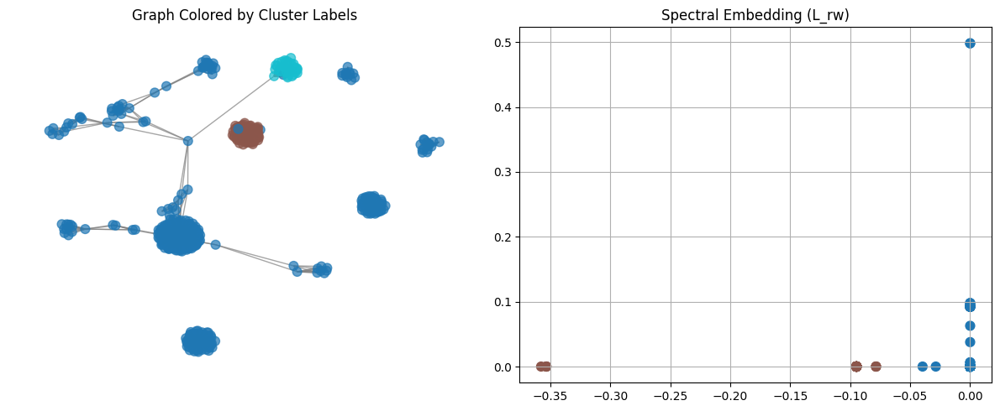

[INFO] Saved outputs for L_rw → C:\Users\LENOVO\Desktop\Spectral_Clustering\outputs\spectral_embedding\jaccard_binary__knn_k4\L_rw

=== Processing graph: jaccard_binary__knn_k6 ===
[SPECTRAL EMBEDDING] Laplacian: L
Embedding shape: (500, 3)
Eigenvalues (first 10): [-0.     -0.      0.0128]
Cluster counts: [185 251  64]


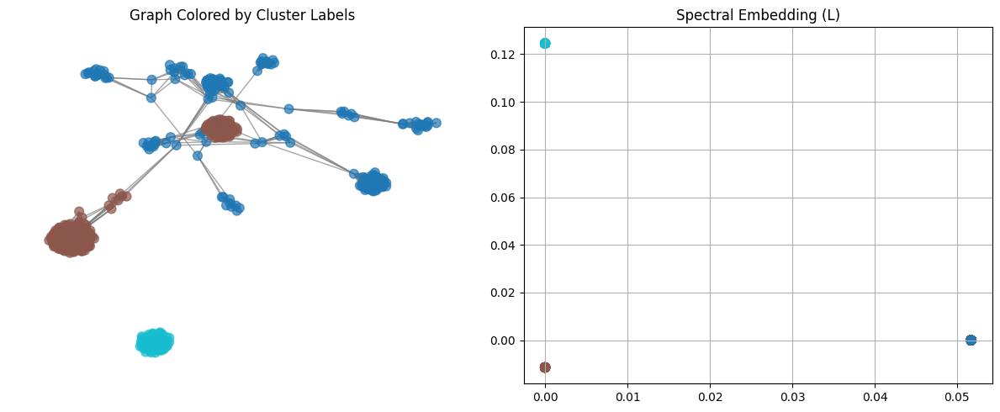

[INFO] Saved outputs for L → C:\Users\LENOVO\Desktop\Spectral_Clustering\outputs\spectral_embedding\jaccard_binary__knn_k6\L
[SPECTRAL EMBEDDING] Laplacian: L_sym
Embedding shape: (500, 3)
Eigenvalues (first 10): [0.     0.     0.0012]
Cluster counts: [253  62 185]


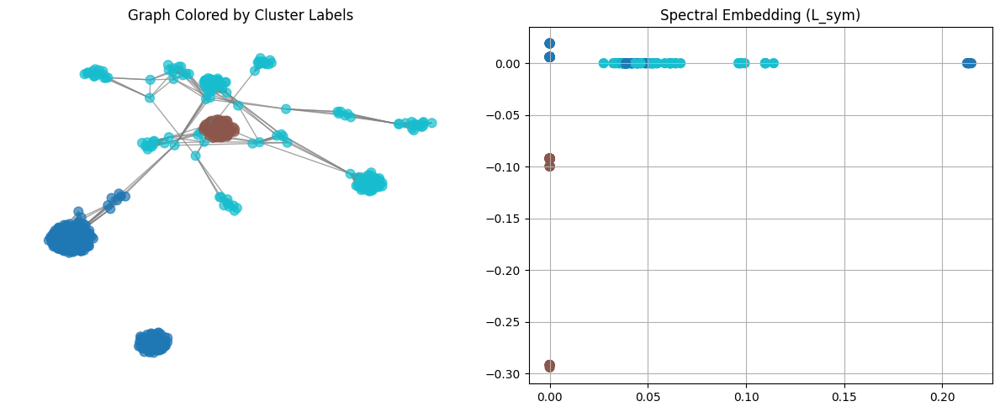

[INFO] Saved outputs for L_sym → C:\Users\LENOVO\Desktop\Spectral_Clustering\outputs\spectral_embedding\jaccard_binary__knn_k6\L_sym
[SPECTRAL EMBEDDING] Laplacian: L_rw
Embedding shape: (500, 3)
Eigenvalues (first 10): [-1.4706 -1.0473 -0.6654]
Cluster counts: [403  36  61]


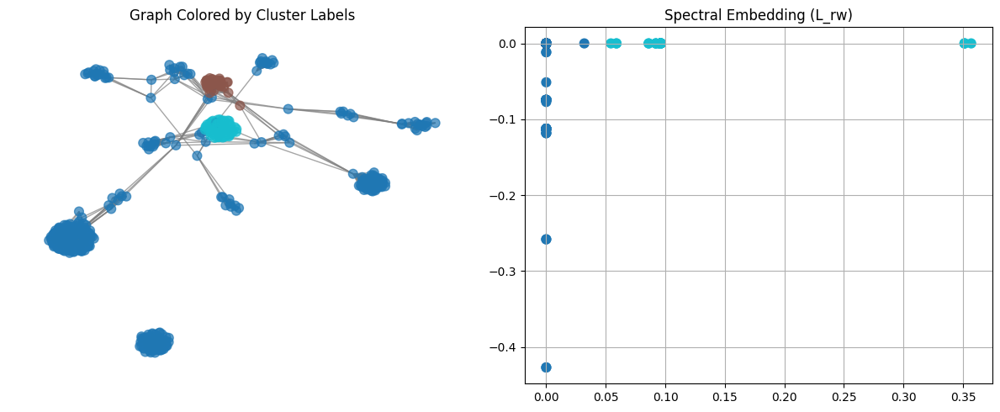

[INFO] Saved outputs for L_rw → C:\Users\LENOVO\Desktop\Spectral_Clustering\outputs\spectral_embedding\jaccard_binary__knn_k6\L_rw

=== Processing graph: jaccard_binary__threshold_t0.2 ===
[SPECTRAL EMBEDDING] Laplacian: L
Embedding shape: (500, 3)
Eigenvalues (first 10): [ 88.6217 159.9422 188.2964]
Cluster counts: [498   1   1]


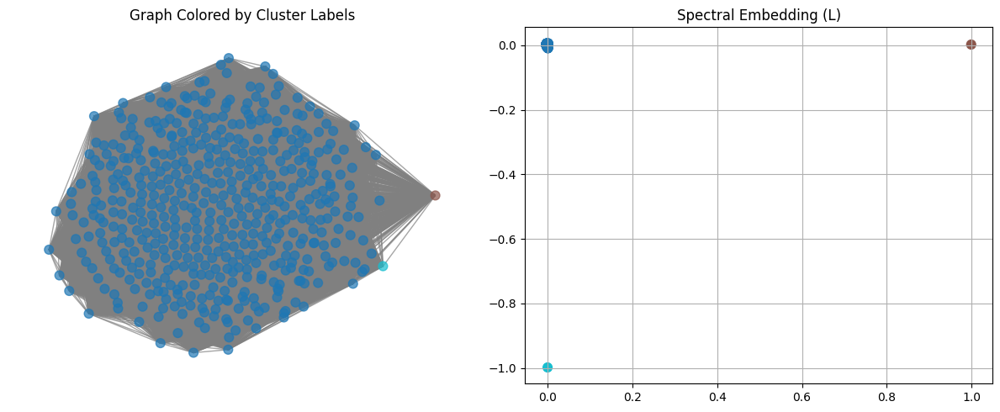

[INFO] Saved outputs for L → C:\Users\LENOVO\Desktop\Spectral_Clustering\outputs\spectral_embedding\jaccard_binary__threshold_t0.2\L
[SPECTRAL EMBEDDING] Laplacian: L_sym
Embedding shape: (500, 3)
Eigenvalues (first 10): [0.8869 0.8946 0.8966]
Cluster counts: [279  92 129]


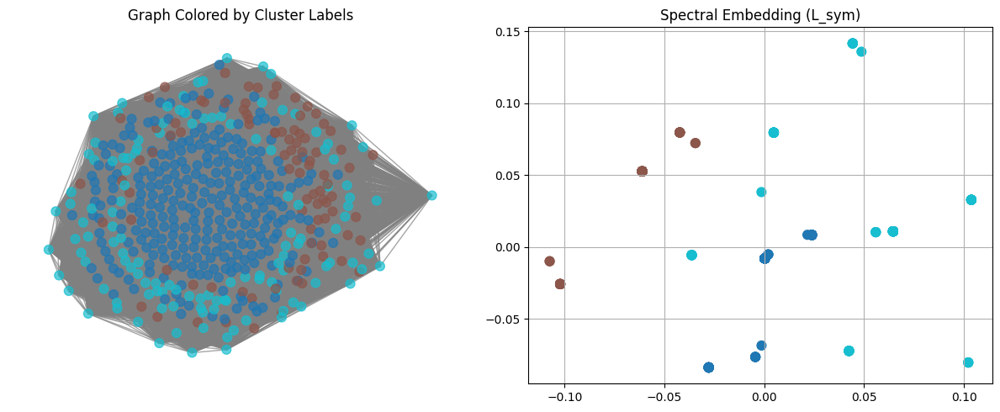

[INFO] Saved outputs for L_sym → C:\Users\LENOVO\Desktop\Spectral_Clustering\outputs\spectral_embedding\jaccard_binary__threshold_t0.2\L_sym
[SPECTRAL EMBEDDING] Laplacian: L_rw
Embedding shape: (500, 3)
Eigenvalues (first 10): [0.8864 0.8925 0.895 ]
Cluster counts: [279 129  92]


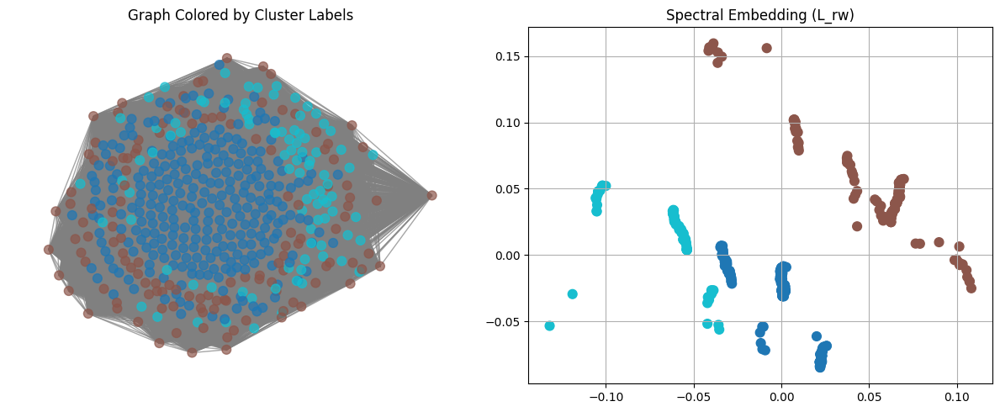

[INFO] Saved outputs for L_rw → C:\Users\LENOVO\Desktop\Spectral_Clustering\outputs\spectral_embedding\jaccard_binary__threshold_t0.2\L_rw

=== Processing graph: jaccard_binary__threshold_t0.4 ===
[SPECTRAL EMBEDDING] Laplacian: L
Embedding shape: (500, 3)
Eigenvalues (first 10): [10.4713 28.9675 95.607 ]
Cluster counts: [498   1   1]


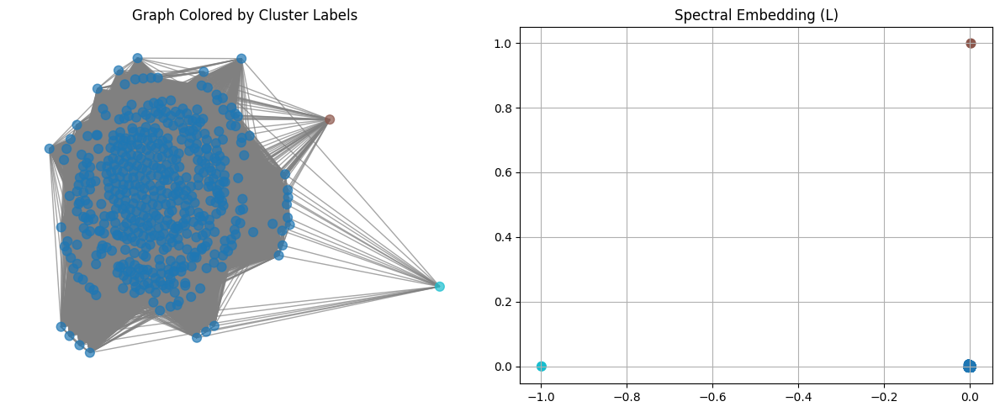

[INFO] Saved outputs for L → C:\Users\LENOVO\Desktop\Spectral_Clustering\outputs\spectral_embedding\jaccard_binary__threshold_t0.4\L
[SPECTRAL EMBEDDING] Laplacian: L_sym
Embedding shape: (500, 3)
Eigenvalues (first 10): [0.8072 0.8163 0.8197]
Cluster counts: [106 115 279]


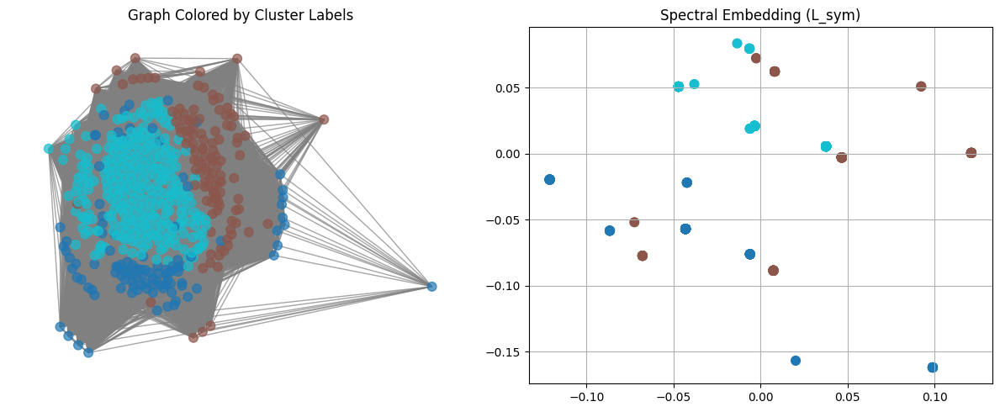

[INFO] Saved outputs for L_sym → C:\Users\LENOVO\Desktop\Spectral_Clustering\outputs\spectral_embedding\jaccard_binary__threshold_t0.4\L_sym
[SPECTRAL EMBEDDING] Laplacian: L_rw
Embedding shape: (500, 3)
Eigenvalues (first 10): [0.771  0.8013 0.817 ]
Cluster counts: [ 91 310  99]


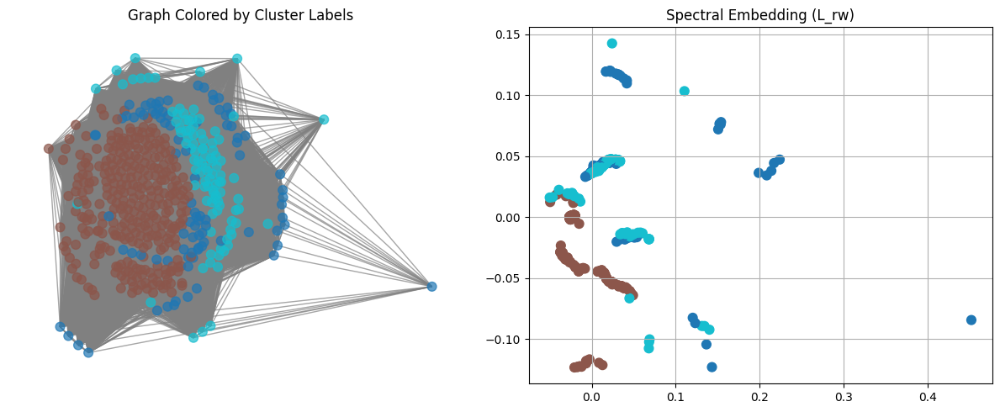

[INFO] Saved outputs for L_rw → C:\Users\LENOVO\Desktop\Spectral_Clustering\outputs\spectral_embedding\jaccard_binary__threshold_t0.4\L_rw

=== Processing graph: jaccard_binary__threshold_t0.6 ===
[SPECTRAL EMBEDDING] Laplacian: L
Embedding shape: (500, 3)
Eigenvalues (first 10): [0.     5.1839 6.5107]
Cluster counts: [498   1   1]


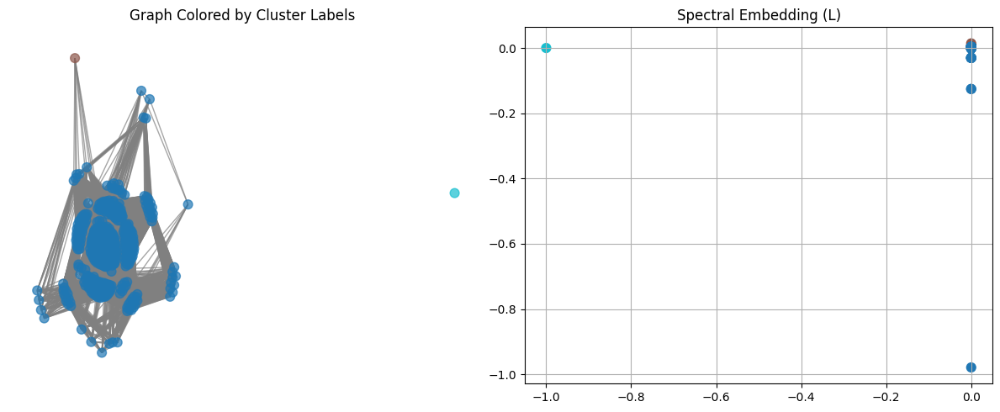

[INFO] Saved outputs for L → C:\Users\LENOVO\Desktop\Spectral_Clustering\outputs\spectral_embedding\jaccard_binary__threshold_t0.6\L
[SPECTRAL EMBEDDING] Laplacian: L_sym
Embedding shape: (500, 3)
Eigenvalues (first 10): [0.5598 0.5797 0.6026]
Cluster counts: [ 92 284 124]


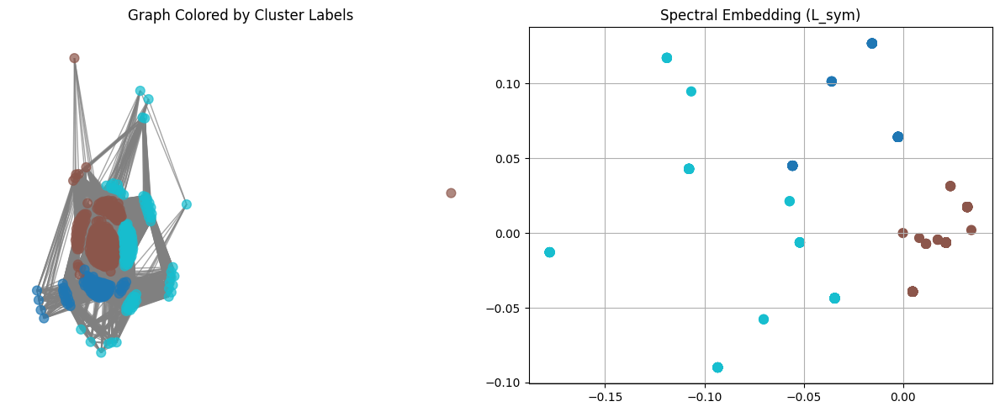

[INFO] Saved outputs for L_sym → C:\Users\LENOVO\Desktop\Spectral_Clustering\outputs\spectral_embedding\jaccard_binary__threshold_t0.6\L_sym
[SPECTRAL EMBEDDING] Laplacian: L_rw
Embedding shape: (500, 3)
Eigenvalues (first 10): [0.4819 0.5243 0.5532]
Cluster counts: [361 118  21]


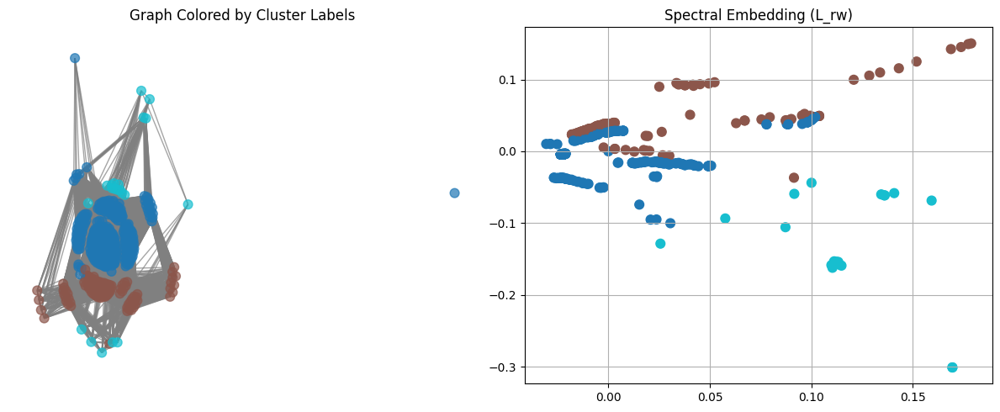

[INFO] Saved outputs for L_rw → C:\Users\LENOVO\Desktop\Spectral_Clustering\outputs\spectral_embedding\jaccard_binary__threshold_t0.6\L_rw


,graph_label,laplacian_type,eigenvalues_1to10,cluster_counts,embedding_shape
0,cosine__knn_k2,L,"[-8.576805133946016e-16, -6.918480567364413e-1...","[459, 37, 4]","(500, 3)"
1,cosine__knn_k2,L_sym,"[-3.370412758669001e-16, 4.5046462841318884e-1...","[439, 41, 20]","(500, 3)"
2,cosine__knn_k2,L_rw,"[-0.2980074954567997, -0.24802525151335464, -0...","[11, 483, 6]","(500, 3)"
3,cosine__knn_k4,L,"[0.018348021306592025, 0.11556481110783959, 0....","[411, 61, 28]","(500, 3)"
4,cosine__knn_k4,L_sym,"[0.003444630851596613, 0.022661164997178292, 0...","[411, 61, 28]","(500, 3)"
5,cosine__knn_k4,L_rw,"[-0.09353211091118518, -0.051498805005098465, ...","[24, 61, 415]","(500, 3)"
6,cosine__knn_k6,L,"[0.13251160849216712, 0.3583548667479894, 0.44...","[411, 61, 28]","(500, 3)"
7,cosine__knn_k6,L_sym,"[0.016587493446725665, 0.04805675979420468, 0....","[411, 61, 28]","(500, 3)"
8,cosine__knn_k6,L_rw,"[-0.01879244250602864, 0.00469369035840505, 0....","[307, 59, 134]","(500, 3)"
9,cosine__threshold_t0.2,L,"[357.82184387176665, 371.0867014191665, 373.40...","[498, 1, 1]","(500, 3)"


In [10]:
import pandas as pd
import numpy as np
from core.spectral import SpectralEmbeddingAnalysis

se = SpectralEmbeddingAnalysis(
    show_info=True,
    show_plots=True,
    k_neighbors=2,
)

explore_results = []
graph_results_dict = {}

for graph_label, graph_data in results.items():
    print(f"\n=== Processing graph: {graph_label} ===")

    L     = graph_data.get("L", None)
    L_sym = graph_data.get("L_sym", None)
    L_rw  = graph_data.get("L_rw", None)

    if L is not None or L_sym is not None or L_rw is not None:
        res = se.run(
            L=L,
            L_sym=L_sym,
            L_rw=L_rw,
            k=3,
            skip_first=True,
            seed=42,
            name=graph_label
        )
    else:
        res = se.run(
            A=graph_data["A"],
            k=3,
            skip_first=True,
            seed=42,
            name=graph_label
        )

    graph_results_dict[graph_label] = {
        "A": graph_data["A"],     
        **res                    
    }

    for lap_name, lap_res in res.items():
        if lap_name in ["S", "A", "D"]:
            continue

        explore_results.append({
            "graph_label": graph_label,
            "laplacian_type": lap_name,
            "eigenvalues_1to10": lap_res["vals"][:10],
            "cluster_counts": list(np.bincount(lap_res["labels"])),
            "embedding_shape": lap_res["U"].shape,
        })

df_explore = pd.DataFrame(explore_results)
pd.set_option("display.max_rows", None)
display(df_explore)

### Spectral Embedding Evaluation

In [11]:
from core.evaluation import GraphClusteringEvaluator
from utils import utils_spectral as utils

# Initialize evaluator
evaluator = GraphClusteringEvaluator(utils_module=utils)

eval_results = []

for graph_label, res_dict in graph_results_dict.items():
    metrics_dict = evaluator.evaluate_all_laplacians(res_dict, k=2)
    
    for lap_name, metrics in metrics_dict.items():
        eval_results.append({
            "graph_label": graph_label,
            "laplacian_type": lap_name,
            "spectral_gap": metrics.get("spectral_gap", np.nan),
            "silhouette": metrics.get("silhouette", np.nan),
            "modularity": metrics.get("modularity", np.nan),
            "conductance": metrics.get("conductance", np.nan)
        })

df_metrics = pd.DataFrame(eval_results)
pd.set_option("display.max_rows", None)
display(df_metrics)

,graph_label,laplacian_type,spectral_gap,silhouette,modularity,conductance
0,cosine__knn_k2,L,1.360828e-15,0.916961,1.505836e-01,NaN
1,cosine__knn_k2,L_sym,9.965438e-17,0.911436,2.211573e-01,NaN
2,cosine__knn_k2,L_rw,6.229879e-02,0.900521,5.538659e-02,NaN
3,cosine__knn_k4,L,8.508256e-02,0.648533,2.902787e-01,NaN
4,cosine__knn_k4,L_sym,1.468624e-02,0.631310,2.902787e-01,NaN
5,cosine__knn_k4,L_rw,1.677965e-02,0.673281,2.701232e-01,NaN
6,cosine__knn_k6,L,9.026841e-02,0.642859,2.814272e-01,NaN
7,cosine__knn_k6,L_sym,8.911350e-03,0.625479,2.814272e-01,NaN
8,cosine__knn_k6,L_rw,8.853897e-03,0.364559,4.580086e-01,NaN
9,cosine__threshold_t0.2,L,2.320253e+00,0.989157,-9.561144e-06,NaN


## Statistical Analysis

In [12]:
from importlib import reload
import core.statistics 
reload(core.statistics)

from core.statistics import GraphClusteringStatistics
# Initialize the statistics class
stats = GraphClusteringStatistics(df_metrics)

# Get overall summary
stats.print_summary()

[INFO] Dropped metric columns with all-NaN values: conductance


spectral_gap                           silhouette          \
                          mean      std     min      max       mean     std   
similarity_metric                                                             
correlation             0.8651   3.0165  0.0023  12.8360     0.5582  0.2824   
cosine                  0.4997   1.1550  0.0000   4.0479     0.5976  0.3029   
jaccard_binary          5.4143  16.6615  0.0000  66.6395     0.7204  0.1619   

                                  modularity                       
                      min     max       mean     std  min     max  
similarity_metric                                                  
correlation        0.2300  0.9816     0.1616  0.1641 -0.0  0.5272  
cosine             0.2377  0.9892     0.1312  0.1485 -0.0  0.4580  
jaccard_binary     0.5047  0.9901     0.1920  0.1844 -0.0  0.5845

spectral_gap                          silhouette          \
                            mean      std    min      max       mean     std   
construction_method                                                            
knn                       0.0588   0.1128  0.000   0.4446     0.6946  0.1442   
threshold                 4.4606  13.7346  0.002  66.6395     0.5562  0.3293   

                                    modularity                          
                        min     max       mean     std     min     max  
construction_method                                                     
knn                  0.3646  0.9326     0.2943  0.1336  0.0337  0.5845  
threshold            0.2300  0.9901     0.0289  0.0336 -0.0000  0.1278

spectral_gap                            \
                                              mean      std     min      max   
similarity_metric construction_method                                          
correlation       knn                       0.0266   0.0262  0.0023   0.0745   
                  threshold                 1.7037   4.2134  0.0078  12.8360   
cosine            knn                       0.0319   0.0367  0.0000   0.0903   
                  threshold                 0.9675   1.5301  0.0029   4.0479   
jaccard_binary    knn                       0.1179   0.1828  0.0000   0.4446   
                  threshold                10.7107  22.9512  0.0020  66.6395   

                                      silhouette                          \
                                            mean     std     min     max   
similarity_metric construction_method                                      
correlation       knn                     0.6261  0.1540  0.3983  0.9326   
                  threshold               0.4903  0.3680  0.2300  0.9816   
cosine            knn                     0.7017  0.1808  0.3646  0.9170   
                  threshold               0.4935  0.3714  0.2377  0.9892   
jaccard_binary    knn                     0.7561  0.0401  0.6872  0.8078   
                  threshold               0.6847  0.2264  0.5047  0.9901   

                                      modularity                          
                                            mean     std     min     max  
similarity_metric construction_method                                     
correlation       knn                     0.2903  0.1385  0.0337  0.5272  
                  threshold               0.0329  0.0284 -0.0000  0.0727  
cosine            knn                     0.2554  0.1102  0.0554  0.4580  
                  threshold               0.0071  0.0053 -0.0000  0.0109  
jaccard_binary    knn                     0.3373  0.1512  0.1318  0.5845  
                  threshold               0.0468  0.0439 -0.0000  0.1278

spectral_gap                           silhouette          \
                       mean      std     min      max       mean     std   
laplacian_type                                                             
L                    6.6993  16.5103  0.0000  66.6395     0.8481  0.1557   
L_rw                 0.0730   0.1340  0.0025   0.4446     0.5124  0.2461   
L_sym                0.0068   0.0072  0.0000   0.0229     0.5157  0.2220   

                               modularity                          
                   min     max       mean     std     min     max  
laplacian_type                                                     
L               0.6191  0.9901     0.1449  0.1700 -0.0000  0.5845  
L_rw            0.2306  0.9326     0.1586  0.1596  0.0104  0.4580  
L_sym           0.2300  0.9114     0.1813  0.1727  0.0106  0.5809

In [13]:
df_for_stats = stats.df.copy()

display(df_for_stats.head())

,graph_label,laplacian_type,spectral_gap,silhouette,modularity,similarity_metric,construction_method,param_name,param_value
0,cosine__knn_k2,L,1.360828e-15,0.916961,0.150584,cosine,knn,k,2.0
1,cosine__knn_k2,L_sym,9.965438e-17,0.911436,0.221157,cosine,knn,k,2.0
2,cosine__knn_k2,L_rw,6.229879e-02,0.900521,0.055387,cosine,knn,k,2.0
3,cosine__knn_k4,L,8.508256e-02,0.648533,0.290279,cosine,knn,k,4.0
4,cosine__knn_k4,L_sym,1.468624e-02,0.631310,0.290279,cosine,knn,k,4.0


### Analysis of variances (multivariate and univariate)

In [14]:
from core.statistics import GraphClusteringAnalysis, GraphClusteringANOVA, GraphClusteringMANOVA

In [15]:
manova = GraphClusteringMANOVA(df_for_stats)
manova.fit()
manova.print_summary()


=== MANOVA MODEL ===
Formula: spectral_gap + silhouette + modularity ~ similarity_metric + construction_method + laplacian_type

=== MULTIVARIATE TEST RESULTS ===
                  Multivariate linear model
                                                             
-------------------------------------------------------------
       Intercept        Value  Num DF  Den DF F Value  Pr > F
-------------------------------------------------------------
          Wilks' lambda 0.1007 3.0000 46.0000 136.9567 0.0000
         Pillai's trace 0.8993 3.0000 46.0000 136.9567 0.0000
 Hotelling-Lawley trace 8.9320 3.0000 46.0000 136.9567 0.0000
    Roy's greatest root 8.9320 3.0000 46.0000 136.9567 0.0000
-------------------------------------------------------------
                                                             
-------------------------------------------------------------
    similarity_metric    Value  Num DF  Den DF F Value Pr > F
------------------------------------------------

In [16]:
from core.statistics import GraphClusteringANOVA

anova = GraphClusteringANOVA(df_for_stats)
anova.fit()
anova.print_summary()


=== FOLLOW-UP ANOVA RESULTS ===

--- Metric: SPECTRAL_GAP ---
Model: spectral_gap ~ similarity_metric + construction_method + laplacian_type
                          sum_sq    df         F    PR(>F)
similarity_metric     269.888808   2.0  1.578734  0.216757
construction_method   261.574071   1.0  3.060193  0.086624
laplacian_type        532.204954   2.0  3.113172  0.053548
Residual             4102.863735  48.0       NaN       NaN

--- Metric: SILHOUETTE ---
Model: silhouette ~ similarity_metric + construction_method + laplacian_type
                       sum_sq    df          F    PR(>F)
similarity_metric    0.257707   2.0   3.507322  0.037871
construction_method  0.258813   1.0   7.044750  0.010751
laplacian_type       1.339669   2.0  18.232543  0.000001
Residual             1.763444  48.0        NaN       NaN

--- Metric: MODULARITY ---
Model: modularity ~ similarity_metric + construction_method + laplacian_type
                       sum_sq    df           F        PR(>F)
simila

### Further statistical analysis

In [17]:
from core.statistics import GraphClusteringAnalysis

# 1. Initialize the analysis class
analysis = GraphClusteringAnalysis(df_for_stats)

# 2. Post-hoc pairwise tests
analysis.tukey_posthoc(metric='modularity', factor='similarity_metric')

# 3. Effect sizes
analysis.compute_effect_sizes(metric='silhouette')


Tukey HSD for metric 'modularity' by factor 'similarity_metric':
      Multiple Comparison of Means - Tukey HSD, FWER=0.05       
   group1       group2     meandiff p-adj   lower  upper  reject
----------------------------------------------------------------
correlation         cosine  -0.0303 0.8483 -0.1642 0.1035  False
correlation jaccard_binary   0.0305 0.8473 -0.1034 0.1643  False
     cosine jaccard_binary   0.0608 0.5205  -0.073 0.1946  False
----------------------------------------------------------------

Effect sizes (partial eta squared) for metric 'silhouette':


,sum_sq,df,F,PR(>F),eta_sq
similarity_metric,0.257707,2.0,3.507322,0.037871,0.127505
construction_method,0.258813,1.0,7.044750,0.010751,0.127982
laplacian_type,1.339669,2.0,18.232543,0.000001,0.431718
Residual,1.763444,48.0,NaN,NaN,0.500000


,sum_sq,df,F,PR(>F),eta_sq
similarity_metric,0.257707,2.0,3.507322,0.037871,0.127505
construction_method,0.258813,1.0,7.044750,0.010751,0.127982
laplacian_type,1.339669,2.0,18.232543,0.000001,0.431718
Residual,1.763444,48.0,NaN,NaN,0.500000


In [19]:
metrics = ['spectral_gap', 'silhouette', 'modularity']
factors = ['similarity_metric', 'construction_method', 'laplacian_type']

analysis = GraphClusteringAnalysis(df_for_stats)

# Tukey HSD for all combinations
tukey_results = {}
for metric in metrics:
    for factor in factors:
        tukey_results[(metric, factor)] = analysis.tukey_posthoc(
            metric=metric,
            factor=factor
        )

# Effect sizes for all metrics
effect_sizes = {}
for metric in metrics:
    effect_sizes[metric] = analysis.compute_effect_sizes(metric=metric)



Tukey HSD for metric 'spectral_gap' by factor 'similarity_metric':
       Multiple Comparison of Means - Tukey HSD, FWER=0.05       
   group1       group2     meandiff p-adj   lower   upper  reject
-----------------------------------------------------------------
correlation         cosine  -0.3655 0.9931   -8.25  7.5191  False
correlation jaccard_binary   4.5491 0.3522 -3.3354 12.4337  False
     cosine jaccard_binary   4.9146 0.2972 -2.9699 12.7991  False
-----------------------------------------------------------------

Tukey HSD for metric 'spectral_gap' by factor 'construction_method':
 Multiple Comparison of Means - Tukey HSD, FWER=0.05 
group1   group2  meandiff p-adj   lower  upper reject
-----------------------------------------------------
   knn threshold   4.4018 0.1019 -0.9024 9.706  False
-----------------------------------------------------

Tukey HSD for metric 'spectral_gap' by factor 'laplacian_type':
Multiple Comparison of Means - Tukey HSD, FWER=0.05 
group1 group

,sum_sq,df,F,PR(>F),eta_sq
similarity_metric,269.888808,2.0,1.578734,0.216757,0.061721
construction_method,261.574071,1.0,3.060193,0.086624,0.059933
laplacian_type,532.204954,2.0,3.113172,0.053548,0.114821
Residual,4102.863735,48.0,NaN,NaN,0.500000



Effect sizes (partial eta squared) for metric 'silhouette':


,sum_sq,df,F,PR(>F),eta_sq
similarity_metric,0.257707,2.0,3.507322,0.037871,0.127505
construction_method,0.258813,1.0,7.044750,0.010751,0.127982
laplacian_type,1.339669,2.0,18.232543,0.000001,0.431718
Residual,1.763444,48.0,NaN,NaN,0.500000



Effect sizes (partial eta squared) for metric 'modularity':


,sum_sq,df,F,PR(>F),eta_sq
similarity_metric,0.033268,2.0,1.783182,1.790579e-01,0.069161
construction_method,0.950841,1.0,101.930172,1.850552e-13,0.679851
laplacian_type,0.012186,2.0,0.653157,5.249633e-01,0.026494
Residual,0.447761,48.0,NaN,NaN,0.500000


# Comparative Procedure for Conductance defined on bipartitions.


=== Processing graph: cosine__knn_k2 ===
[SPECTRAL EMBEDDING] Laplacian: L
Embedding shape: (500, 2)
Eigenvalues (first 10): [-0. -0.]
Cluster counts: [496   4]


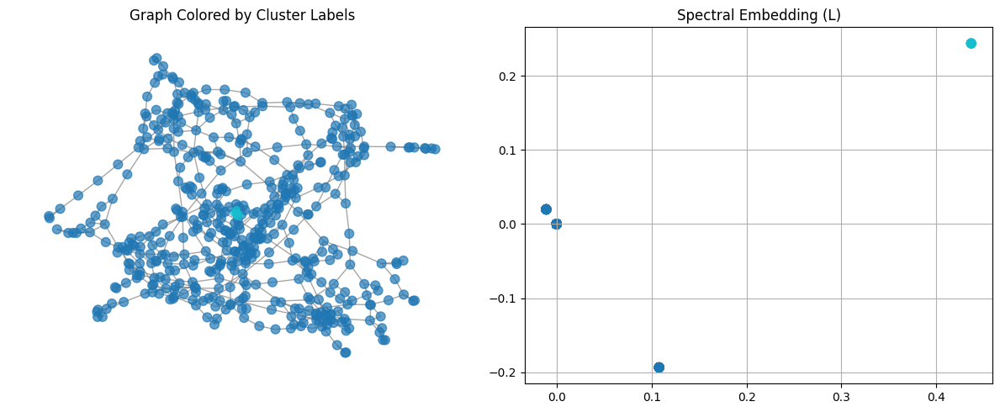

[INFO] Saved outputs for L → C:\Users\LENOVO\Desktop\Spectral_Clustering\outputs\spectral_embedding\cosine__knn_k2\L
[SPECTRAL EMBEDDING] Laplacian: L_sym
Embedding shape: (500, 2)
Eigenvalues (first 10): [-0.  0.]
Cluster counts: [456  44]


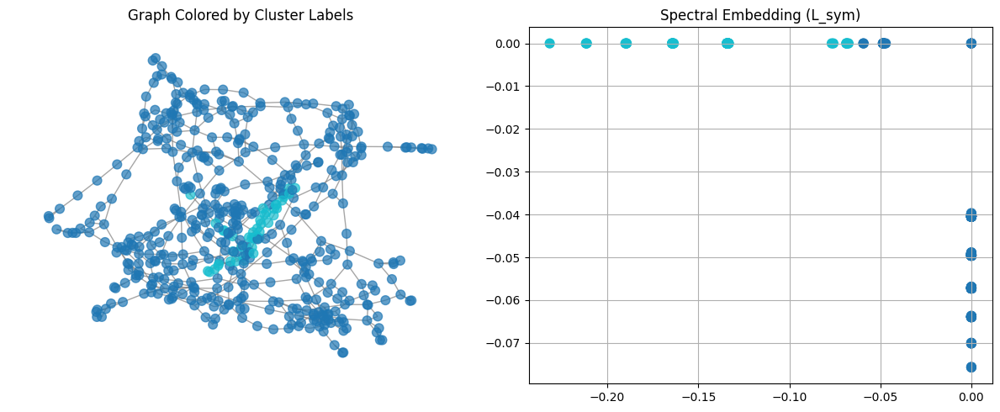

[INFO] Saved outputs for L_sym → C:\Users\LENOVO\Desktop\Spectral_Clustering\outputs\spectral_embedding\cosine__knn_k2\L_sym
[SPECTRAL EMBEDDING] Laplacian: L_rw
Embedding shape: (500, 2)
Eigenvalues (first 10): [-0.298 -0.248]
Cluster counts: [494   6]


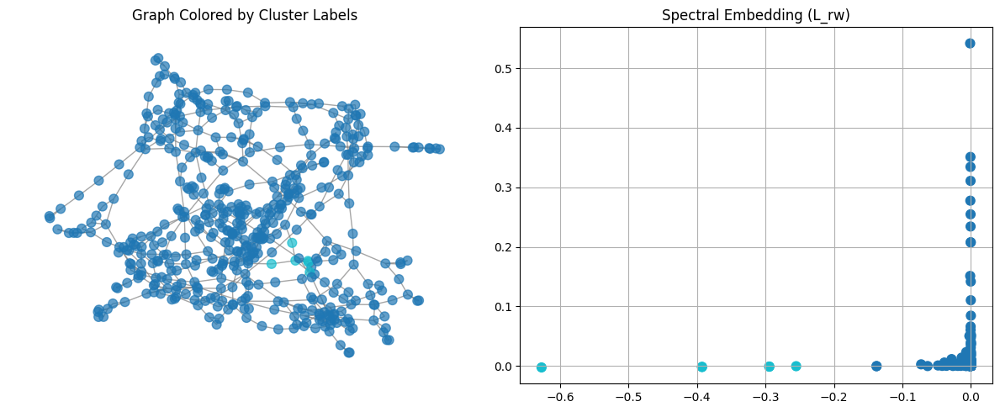

[INFO] Saved outputs for L_rw → C:\Users\LENOVO\Desktop\Spectral_Clustering\outputs\spectral_embedding\cosine__knn_k2\L_rw

=== Processing graph: cosine__knn_k4 ===
[SPECTRAL EMBEDDING] Laplacian: L
Embedding shape: (500, 2)
Eigenvalues (first 10): [0.0183 0.1156]
Cluster counts: [439  61]


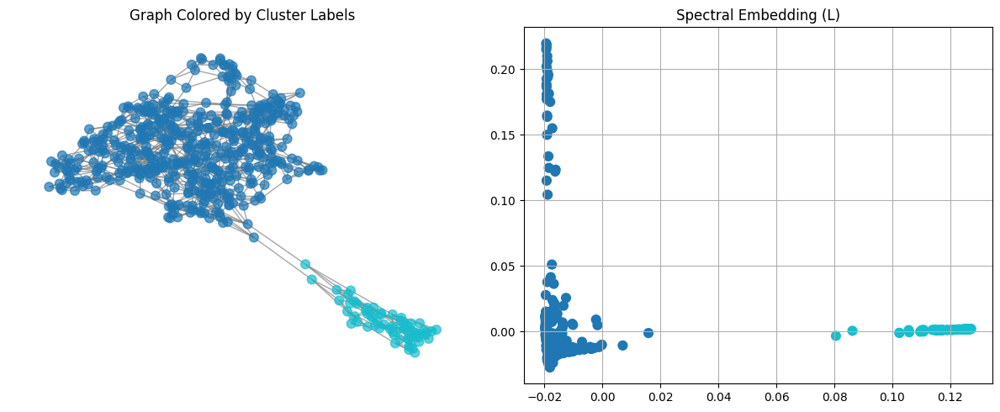

[INFO] Saved outputs for L → C:\Users\LENOVO\Desktop\Spectral_Clustering\outputs\spectral_embedding\cosine__knn_k4\L
[SPECTRAL EMBEDDING] Laplacian: L_sym
Embedding shape: (500, 2)
Eigenvalues (first 10): [0.0034 0.0227]
Cluster counts: [439  61]


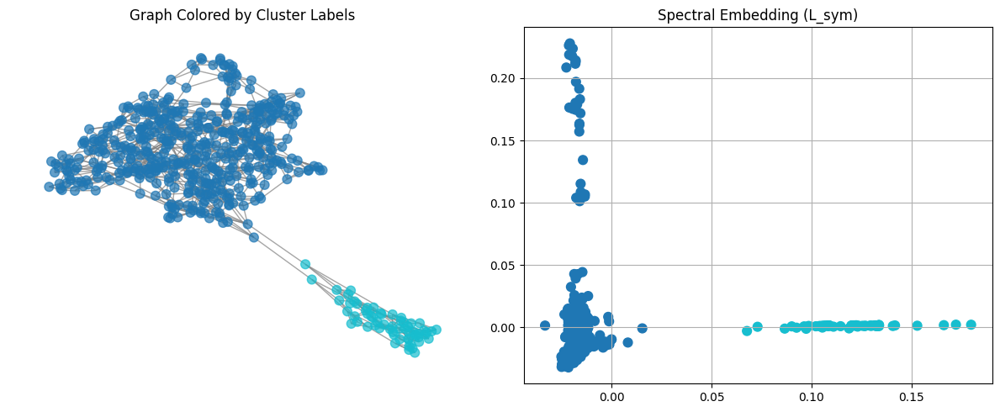

[INFO] Saved outputs for L_sym → C:\Users\LENOVO\Desktop\Spectral_Clustering\outputs\spectral_embedding\cosine__knn_k4\L_sym
[SPECTRAL EMBEDDING] Laplacian: L_rw
Embedding shape: (500, 2)
Eigenvalues (first 10): [-0.0935 -0.0515]
Cluster counts: [ 24 476]


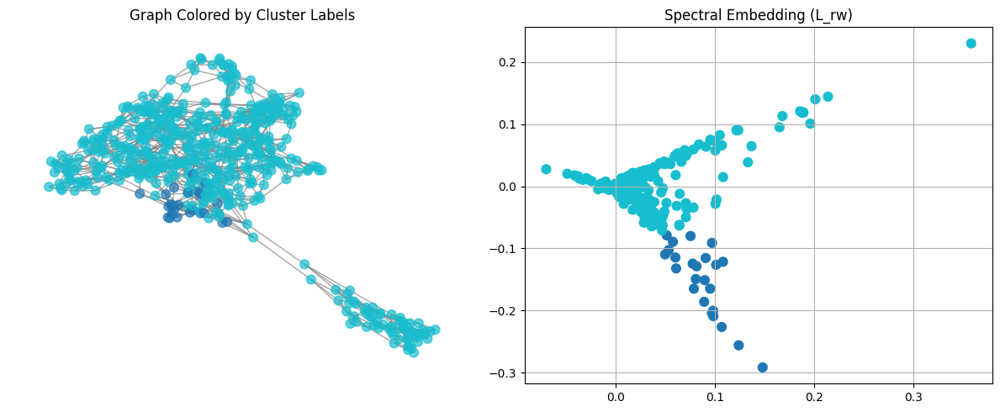

[INFO] Saved outputs for L_rw → C:\Users\LENOVO\Desktop\Spectral_Clustering\outputs\spectral_embedding\cosine__knn_k4\L_rw

=== Processing graph: cosine__knn_k6 ===
[SPECTRAL EMBEDDING] Laplacian: L
Embedding shape: (500, 2)
Eigenvalues (first 10): [0.1325 0.3584]
Cluster counts: [439  61]


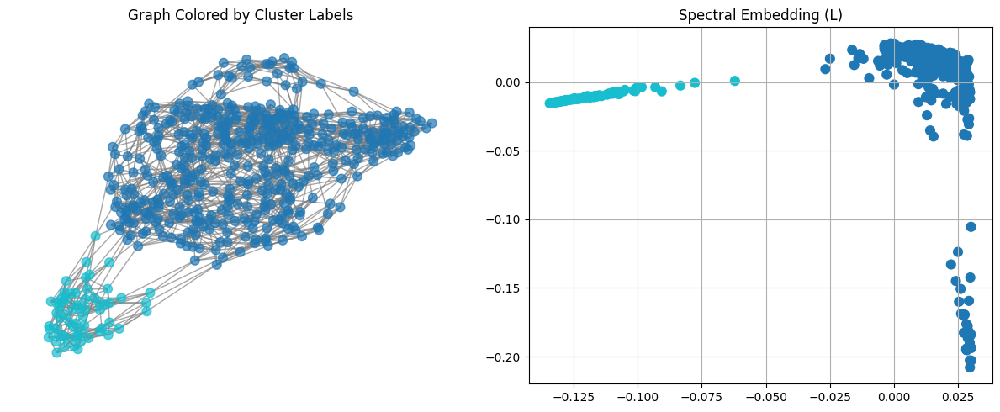

[INFO] Saved outputs for L → C:\Users\LENOVO\Desktop\Spectral_Clustering\outputs\spectral_embedding\cosine__knn_k6\L
[SPECTRAL EMBEDDING] Laplacian: L_sym
Embedding shape: (500, 2)
Eigenvalues (first 10): [0.0166 0.0481]
Cluster counts: [439  61]


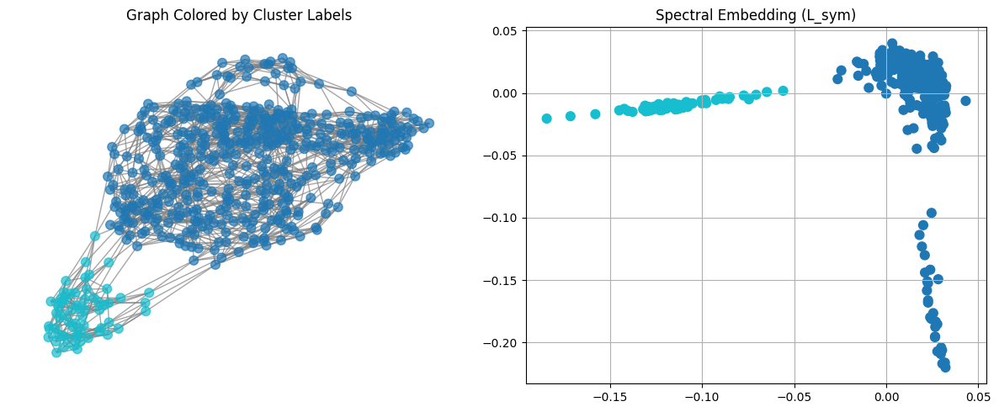

[INFO] Saved outputs for L_sym → C:\Users\LENOVO\Desktop\Spectral_Clustering\outputs\spectral_embedding\cosine__knn_k6\L_sym
[SPECTRAL EMBEDDING] Laplacian: L_rw
Embedding shape: (500, 2)
Eigenvalues (first 10): [-0.0188  0.0047]
Cluster counts: [442  58]


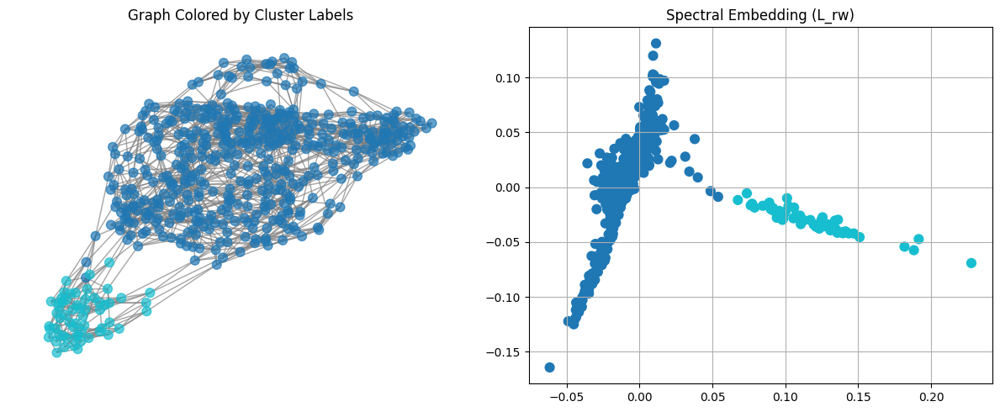

[INFO] Saved outputs for L_rw → C:\Users\LENOVO\Desktop\Spectral_Clustering\outputs\spectral_embedding\cosine__knn_k6\L_rw

=== Processing graph: cosine__threshold_t0.2 ===
[SPECTRAL EMBEDDING] Laplacian: L
Embedding shape: (500, 2)
Eigenvalues (first 10): [357.8218 371.0867]
Cluster counts: [499   1]


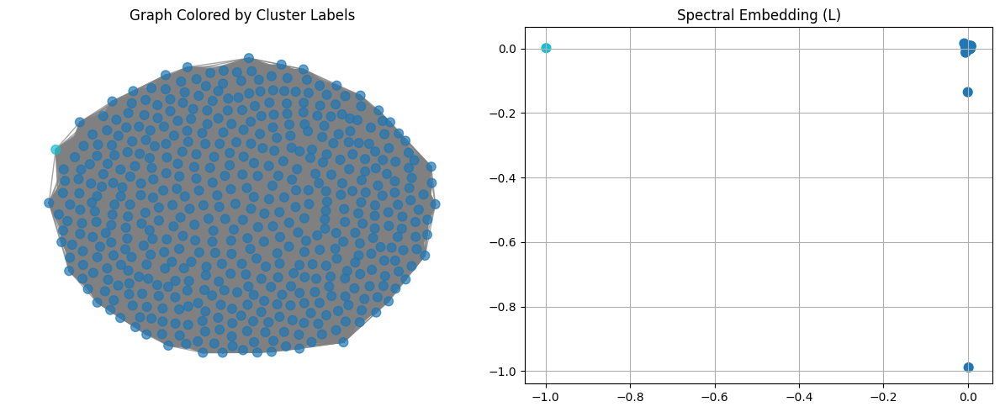

[INFO] Saved outputs for L → C:\Users\LENOVO\Desktop\Spectral_Clustering\outputs\spectral_embedding\cosine__threshold_t0.2\L
[SPECTRAL EMBEDDING] Laplacian: L_sym
Embedding shape: (500, 2)
Eigenvalues (first 10): [0.9584 0.9807]
Cluster counts: [185 315]


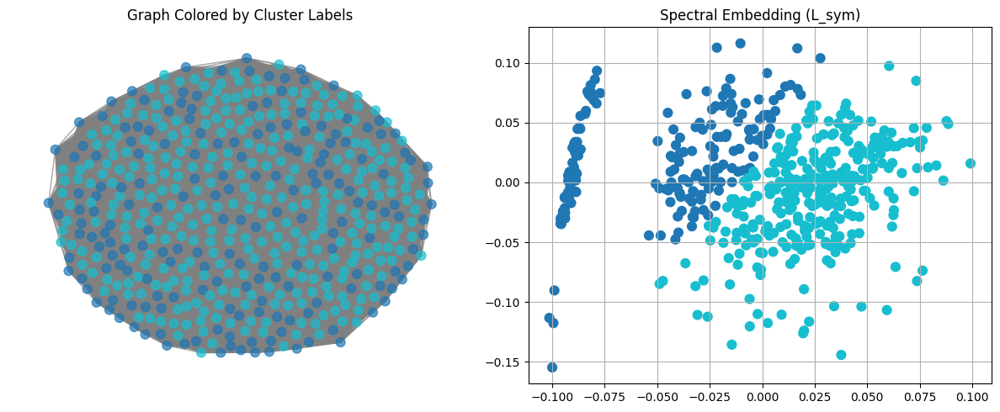

[INFO] Saved outputs for L_sym → C:\Users\LENOVO\Desktop\Spectral_Clustering\outputs\spectral_embedding\cosine__threshold_t0.2\L_sym
[SPECTRAL EMBEDDING] Laplacian: L_rw
Embedding shape: (500, 2)
Eigenvalues (first 10): [0.9584 0.9806]
Cluster counts: [314 186]


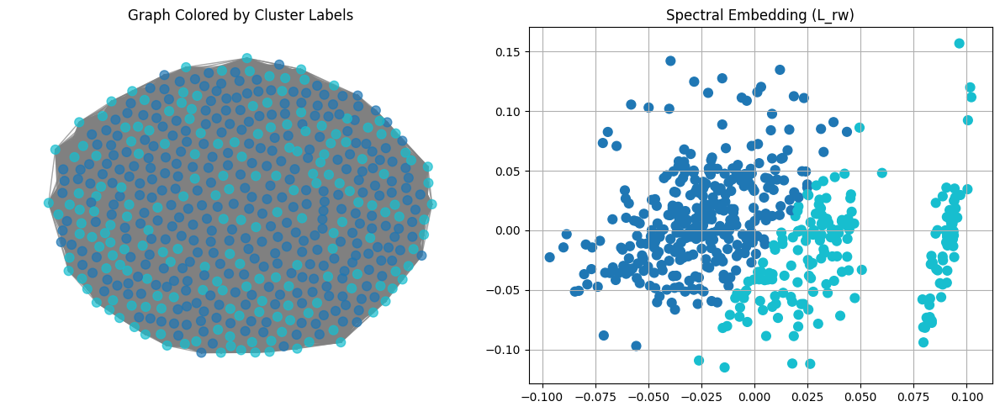

[INFO] Saved outputs for L_rw → C:\Users\LENOVO\Desktop\Spectral_Clustering\outputs\spectral_embedding\cosine__threshold_t0.2\L_rw

=== Processing graph: cosine__threshold_t0.4 ===
[SPECTRAL EMBEDDING] Laplacian: L
Embedding shape: (500, 2)
Eigenvalues (first 10): [357.8218 371.0867]
Cluster counts: [499   1]


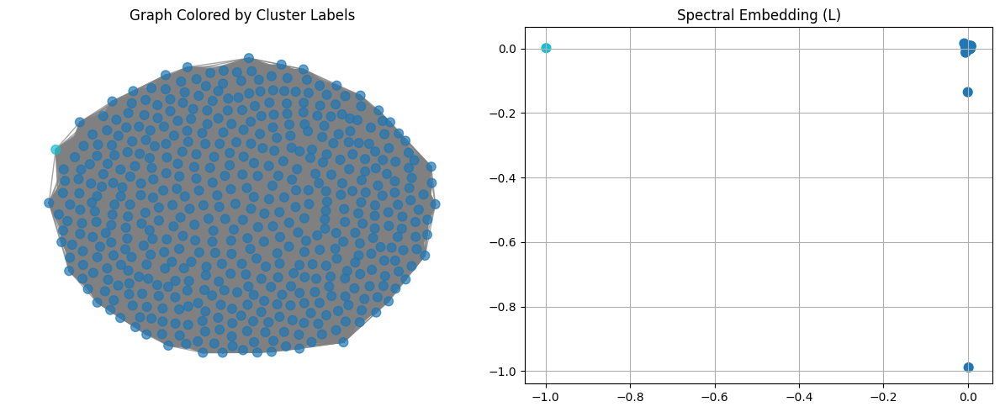

[INFO] Saved outputs for L → C:\Users\LENOVO\Desktop\Spectral_Clustering\outputs\spectral_embedding\cosine__threshold_t0.4\L
[SPECTRAL EMBEDDING] Laplacian: L_sym
Embedding shape: (500, 2)
Eigenvalues (first 10): [0.9584 0.9807]
Cluster counts: [185 315]


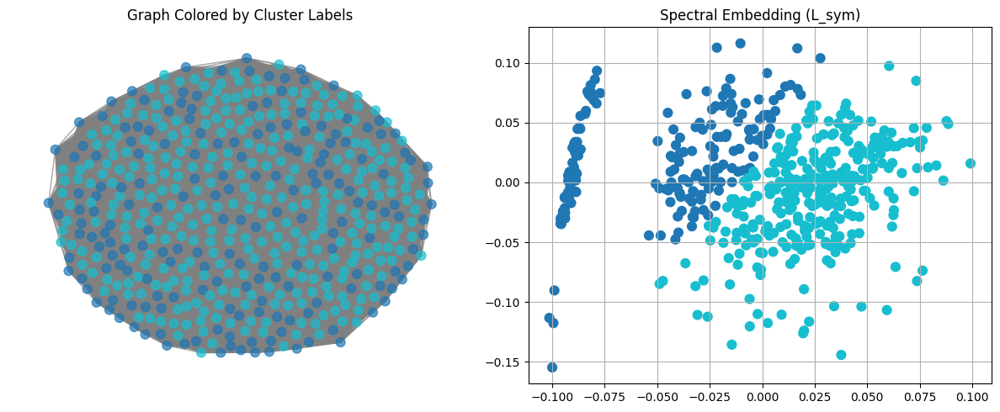

[INFO] Saved outputs for L_sym → C:\Users\LENOVO\Desktop\Spectral_Clustering\outputs\spectral_embedding\cosine__threshold_t0.4\L_sym
[SPECTRAL EMBEDDING] Laplacian: L_rw
Embedding shape: (500, 2)
Eigenvalues (first 10): [0.9584 0.9806]
Cluster counts: [314 186]


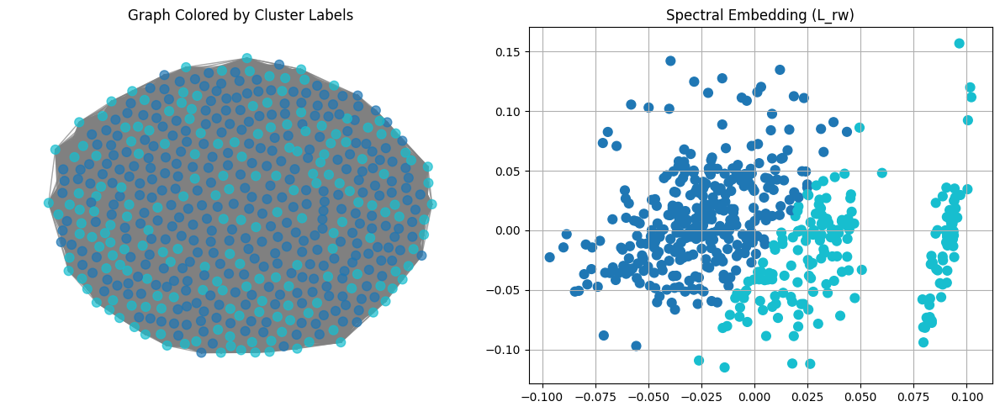

[INFO] Saved outputs for L_rw → C:\Users\LENOVO\Desktop\Spectral_Clustering\outputs\spectral_embedding\cosine__threshold_t0.4\L_rw

=== Processing graph: cosine__threshold_t0.6 ===
[SPECTRAL EMBEDDING] Laplacian: L
Embedding shape: (500, 2)
Eigenvalues (first 10): [322.6711 354.4453]
Cluster counts: [499   1]


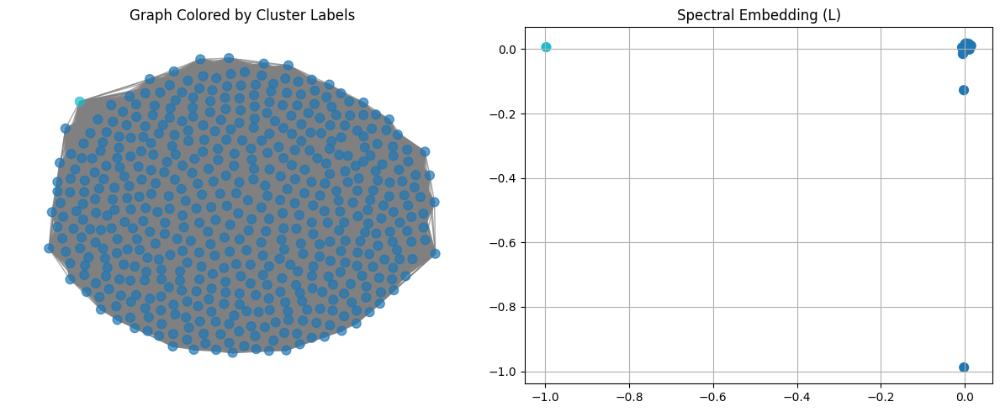

[INFO] Saved outputs for L → C:\Users\LENOVO\Desktop\Spectral_Clustering\outputs\spectral_embedding\cosine__threshold_t0.6\L
[SPECTRAL EMBEDDING] Laplacian: L_sym
Embedding shape: (500, 2)
Eigenvalues (first 10): [0.9528 0.9767]
Cluster counts: [176 324]


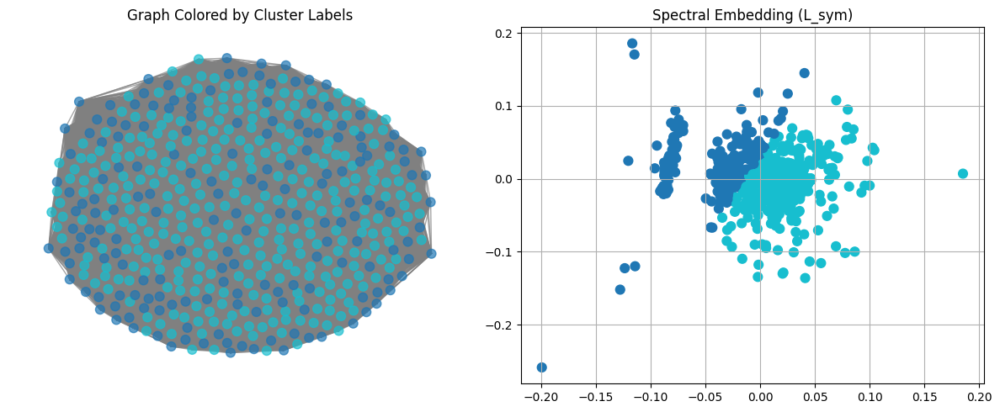

[INFO] Saved outputs for L_sym → C:\Users\LENOVO\Desktop\Spectral_Clustering\outputs\spectral_embedding\cosine__threshold_t0.6\L_sym
[SPECTRAL EMBEDDING] Laplacian: L_rw
Embedding shape: (500, 2)
Eigenvalues (first 10): [0.9529 0.9765]
Cluster counts: [181 319]


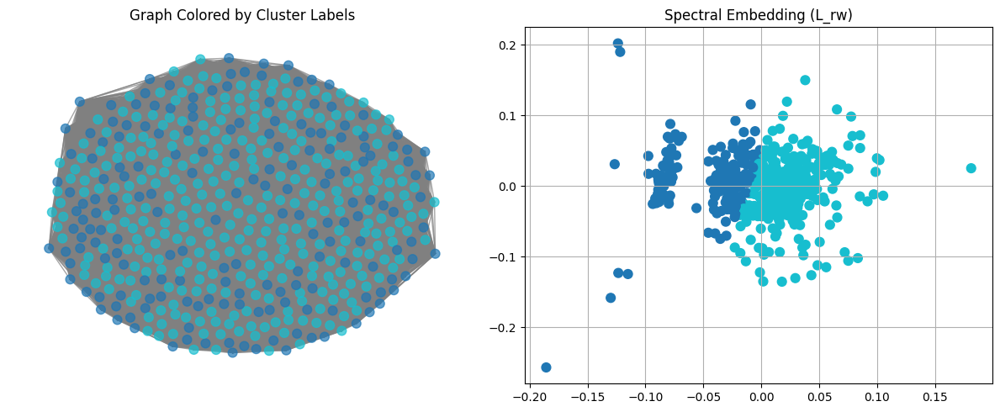

[INFO] Saved outputs for L_rw → C:\Users\LENOVO\Desktop\Spectral_Clustering\outputs\spectral_embedding\cosine__threshold_t0.6\L_rw

=== Processing graph: correlation__knn_k2 ===
[SPECTRAL EMBEDDING] Laplacian: L
Embedding shape: (500, 2)
Eigenvalues (first 10): [0.     0.0077]
Cluster counts: [497   3]


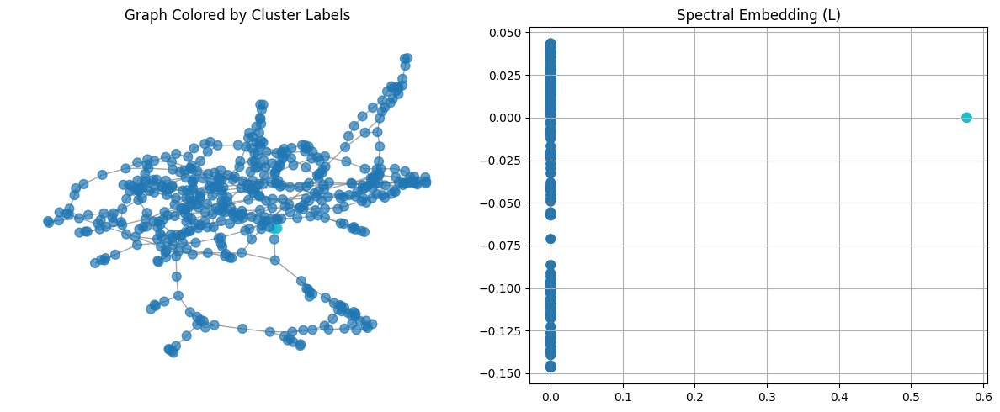

[INFO] Saved outputs for L → C:\Users\LENOVO\Desktop\Spectral_Clustering\outputs\spectral_embedding\correlation__knn_k2\L
[SPECTRAL EMBEDDING] Laplacian: L_sym
Embedding shape: (500, 2)
Eigenvalues (first 10): [-0.      0.0028]
Cluster counts: [436  64]


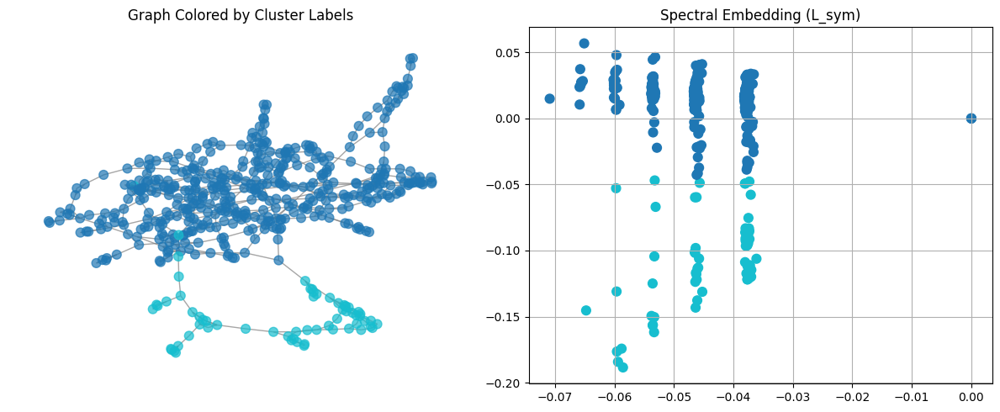

[INFO] Saved outputs for L_sym → C:\Users\LENOVO\Desktop\Spectral_Clustering\outputs\spectral_embedding\correlation__knn_k2\L_sym
[SPECTRAL EMBEDDING] Laplacian: L_rw
Embedding shape: (500, 2)
Eigenvalues (first 10): [-0.3145 -0.2589]
Cluster counts: [494   6]


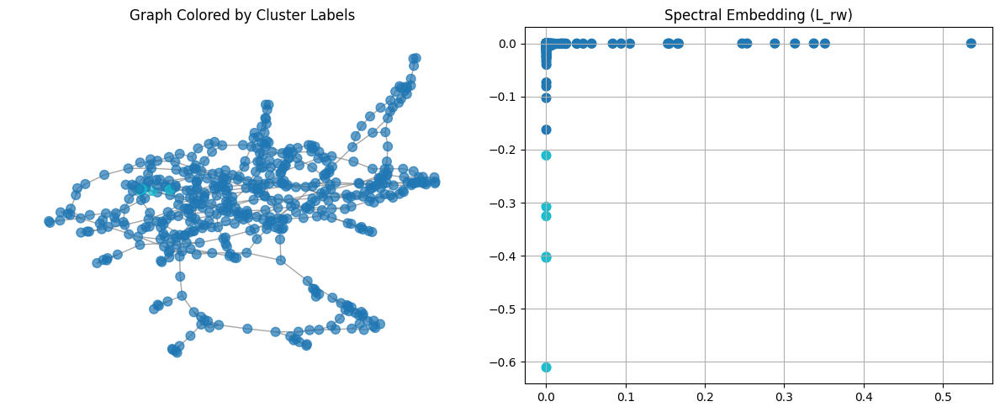

[INFO] Saved outputs for L_rw → C:\Users\LENOVO\Desktop\Spectral_Clustering\outputs\spectral_embedding\correlation__knn_k2\L_rw

=== Processing graph: correlation__knn_k4 ===
[SPECTRAL EMBEDDING] Laplacian: L
Embedding shape: (500, 2)
Eigenvalues (first 10): [0.0519 0.1357]
Cluster counts: [439  61]


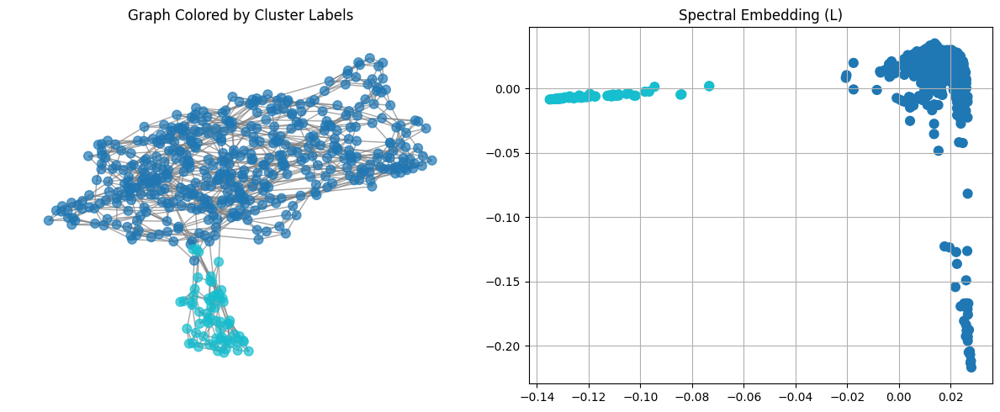

[INFO] Saved outputs for L → C:\Users\LENOVO\Desktop\Spectral_Clustering\outputs\spectral_embedding\correlation__knn_k4\L
[SPECTRAL EMBEDDING] Laplacian: L_sym
Embedding shape: (500, 2)
Eigenvalues (first 10): [0.0098 0.0271]
Cluster counts: [439  61]


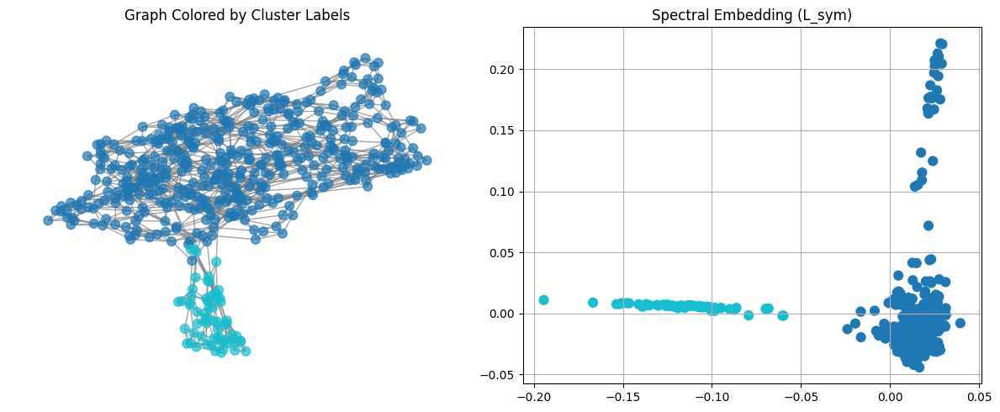

[INFO] Saved outputs for L_sym → C:\Users\LENOVO\Desktop\Spectral_Clustering\outputs\spectral_embedding\correlation__knn_k4\L_sym
[SPECTRAL EMBEDDING] Laplacian: L_rw
Embedding shape: (500, 2)
Eigenvalues (first 10): [-0.0623 -0.052 ]
Cluster counts: [443  57]


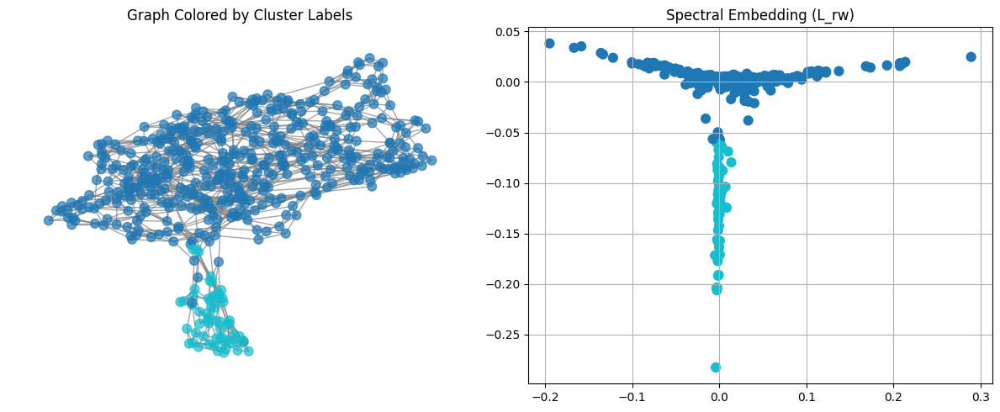

[INFO] Saved outputs for L_rw → C:\Users\LENOVO\Desktop\Spectral_Clustering\outputs\spectral_embedding\correlation__knn_k4\L_rw

=== Processing graph: correlation__knn_k6 ===
[SPECTRAL EMBEDDING] Laplacian: L
Embedding shape: (500, 2)
Eigenvalues (first 10): [0.1692 0.3844]
Cluster counts: [472  28]


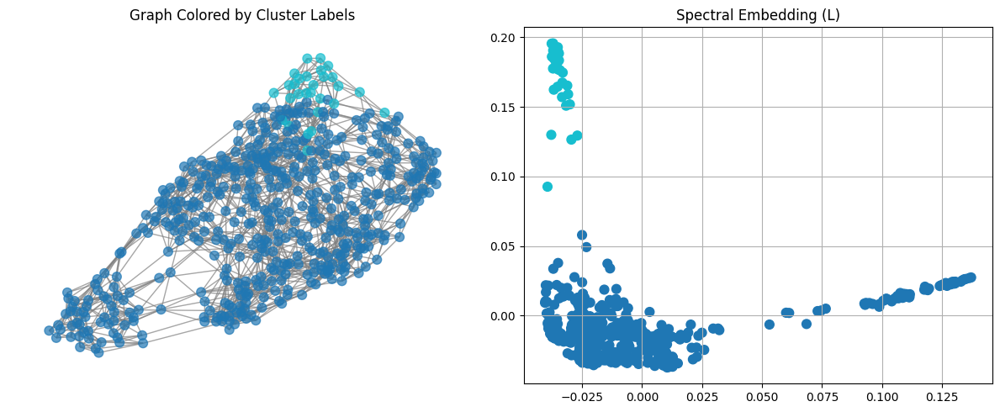

[INFO] Saved outputs for L → C:\Users\LENOVO\Desktop\Spectral_Clustering\outputs\spectral_embedding\correlation__knn_k6\L
[SPECTRAL EMBEDDING] Laplacian: L_sym
Embedding shape: (500, 2)
Eigenvalues (first 10): [0.0217 0.0523]
Cluster counts: [416  84]


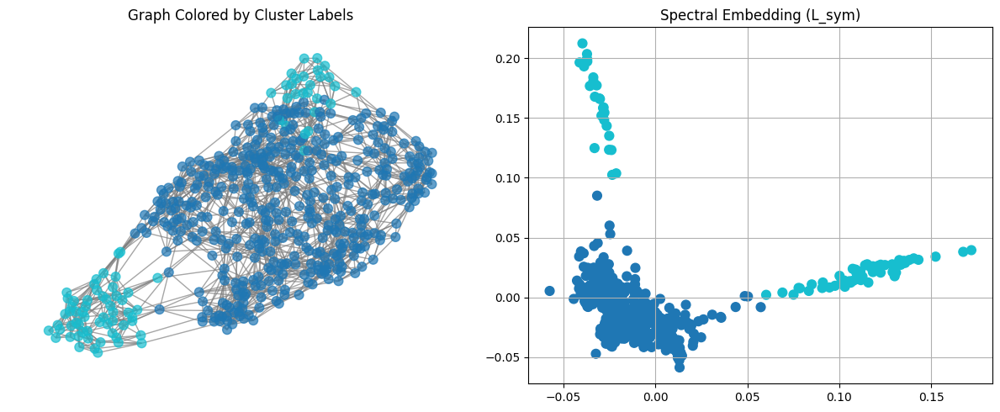

[INFO] Saved outputs for L_sym → C:\Users\LENOVO\Desktop\Spectral_Clustering\outputs\spectral_embedding\correlation__knn_k6\L_sym
[SPECTRAL EMBEDDING] Laplacian: L_rw
Embedding shape: (500, 2)
Eigenvalues (first 10): [-0.0052  0.0217]
Cluster counts: [443  57]


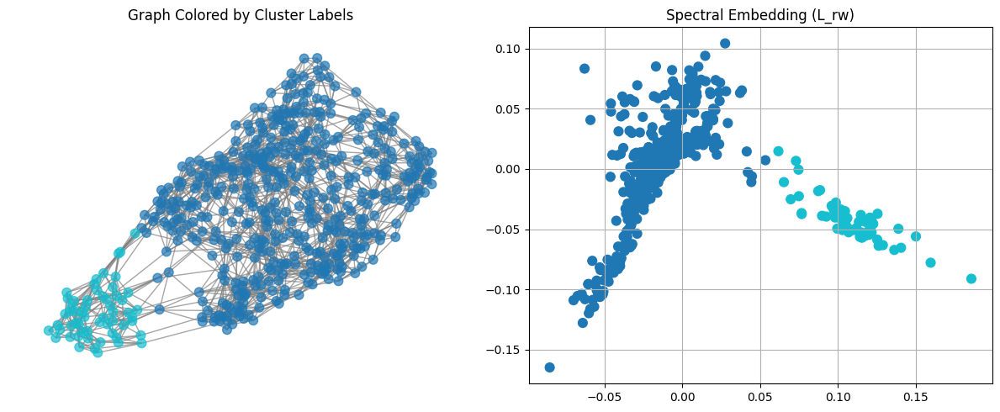

[INFO] Saved outputs for L_rw → C:\Users\LENOVO\Desktop\Spectral_Clustering\outputs\spectral_embedding\correlation__knn_k6\L_rw

=== Processing graph: correlation__threshold_t0.2 ===
[SPECTRAL EMBEDDING] Laplacian: L
Embedding shape: (500, 2)
Eigenvalues (first 10): [233.2999 241.2803]
Cluster counts: [499   1]


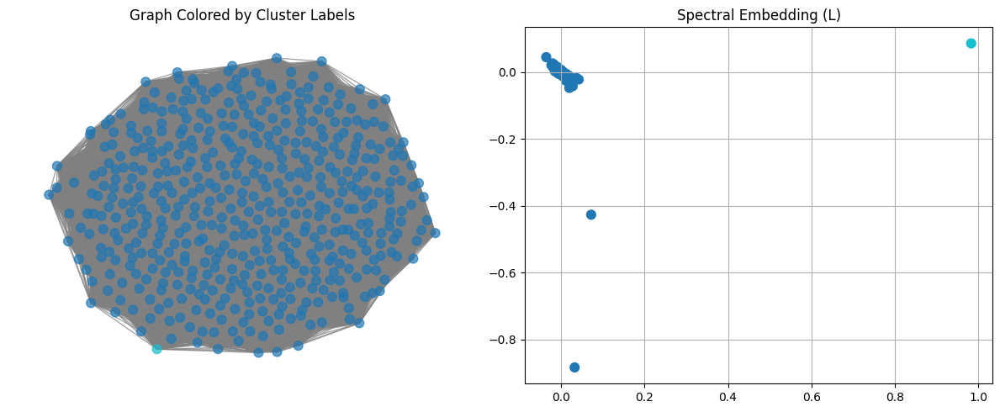

[INFO] Saved outputs for L → C:\Users\LENOVO\Desktop\Spectral_Clustering\outputs\spectral_embedding\correlation__threshold_t0.2\L
[SPECTRAL EMBEDDING] Laplacian: L_sym
Embedding shape: (500, 2)
Eigenvalues (first 10): [0.8497 0.9314]
Cluster counts: [315 185]


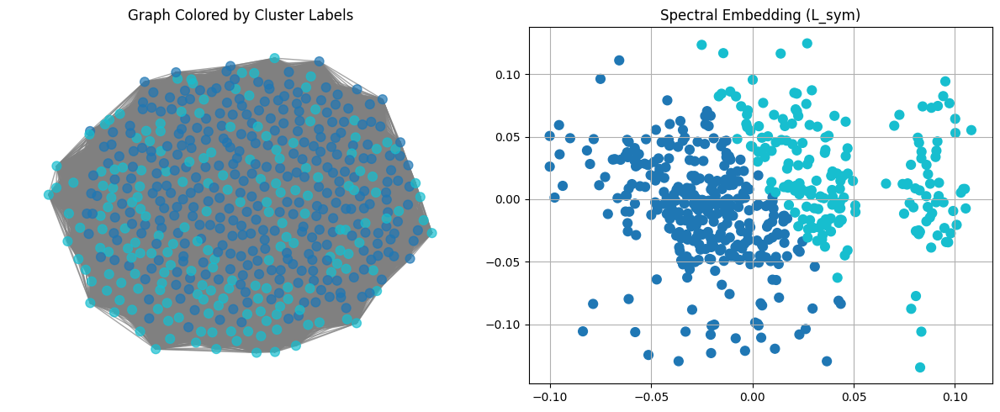

[INFO] Saved outputs for L_sym → C:\Users\LENOVO\Desktop\Spectral_Clustering\outputs\spectral_embedding\correlation__threshold_t0.2\L_sym
[SPECTRAL EMBEDDING] Laplacian: L_rw
Embedding shape: (500, 2)
Eigenvalues (first 10): [0.849  0.9312]
Cluster counts: [186 314]


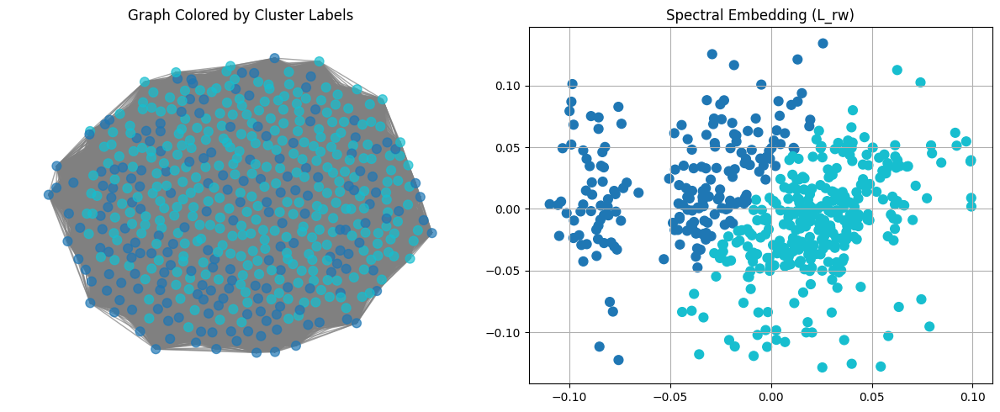

[INFO] Saved outputs for L_rw → C:\Users\LENOVO\Desktop\Spectral_Clustering\outputs\spectral_embedding\correlation__threshold_t0.2\L_rw

=== Processing graph: correlation__threshold_t0.4 ===
[SPECTRAL EMBEDDING] Laplacian: L
Embedding shape: (500, 2)
Eigenvalues (first 10): [186.0994 203.967 ]
Cluster counts: [499   1]


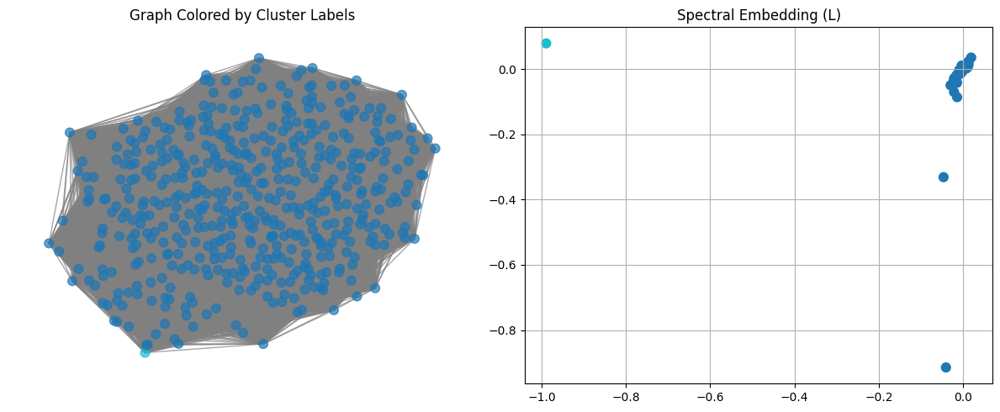

[INFO] Saved outputs for L → C:\Users\LENOVO\Desktop\Spectral_Clustering\outputs\spectral_embedding\correlation__threshold_t0.4\L
[SPECTRAL EMBEDDING] Laplacian: L_sym
Embedding shape: (500, 2)
Eigenvalues (first 10): [0.8012 0.914 ]
Cluster counts: [318 182]


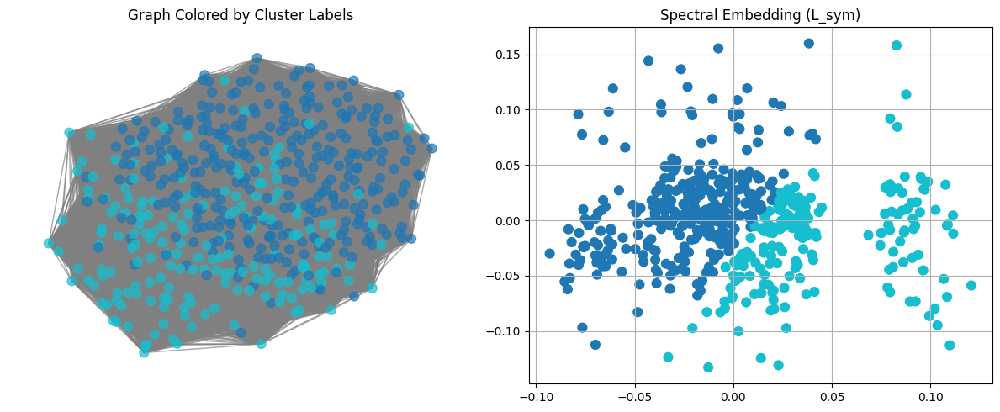

[INFO] Saved outputs for L_sym → C:\Users\LENOVO\Desktop\Spectral_Clustering\outputs\spectral_embedding\correlation__threshold_t0.4\L_sym
[SPECTRAL EMBEDDING] Laplacian: L_rw
Embedding shape: (500, 2)
Eigenvalues (first 10): [0.7992 0.9136]
Cluster counts: [185 315]


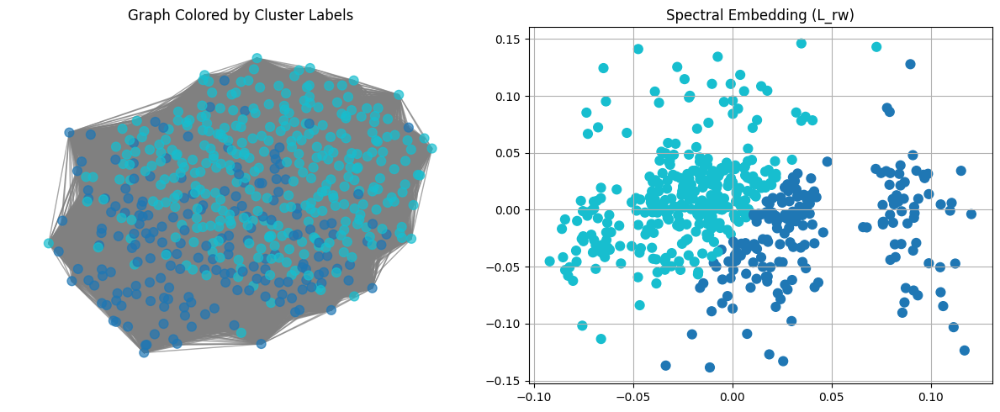

[INFO] Saved outputs for L_rw → C:\Users\LENOVO\Desktop\Spectral_Clustering\outputs\spectral_embedding\correlation__threshold_t0.4\L_rw

=== Processing graph: correlation__threshold_t0.6 ===
[SPECTRAL EMBEDDING] Laplacian: L
Embedding shape: (500, 2)
Eigenvalues (first 10): [102.7918 106.0758]
Cluster counts: [499   1]


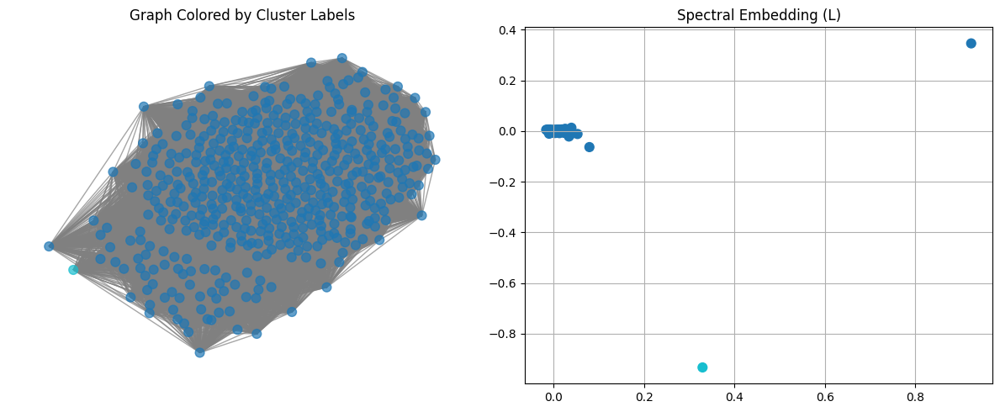

[INFO] Saved outputs for L → C:\Users\LENOVO\Desktop\Spectral_Clustering\outputs\spectral_embedding\correlation__threshold_t0.6\L
[SPECTRAL EMBEDDING] Laplacian: L_sym
Embedding shape: (500, 2)
Eigenvalues (first 10): [0.6589 0.8423]
Cluster counts: [315 185]


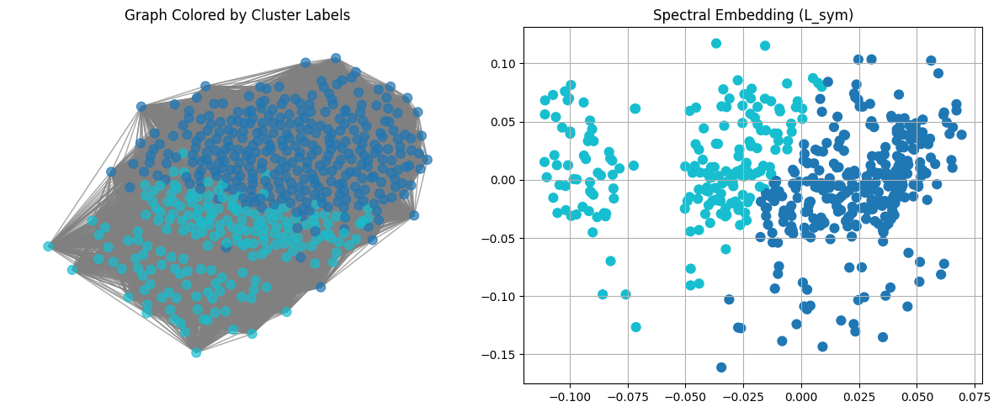

[INFO] Saved outputs for L_sym → C:\Users\LENOVO\Desktop\Spectral_Clustering\outputs\spectral_embedding\correlation__threshold_t0.6\L_sym
[SPECTRAL EMBEDDING] Laplacian: L_rw
Embedding shape: (500, 2)
Eigenvalues (first 10): [0.6455 0.8395]
Cluster counts: [315 185]


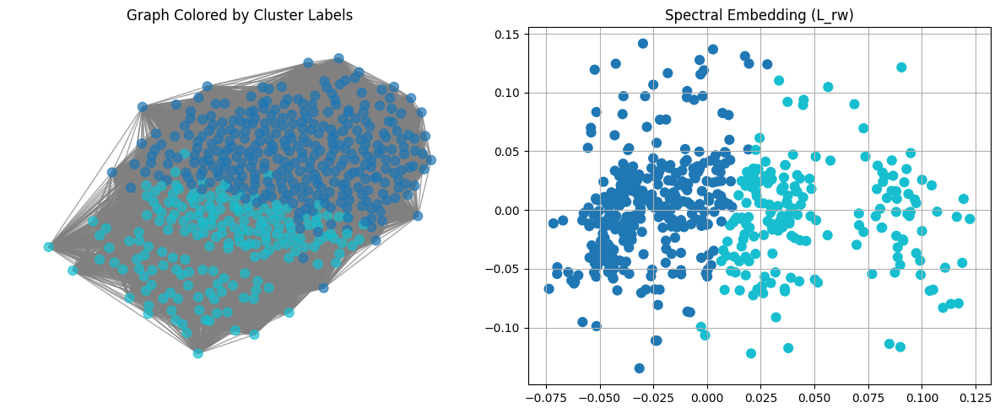

[INFO] Saved outputs for L_rw → C:\Users\LENOVO\Desktop\Spectral_Clustering\outputs\spectral_embedding\correlation__threshold_t0.6\L_rw

=== Processing graph: jaccard_binary__knn_k2 ===
[SPECTRAL EMBEDDING] Laplacian: L
Embedding shape: (500, 2)
Eigenvalues (first 10): [-0. -0.]
Cluster counts: [438  62]


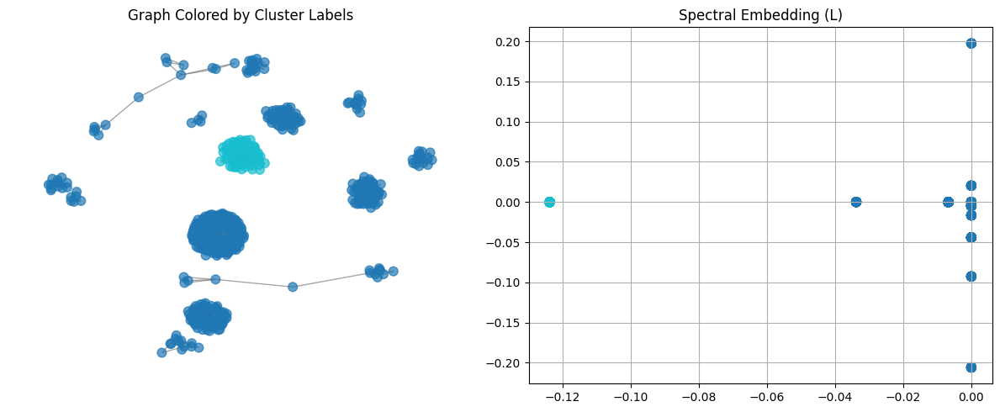

[INFO] Saved outputs for L → C:\Users\LENOVO\Desktop\Spectral_Clustering\outputs\spectral_embedding\jaccard_binary__knn_k2\L
[SPECTRAL EMBEDDING] Laplacian: L_sym
Embedding shape: (500, 2)
Eigenvalues (first 10): [-0. -0.]
Cluster counts: [484  16]


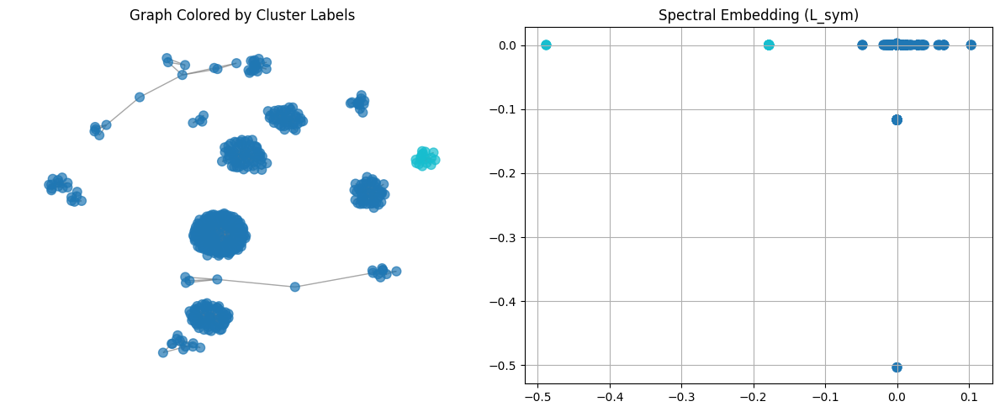

[INFO] Saved outputs for L_sym → C:\Users\LENOVO\Desktop\Spectral_Clustering\outputs\spectral_embedding\jaccard_binary__knn_k2\L_sym
[SPECTRAL EMBEDDING] Laplacian: L_rw
Embedding shape: (500, 2)
Eigenvalues (first 10): [-4.3951 -2.8755]
Cluster counts: [439  61]


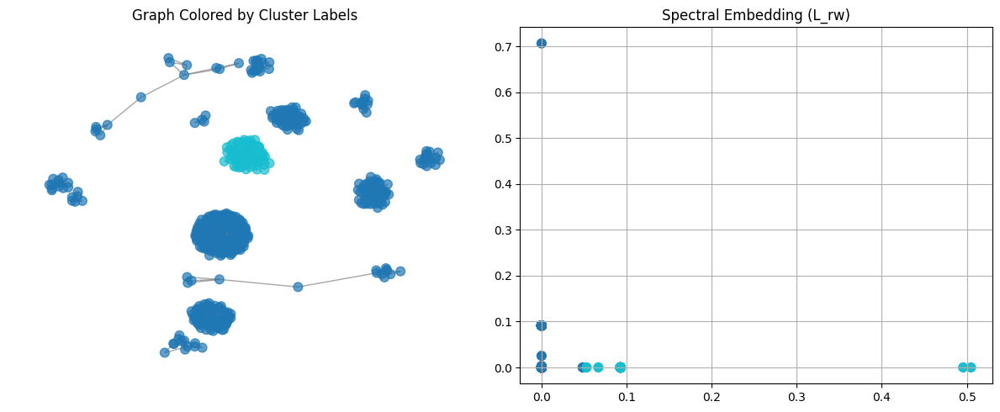

[INFO] Saved outputs for L_rw → C:\Users\LENOVO\Desktop\Spectral_Clustering\outputs\spectral_embedding\jaccard_binary__knn_k2\L_rw

=== Processing graph: jaccard_binary__knn_k4 ===
[SPECTRAL EMBEDDING] Laplacian: L
Embedding shape: (500, 2)
Eigenvalues (first 10): [-0. -0.]
Cluster counts: [488  12]


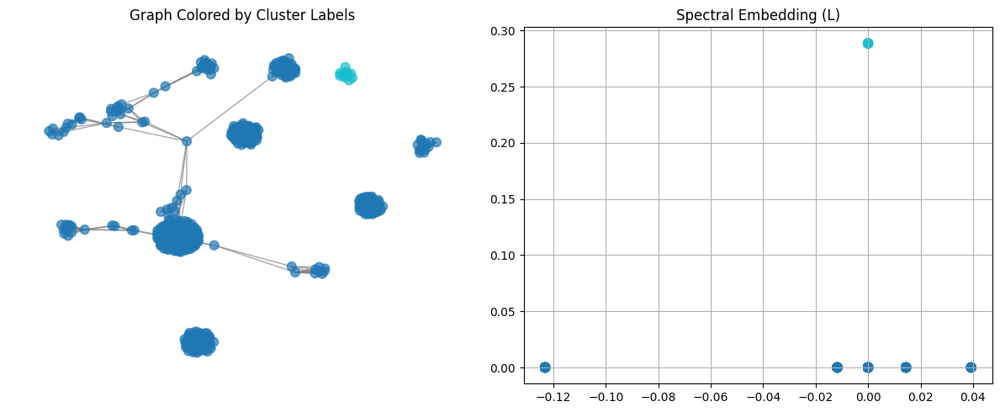

[INFO] Saved outputs for L → C:\Users\LENOVO\Desktop\Spectral_Clustering\outputs\spectral_embedding\jaccard_binary__knn_k4\L
[SPECTRAL EMBEDDING] Laplacian: L_sym
Embedding shape: (500, 2)
Eigenvalues (first 10): [-0.  0.]
Cluster counts: [438  62]


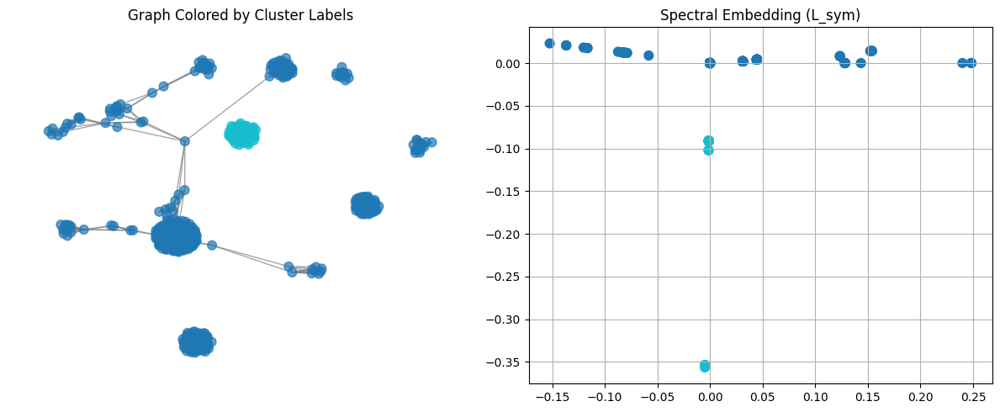

[INFO] Saved outputs for L_sym → C:\Users\LENOVO\Desktop\Spectral_Clustering\outputs\spectral_embedding\jaccard_binary__knn_k4\L_sym
[SPECTRAL EMBEDDING] Laplacian: L_rw
Embedding shape: (500, 2)
Eigenvalues (first 10): [-2.7393 -1.715 ]
Cluster counts: [440  60]


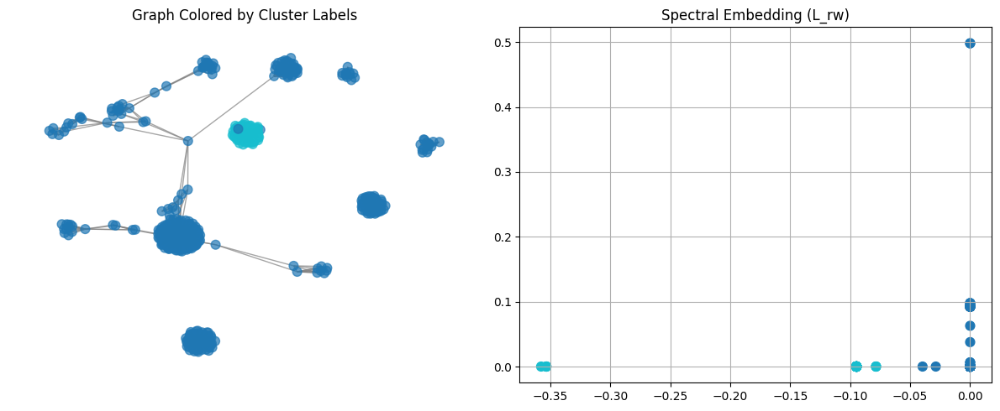

[INFO] Saved outputs for L_rw → C:\Users\LENOVO\Desktop\Spectral_Clustering\outputs\spectral_embedding\jaccard_binary__knn_k4\L_rw

=== Processing graph: jaccard_binary__knn_k6 ===
[SPECTRAL EMBEDDING] Laplacian: L
Embedding shape: (500, 2)
Eigenvalues (first 10): [-0. -0.]
Cluster counts: [436  64]


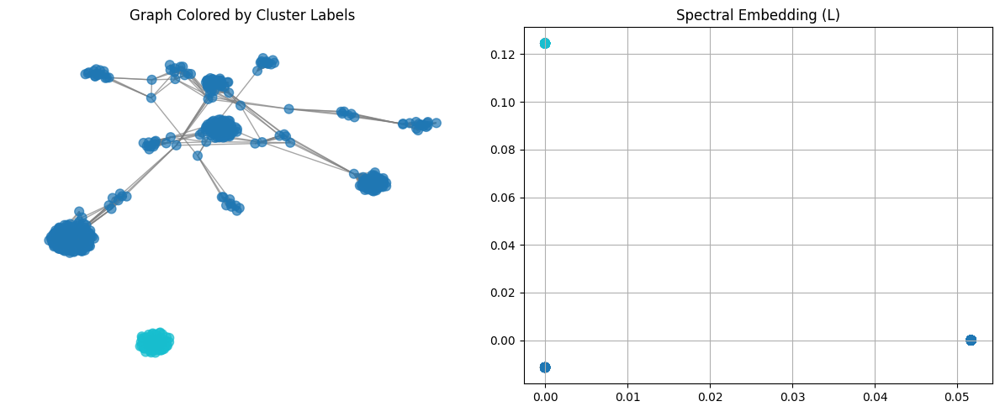

[INFO] Saved outputs for L → C:\Users\LENOVO\Desktop\Spectral_Clustering\outputs\spectral_embedding\jaccard_binary__knn_k6\L
[SPECTRAL EMBEDDING] Laplacian: L_sym
Embedding shape: (500, 2)
Eigenvalues (first 10): [0. 0.]
Cluster counts: [438  62]


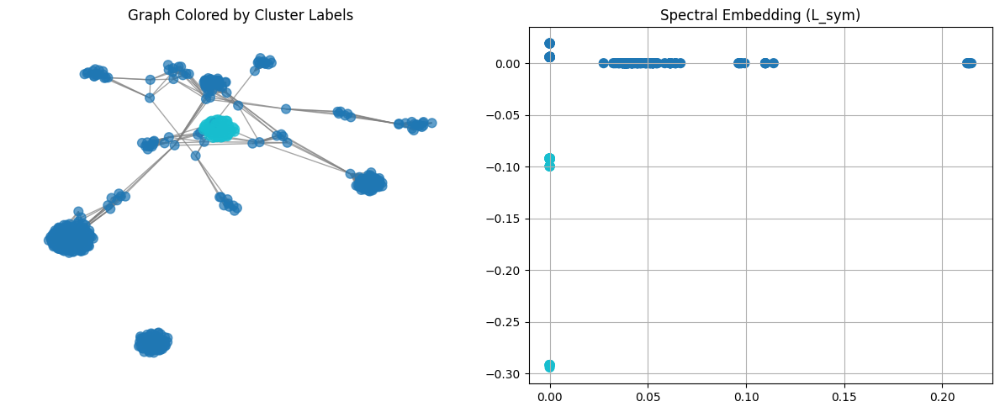

[INFO] Saved outputs for L_sym → C:\Users\LENOVO\Desktop\Spectral_Clustering\outputs\spectral_embedding\jaccard_binary__knn_k6\L_sym
[SPECTRAL EMBEDDING] Laplacian: L_rw
Embedding shape: (500, 2)
Eigenvalues (first 10): [-1.4706 -1.0473]
Cluster counts: [439  61]


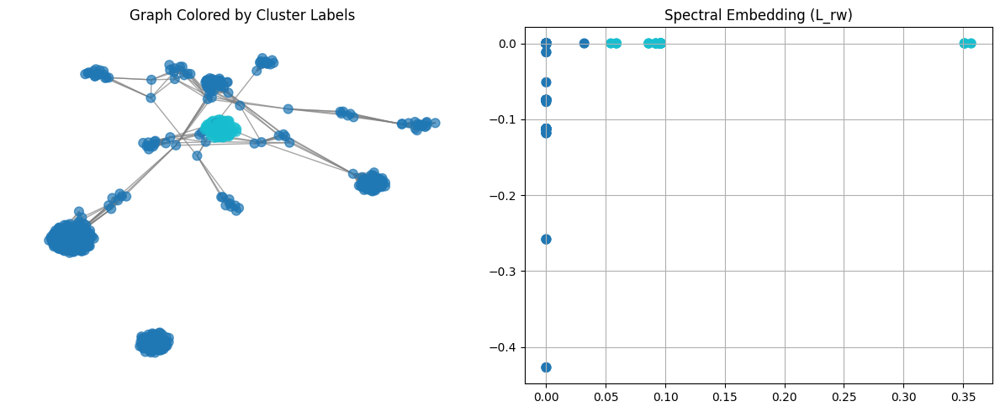

[INFO] Saved outputs for L_rw → C:\Users\LENOVO\Desktop\Spectral_Clustering\outputs\spectral_embedding\jaccard_binary__knn_k6\L_rw

=== Processing graph: jaccard_binary__threshold_t0.2 ===
[SPECTRAL EMBEDDING] Laplacian: L
Embedding shape: (500, 2)
Eigenvalues (first 10): [ 88.6217 159.9422]
Cluster counts: [499   1]


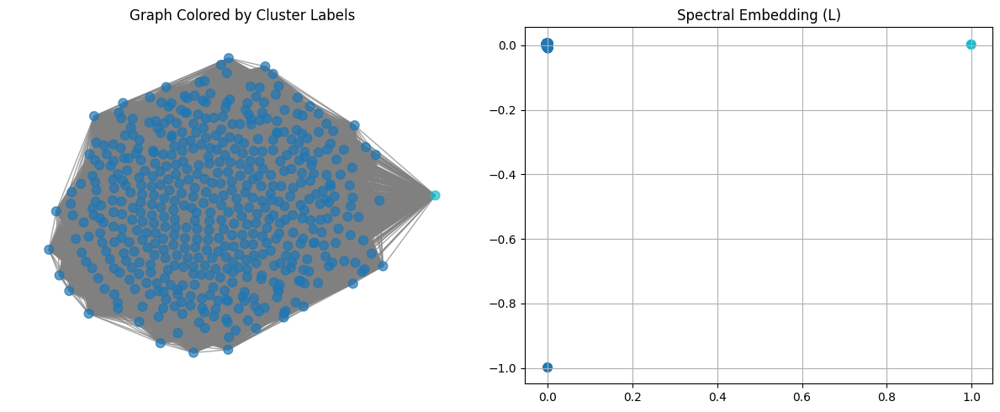

[INFO] Saved outputs for L → C:\Users\LENOVO\Desktop\Spectral_Clustering\outputs\spectral_embedding\jaccard_binary__threshold_t0.2\L
[SPECTRAL EMBEDDING] Laplacian: L_sym
Embedding shape: (500, 2)
Eigenvalues (first 10): [0.8869 0.8946]
Cluster counts: [384 116]


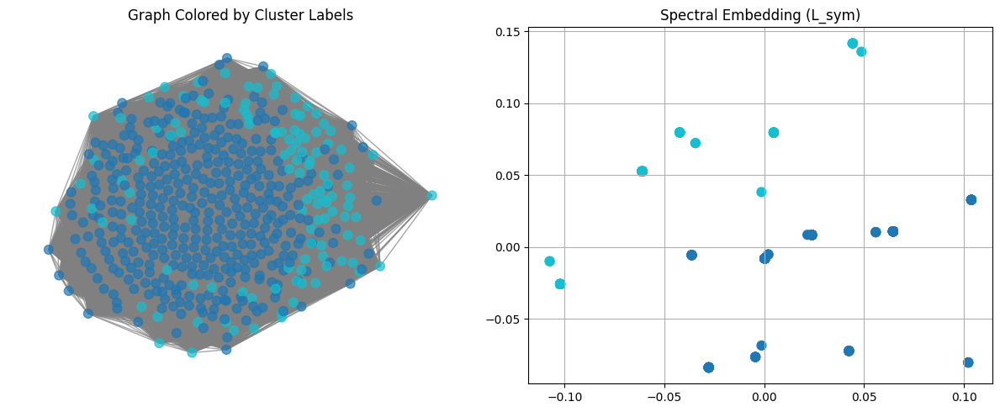

[INFO] Saved outputs for L_sym → C:\Users\LENOVO\Desktop\Spectral_Clustering\outputs\spectral_embedding\jaccard_binary__threshold_t0.2\L_sym
[SPECTRAL EMBEDDING] Laplacian: L_rw
Embedding shape: (500, 2)
Eigenvalues (first 10): [0.8864 0.8925]
Cluster counts: [371 129]


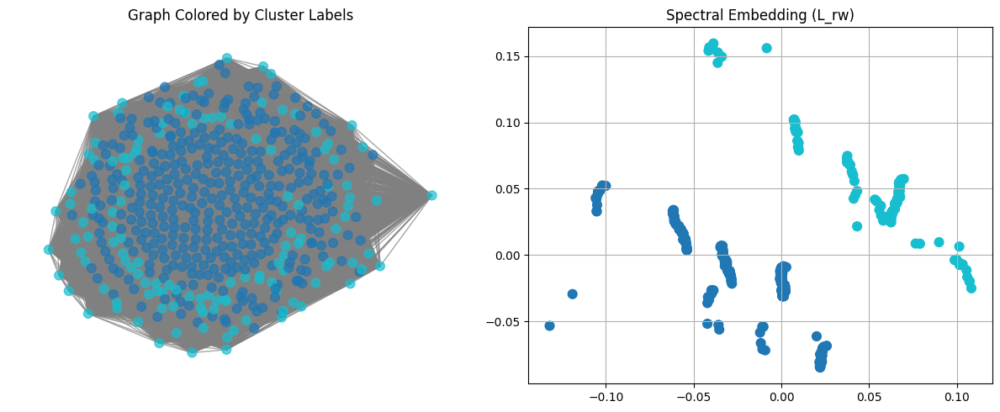

[INFO] Saved outputs for L_rw → C:\Users\LENOVO\Desktop\Spectral_Clustering\outputs\spectral_embedding\jaccard_binary__threshold_t0.2\L_rw

=== Processing graph: jaccard_binary__threshold_t0.4 ===
[SPECTRAL EMBEDDING] Laplacian: L
Embedding shape: (500, 2)
Eigenvalues (first 10): [10.4713 28.9675]
Cluster counts: [499   1]


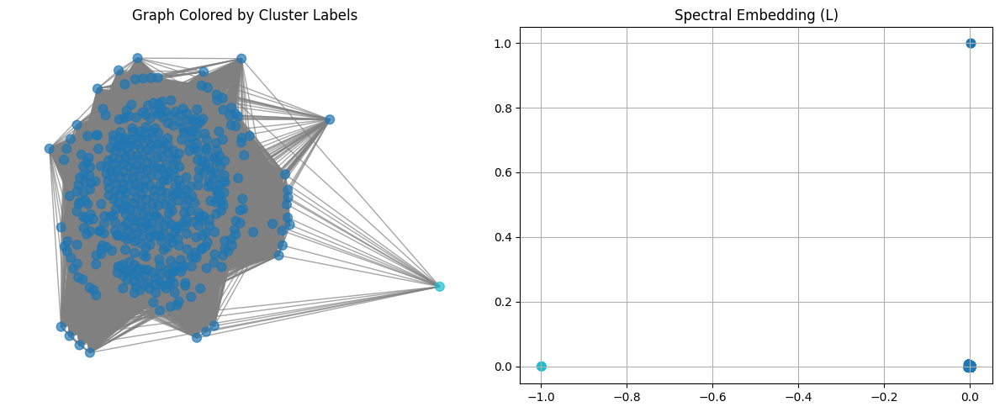

[INFO] Saved outputs for L → C:\Users\LENOVO\Desktop\Spectral_Clustering\outputs\spectral_embedding\jaccard_binary__threshold_t0.4\L
[SPECTRAL EMBEDDING] Laplacian: L_sym
Embedding shape: (500, 2)
Eigenvalues (first 10): [0.8072 0.8163]
Cluster counts: [371 129]


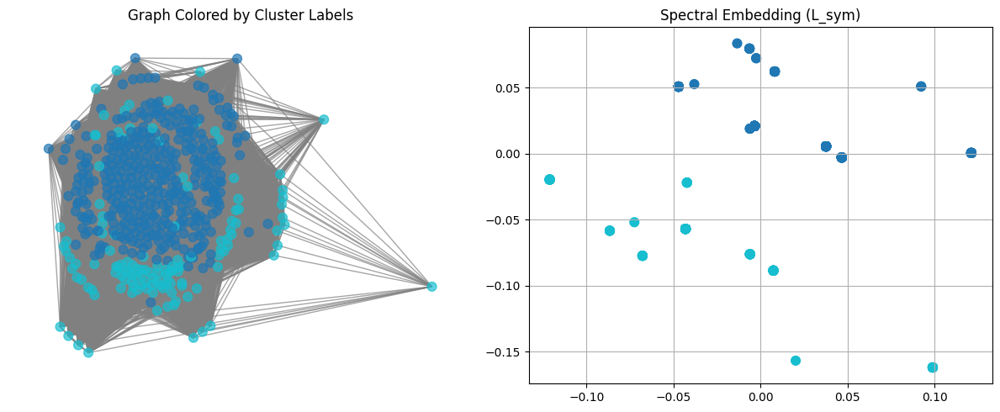

[INFO] Saved outputs for L_sym → C:\Users\LENOVO\Desktop\Spectral_Clustering\outputs\spectral_embedding\jaccard_binary__threshold_t0.4\L_sym
[SPECTRAL EMBEDDING] Laplacian: L_rw
Embedding shape: (500, 2)
Eigenvalues (first 10): [0.771  0.8013]
Cluster counts: [126 374]


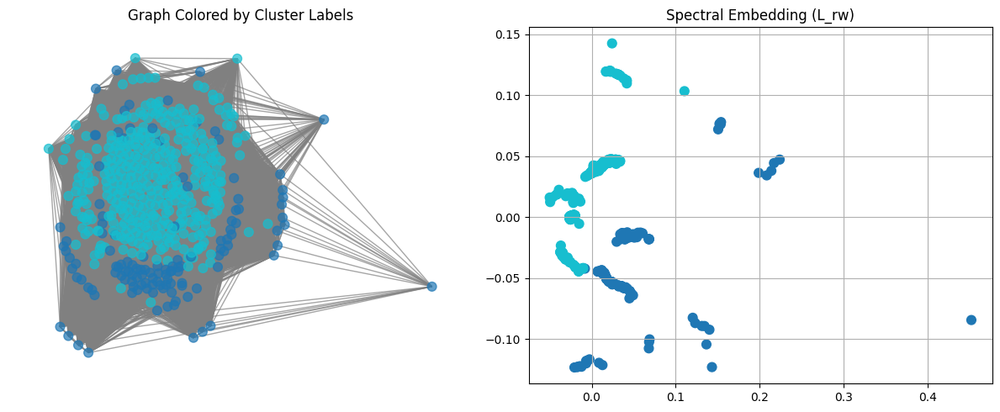

[INFO] Saved outputs for L_rw → C:\Users\LENOVO\Desktop\Spectral_Clustering\outputs\spectral_embedding\jaccard_binary__threshold_t0.4\L_rw

=== Processing graph: jaccard_binary__threshold_t0.6 ===
[SPECTRAL EMBEDDING] Laplacian: L
Embedding shape: (500, 2)
Eigenvalues (first 10): [0.     5.1839]
Cluster counts: [499   1]


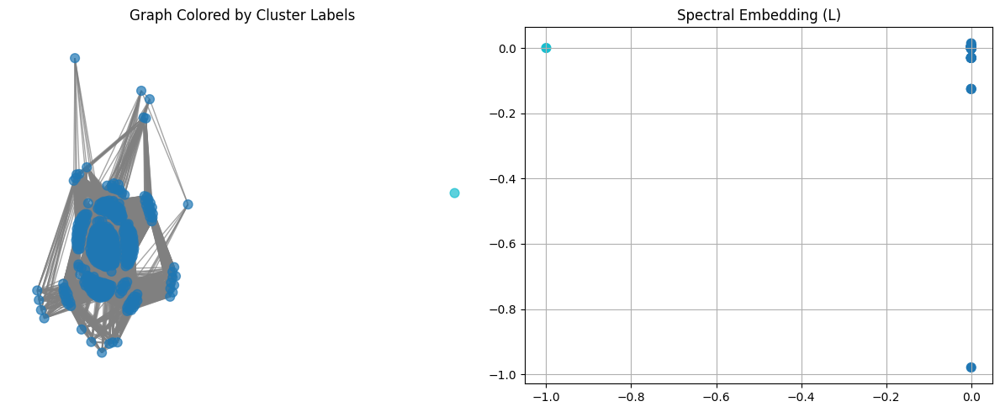

[INFO] Saved outputs for L → C:\Users\LENOVO\Desktop\Spectral_Clustering\outputs\spectral_embedding\jaccard_binary__threshold_t0.6\L
[SPECTRAL EMBEDDING] Laplacian: L_sym
Embedding shape: (500, 2)
Eigenvalues (first 10): [0.5598 0.5797]
Cluster counts: [374 126]


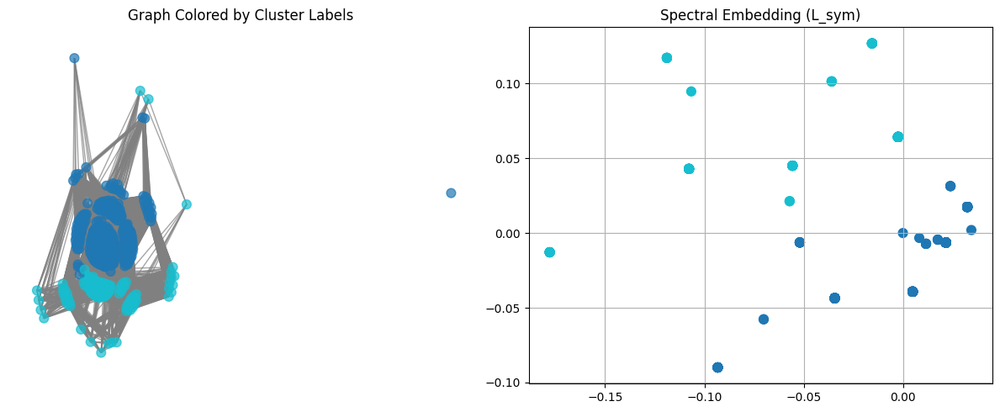

[INFO] Saved outputs for L_sym → C:\Users\LENOVO\Desktop\Spectral_Clustering\outputs\spectral_embedding\jaccard_binary__threshold_t0.6\L_sym
[SPECTRAL EMBEDDING] Laplacian: L_rw
Embedding shape: (500, 2)
Eigenvalues (first 10): [0.4819 0.5243]
Cluster counts: [431  69]


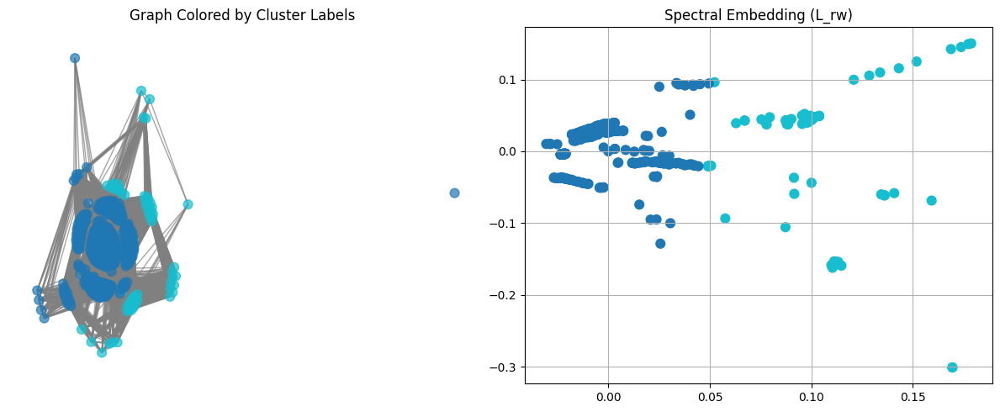

[INFO] Saved outputs for L_rw → C:\Users\LENOVO\Desktop\Spectral_Clustering\outputs\spectral_embedding\jaccard_binary__threshold_t0.6\L_rw


,graph_label,laplacian_type,eigenvalues_1to10,cluster_counts,embedding_shape
0,cosine__knn_k2,L,"[-8.576805133946016e-16, -6.918480567364413e-16]","[496, 4]","(500, 2)"
1,cosine__knn_k2,L_sym,"[-3.370412758669001e-16, 4.5046462841318884e-17]","[456, 44]","(500, 2)"
2,cosine__knn_k2,L_rw,"[-0.2980074954567997, -0.24802525151335464]","[494, 6]","(500, 2)"
3,cosine__knn_k4,L,"[0.018348021306592025, 0.11556481110783959]","[439, 61]","(500, 2)"
4,cosine__knn_k4,L_sym,"[0.003444630851596613, 0.022661164997178292]","[439, 61]","(500, 2)"
5,cosine__knn_k4,L_rw,"[-0.09353211091118518, -0.051498805005098465]","[24, 476]","(500, 2)"
6,cosine__knn_k6,L,"[0.13251160849216712, 0.3583548667479894]","[439, 61]","(500, 2)"
7,cosine__knn_k6,L_sym,"[0.016587493446725665, 0.04805675979420468]","[439, 61]","(500, 2)"
8,cosine__knn_k6,L_rw,"[-0.01879244250602864, 0.00469369035840505]","[442, 58]","(500, 2)"
9,cosine__threshold_t0.2,L,"[357.82184387176665, 371.0867014191665]","[499, 1]","(500, 2)"


In [20]:
import pandas as pd
import numpy as np
from core.spectral import SpectralEmbeddingAnalysis

se = SpectralEmbeddingAnalysis(
    show_info=True,
    show_plots=True,
    k_neighbors=2,
)

explore_results = []
graph_results_dict = {}

for graph_label, graph_data in results.items():
    print(f"\n=== Processing graph: {graph_label} ===")

    L     = graph_data.get("L", None)
    L_sym = graph_data.get("L_sym", None)
    L_rw  = graph_data.get("L_rw", None)

    if L is not None or L_sym is not None or L_rw is not None:
        res = se.run(
            L=L,
            L_sym=L_sym,
            L_rw=L_rw,
            k=2,
            skip_first=True,
            seed=42,
            name=graph_label
        )
    else:
        res = se.run(
            A=graph_data["A"],
            k=2,
            skip_first=True,
            seed=42,
            name=graph_label
        )

    graph_results_dict[graph_label] = {
        "A": graph_data["A"],     
        **res                    
    }

    for lap_name, lap_res in res.items():
        if lap_name in ["S", "A", "D"]:
            continue

        explore_results.append({
            "graph_label": graph_label,
            "laplacian_type": lap_name,
            "eigenvalues_1to10": lap_res["vals"][:10],
            "cluster_counts": list(np.bincount(lap_res["labels"])),
            "embedding_shape": lap_res["U"].shape,
        })

df_explore = pd.DataFrame(explore_results)
pd.set_option("display.max_rows", None)
display(df_explore)

## Spectral Evaluation with Conductance

In [21]:
from core.evaluation import GraphClusteringEvaluator
from utils import utils_spectral as utils

# Initialize evaluator
evaluator = GraphClusteringEvaluator(utils_module=utils)

eval_results = []

for graph_label, res_dict in graph_results_dict.items():
    metrics_dict = evaluator.evaluate_all_laplacians(res_dict, k=2)
    
    for lap_name, metrics in metrics_dict.items():
        eval_results.append({
            "graph_label": graph_label,
            "laplacian_type": lap_name,
            "spectral_gap": metrics.get("spectral_gap", np.nan),
            "silhouette": metrics.get("silhouette", np.nan),
            "modularity": metrics.get("modularity", np.nan),
            "conductance": metrics.get("conductance", np.nan)
        })

df_conductance = pd.DataFrame(eval_results)
pd.set_option("display.max_rows", None)
display(df_conductance)

,graph_label,laplacian_type,spectral_gap,silhouette,modularity,conductance
0,cosine__knn_k2,L,NaN,0.961193,1.423206e-02,0.000000
1,cosine__knn_k2,L_sym,NaN,0.888793,1.530126e-01,0.102235
2,cosine__knn_k2,L_rw,NaN,0.945976,1.694112e-02,0.199786
3,cosine__knn_k4,L,NaN,0.804270,2.093868e-01,0.005753
4,cosine__knn_k4,L_sym,NaN,0.784919,2.093868e-01,0.005753
5,cosine__knn_k4,L_rw,NaN,0.755157,7.356377e-02,0.259879
6,cosine__knn_k6,L,NaN,0.759862,2.049673e-01,0.027573
7,cosine__knn_k6,L_sym,NaN,0.737346,2.049673e-01,0.027573
8,cosine__knn_k6,L_rw,NaN,0.638299,1.948290e-01,0.042976
9,cosine__threshold_t0.2,L,NaN,0.991144,-5.063062e-06,1.000000


## Statistical Analysis with Conductance

In [22]:
from importlib import reload
import core.statistics 
reload(core.statistics)

from core.statistics import GraphClusteringStatistics
# Initialize the statistics class
stats1 = GraphClusteringStatistics(df_conductance)

# Get overall summary
stats1.print_summary()

[INFO] Dropped metric columns with all-NaN values: spectral_gap


silhouette                         modularity               \
                        mean     std     min     max       mean     std  min   
similarity_metric                                                              
correlation           0.6654  0.2563  0.3280  0.9867     0.0957  0.0893 -0.0   
cosine                0.6853  0.2644  0.3375  0.9911     0.0751  0.0902 -0.0   
jaccard_binary        0.7675  0.1595  0.5304  0.9935     0.1081  0.0974 -0.0   

                          conductance                    
                      max        mean     std  min  max  
similarity_metric                                        
correlation        0.2553      0.3820  0.3720  0.0  1.0  
cosine             0.2094      0.4117  0.3758  0.0  1.0  
jaccard_binary     0.2325      0.3379  0.3983  0.0  1.0

silhouette                        modularity          \
                          mean     std    min     max       mean     std   
construction_method                                                        
knn                     0.7994  0.0947  0.621  0.9612     0.1604  0.0829   
threshold               0.6128  0.2869  0.328  0.9935     0.0255  0.0283   

                                    conductance                       
                        min     max        mean     std  min     max  
construction_method                                                   
knn                  0.0086  0.2553      0.0433  0.0640  0.0  0.2599  
threshold           -0.0000  0.0934      0.7111  0.2299  0.0  1.0000

silhouette                          \
                                            mean     std     min     max   
similarity_metric construction_method                                      
correlation       knn                     0.7716  0.1115  0.6210  0.9468   
                  threshold               0.5592  0.3191  0.3280  0.9867   
cosine            knn                     0.8084  0.1052  0.6383  0.9612   
                  threshold               0.5622  0.3215  0.3375  0.9911   
jaccard_binary    knn                     0.8180  0.0656  0.7138  0.9166   
                  threshold               0.7169  0.2098  0.5304  0.9935   

                                      modularity                          \
                                            mean     std     min     max   
similarity_metric construction_method                                      
correlation       knn                     0.1539  0.0907  0.0086  0.2553   
                  threshold               0.0375  0.0328 -0.0000  0.0839   
cosine            knn                     0.1424  0.0841  0.0142  0.2094   
                  threshold               0.0078  0.0058 -0.0000  0.0125   
jaccard_binary    knn                     0.1850  0.0769  0.0404  0.2325   
                  threshold               0.0312  0.0307 -0.0000  0.0934   

                                      conductance                          
                                             mean     std     min     max  
similarity_metric construction_method                                      
correlation       knn                      0.0516  0.0381  0.0000  0.1252  
                  threshold                0.7124  0.2168  0.5322  1.0000  
cosine            knn                      0.0746  0.0944  0.0000  0.2599  
                  threshold                0.7488  0.1885  0.6179  1.0000  
jaccard_binary    knn                      0.0038  0.0062  0.0000  0.0171  
                  threshold                0.6720  0.2932  0.0000  1.0000

silhouette                         modularity                  \
                     mean     std     min     max       mean     std     min   
laplacian_type                                                                 
L                  0.9120  0.1003  0.7419  0.9935     0.0684  0.0967 -0.0000   
L_rw               0.6008  0.2141  0.3294  0.9468     0.0921  0.0857  0.0114   
L_sym              0.6054  0.2097  0.3280  0.8888     0.1184  0.0904  0.0114   

                       conductance                          
                   max        mean     std     min     max  
laplacian_type                                              
L               0.2325      0.4519  0.5048  0.0000  1.0000  
L_rw            0.2221      0.3576  0.2900  0.0083  0.7296  
L_sym           0.2553      0.3221  0.3045  0.0000  0.7221

In [23]:
df_for_conductance = stats1.df.copy()

display(df_for_conductance.tail())

,graph_label,laplacian_type,silhouette,modularity,conductance,similarity_metric,construction_method,param_name,param_value
49,jaccard_binary__threshold_t0.4,L_sym,0.603907,5.035797e-02,0.669873,jaccard_binary,threshold,epsilon,0.4
50,jaccard_binary__threshold_t0.4,L_rw,0.530449,4.894096e-02,0.675420,jaccard_binary,threshold,epsilon,0.4
51,jaccard_binary__threshold_t0.6,L,0.992370,-2.105511e-17,0.000000,jaccard_binary,threshold,epsilon,0.6
52,jaccard_binary__threshold_t0.6,L_sym,0.577464,9.341623e-02,0.552513,jaccard_binary,threshold,epsilon,0.6
53,jaccard_binary__threshold_t0.6,L_rw,0.649592,2.327497e-02,0.729558,jaccard_binary,threshold,epsilon,0.6


In [24]:
manova = GraphClusteringMANOVA(df_for_conductance)
manova.fit()
manova.print_summary()


=== MANOVA MODEL ===
Formula: silhouette + modularity + conductance ~ similarity_metric + construction_method + laplacian_type

=== MULTIVARIATE TEST RESULTS ===
                  Multivariate linear model
                                                              
--------------------------------------------------------------
       Intercept         Value  Num DF  Den DF F Value  Pr > F
--------------------------------------------------------------
          Wilks' lambda  0.0701 3.0000 46.0000 203.3380 0.0000
         Pillai's trace  0.9299 3.0000 46.0000 203.3380 0.0000
 Hotelling-Lawley trace 13.2612 3.0000 46.0000 203.3380 0.0000
    Roy's greatest root 13.2612 3.0000 46.0000 203.3380 0.0000
--------------------------------------------------------------
                                                              
--------------------------------------------------------------
     similarity_metric    Value  Num DF  Den DF F Value Pr > F
-------------------------------------

In [25]:
anova = GraphClusteringANOVA(df_for_conductance)
anova.fit()
anova.print_summary()


=== FOLLOW-UP ANOVA RESULTS ===

--- Metric: SILHOUETTE ---
Model: silhouette ~ similarity_metric + construction_method + laplacian_type
                       sum_sq    df          F        PR(>F)
similarity_metric    0.105354   2.0   2.252217  1.161679e-01
construction_method  0.469995   1.0  20.094721  4.574657e-05
laplacian_type       1.145002   2.0  24.477398  4.700311e-08
Residual             1.122670  48.0        NaN           NaN

--- Metric: MODULARITY ---
Model: modularity ~ similarity_metric + construction_method + laplacian_type
                       sum_sq    df          F        PR(>F)
similarity_metric    0.010027   2.0   1.443177  2.462395e-01
construction_method  0.245895   1.0  70.780612  5.268159e-11
laplacian_type       0.022571   2.0   3.248471  4.751802e-02
Residual             0.166754  48.0        NaN           NaN

--- Metric: CONDUCTANCE ---
Model: conductance ~ similarity_metric + construction_method + laplacian_type
                       sum_sq    df     

In [28]:
metrics = ['conductance']
factors = ['similarity_metric', 'construction_method', 'laplacian_type']

analysis = GraphClusteringAnalysis(df_for_conductance)

# Tukey HSD for all combinations
tukey_results = {}
for metric in metrics:
    for factor in factors:
        tukey_results[(metric, factor)] = analysis.tukey_posthoc(
            metric=metric,
            factor=factor
        )

# Effect sizes for all metrics
effect_sizes = {}
for metric in metrics:
    effect_sizes[metric] = analysis.compute_effect_sizes(metric=metric)


Tukey HSD for metric 'conductance' by factor 'similarity_metric':
      Multiple Comparison of Means - Tukey HSD, FWER=0.05       
   group1       group2     meandiff p-adj   lower  upper  reject
----------------------------------------------------------------
correlation         cosine   0.0297 0.9705 -0.2779 0.3372  False
correlation jaccard_binary  -0.0441  0.936 -0.3517 0.2634  False
     cosine jaccard_binary  -0.0738 0.8317 -0.3814 0.2337  False
----------------------------------------------------------------

Tukey HSD for metric 'conductance' by factor 'construction_method':
Multiple Comparison of Means - Tukey HSD, FWER=0.05 
group1   group2  meandiff p-adj lower  upper  reject
----------------------------------------------------
   knn threshold   0.6677   0.0 0.5756 0.7599   True
----------------------------------------------------

Tukey HSD for metric 'conductance' by factor 'laplacian_type':
Multiple Comparison of Means - Tukey HSD, FWER=0.05
group1 group2 meandiff p-adj

,sum_sq,df,F,PR(>F),eta_sq
similarity_metric,0.049679,2.0,0.939274,3.979775e-01,0.037662
construction_method,6.019101,1.0,227.606714,7.614318e-20,0.825839
laplacian_type,0.161920,2.0,3.061427,5.606000e-02,0.113129
Residual,1.269369,48.0,NaN,NaN,0.500000
